# Assignment 3 - Deep Learning Applications

Class: COMP 5600 - Artificial Intelligence

Author: Chris Hinkson

Email: cmh0201@auburn.edu

## Assignment 3 Part 1 Introduction

Welcome to my solution for Assignment 3. In part 1, two forms of a RNN are implemented - a simple feed-forward "Vanilla" RNN with a many-to-one architecture, and a LSTM version. Both models are designed to take input of a sequence of words that are related to a book's genres (being a description, a title, or a combined description and title) and predict a one-hot encoding of the book's genres.


## Implementation Decisions

Prior to either model, several steps are taken to pre-process the data. First, all of the dataset and other data for encoding and filtering is downloaded from several web-hosted locations.

From there, the data goes through several pre-processing steps:

1. All descriptions and titles are converted to lowercase and tokenized

2. All stop words are removed with [resources provided by NLTK](https://www.nltk.org/)

3. All words are lematized with [NLTK's Lemmatizer](https://www.nltk.org/api/nltk.stem.WordNetLemmatizer.html?highlight=wordnet)

4. All words are encoded with [GloVe word vector encodings](https://nlp.stanford.edu/projects/glove/)

5. All sequences are finally padded to ensure a consistent sequence size.

The data is then fed into each of the models in three scenarios: predicting genres based on descriptions only, predicting genres based on titles only, and predicting genres based on both descriptions and genres. The models are then allowed to train and validate themselves over 20 epochs on the provided training and validation sets, followed by a final testing set to confirm model metrics.

For the **Vanilla RNN Model**, a simple architecure is used to perform forward passes and back propogation. A tanh activation function is used at the hidden layer, and a sigmoid provides probabilities externally. The model reverses the overall process in the back propogation stage to update weights and biases throughout the model. Loss and accuracy are captured throughout the training and validation stages, and precision and recall are also captured on test data. After observing training and validation results, a final training rate of `0.001` was identified to produce the best results for the RNN models.

For the **LSTM Model**, this architecture is expanded to include the LSTM cell states and various gates present in LSTM design. From the research I completed and based my implementation on, these are referred to as the Forget Gate, Input Gate, Output Gate, and C Tilde Gate. A variety of functions are used across these gates, primarily Sigmoid and Tanh functions. Since there are a few different approaches that have been used on LSTM's, I'd like to reference [this article on LSTM's](https://colah.github.io/posts/2015-08-Understanding-LSTMs/) and [this youtube series on LSTM's](https://www.youtube.com/watch?v=9Ug83mcRQhk&list=PLf_idrN5yDOX_y2O3fowt6PmDmzsxpHXg) as being my main sources of inspiration with my implementation. A lot of time was spent reviewing the math behind the various gates and understanding how the different gates affect the output of the LSTM. After observing training and validation results, a final training rate of `0.00035` was identified to produce the best results for LSTM models.

## Performance Analysis

To compare the performance of the two model variations (Vanilla RNN vs LSTM), a variety of metrics were recorded in training, validation, and test stages. While further optimizations may be able to provide better results, the models were kept relatively simple in nature.

### Training and Validation Comparison

To analyze model performance during the training and validation stages, the two main metrics analyzed were loss and accuracy. Graphs show how these change over time for each model on different datasets:

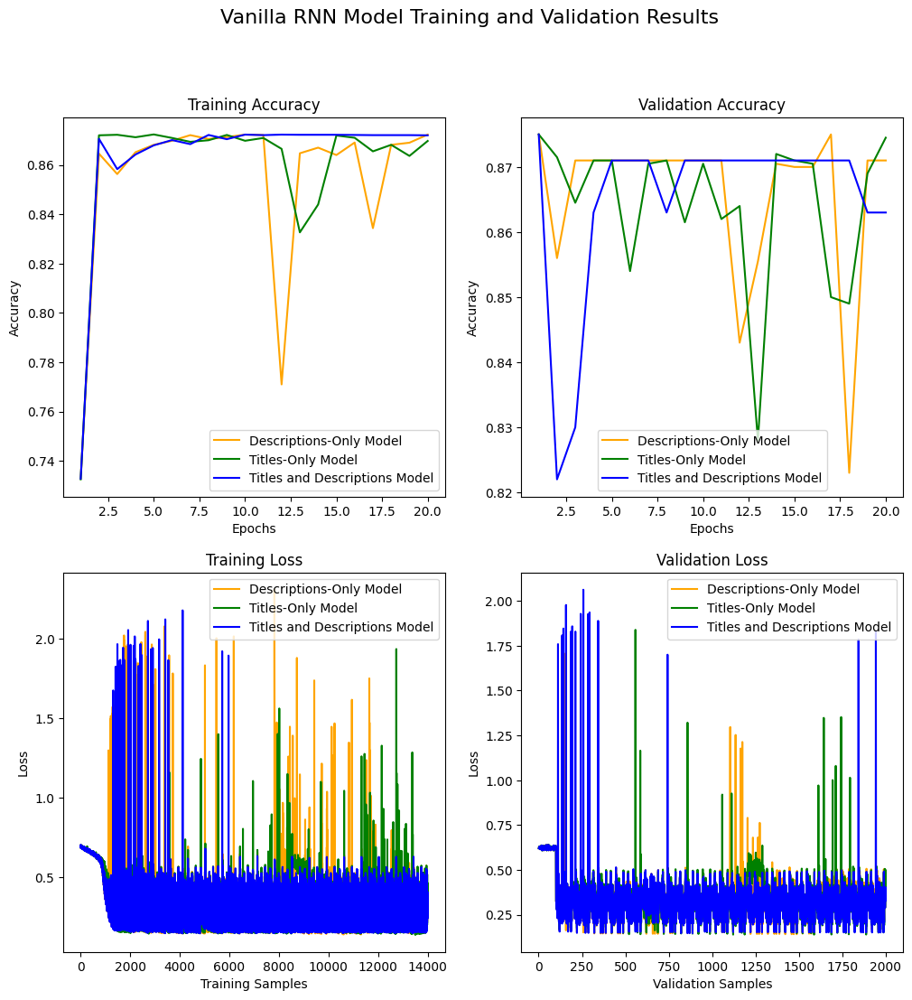

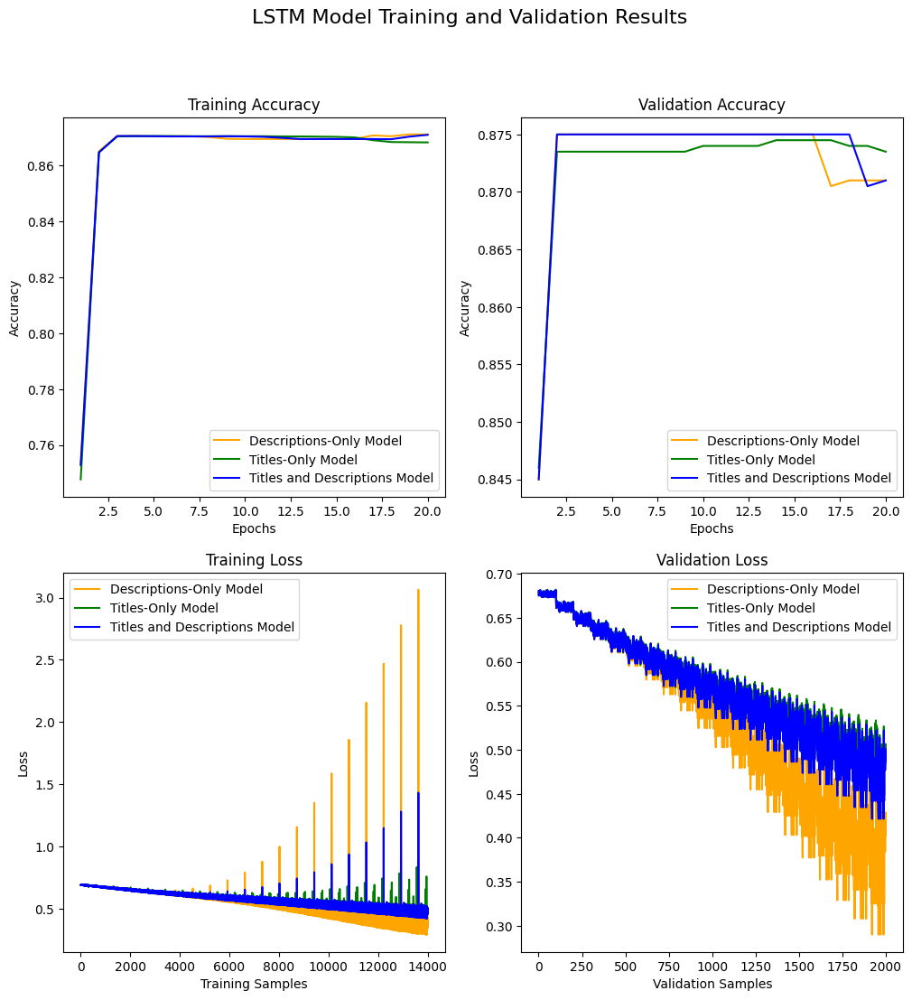

As shown, for all models on all datasets, accuracy rises right rapidly at the beginning of training and then plateaus for the rest of duration. For Vanilla RNN's, loss tends to decrease quick quickly then plateaus, whereas LSTMs have a more constant decrease throughout the lifetime of the model. This leads to a few conclusions regarding the training and validation stages for the models:

- The accuracy always seems to raise fast and plateau. The model rapidly gets better in this regard, but doesn't necesariily improve over time.

- The constant loss in the Vanilla RNN's situation indicates that it may get better at first but stop improving with time. It learns at the start but doesn't continue learning much more for the rest of the training.

- The decreasing loss across training and validation for the LSTM is a bit of a better sign, indicating that the model is still learning and is getting better with time.

### Test Comparison

Test Results for Vanilla RNN Models with LR 0.0001 and 20 Training Epochs:

| RNN Model               |   Test Accuracy |   Test Precision |   Test Recall |
|-------------------------|-----------------|------------------|---------------|
| Description-Only        |         0.88    |         0.53     |      0.215447 |
| Titles-Only             |         0.87775 |         0.512821 |      0.121951 |
| Titles and Descriptions |         0.88    |         0.53     |      0.215447 |


Test Results for LSTM Models with LR 0.00035 and 20 Training Epochs:

| LSTM Model              |   Test Accuracy |   Test Precision |   Test Recall |
|-------------------------|-----------------|------------------|---------------|
| Description-Only        |         0.88    |         0.53     |    0.215447   |
| Titles-Only             |         0.87575 |         0.222222 |    0.00406504 |
| Titles and Descriptions |         0.87975 |         0.527638 |    0.213415   |

Shown by the results here, both models achieve around the same accuracy, precisions, and recalls during the test stages, so theres no clear winner for these metrics. By adjusting the learning rate for the each model, different results can be achieved, but from experimentation it tends to happen at the expense of a singular metric. The Vanilla RNN tends to be more stable, whereas the LSTM tends to have more fluxuation in its results.

- Some test runs on the LSTM were able to achieve better accuracy than the Vanilla RNN, but did this at the cost of having close to no precision or recall. This tended to happen at lower learning rates, such as `0.00025 and 0.0001`

- Going the other way, running the LSTM with a higher learning rate such as `0.01` showed to somewhat increase the precision and recall but made the accuracy and loss even choppier / more unstable.

- For the titles-only dataset, it is clear that the Vanilla RNN performed better in terms of the precision and recall. The LSTM had a significant drop in performance at this learning rate for that dataset, perhaps to it overfitting on a smaller amount of information and being unable to adjust for new information.

- By adjusting the Vanilla RNN learning rate, slight adjustments could be made, but runs at `0.0001` seemed to have the best results for accuracy, precision, and recall overall.

My expectation would be that adjustments to model architecture and incorportation of advanced deep learning techniques could be used to improve these results. For instance, adding optimizations, further training epochs, and clipping to the LSTM model could show improvements that would be expected over the Vanilla RNN. I experimented with some of these but could not produce a stable result that displayed improvements over the Vanilla RNN. Combined with the constant decrease in loss for the LSTM, I would believe that it would be the better model for the data sets. However, I would be cautious on providing an explicit answer due to the primitive nature of the models and the lack of exhaustive testing on different strategies.







In [3]:
### MODULE IMPORTS ###
import os
import gc
import cv2
import copy
import json
import datetime
import tabulate
import numpy as np
import pandas as pd
from warnings import warn
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from IPython.display import Image, display

import kagglehub
from kagglehub import KaggleDatasetAdapter

import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

import tensorflow as tf

from sklearn.preprocessing import MultiLabelBinarizer
from sklearn.utils import shuffle

### DEVELOPER OPTIONS ###
DFLAG_PRINT_PREPROCESSING = False
DFLAG_PRINT_GLOVE = False
DFLAG_PRINT_RNN = False
DFLAG_PRINT_RNN_TRAIN = False
DFLAG_PRINT_RNN_TRAIN_SAMPLES = False
DFLAG_PRINT_RNN_TRAIN_GRADIENTS = False
DFLAG_PRINT_RNN_VALIDATION = False
DFLAG_PRINT_RNN_VALIDATION_SAMPLES = False
DFLAG_PRINT_RNN_TEST = False

DFLAG_PRINT_CNN = True
DFLAG_PRINT_CNN_CONVOLUTION = False
DFLAG_PRINT_CNN_RELU = False
DFLAG_PRINT_CNN_MAXPOOLING = False
DFLAG_PRINT_CNN_TRAIN = True
DFLAG_PRINT_CNN_TRAIN_FLATTEN = False
DFLAG_PRINT_CNN_TRAIN_DROPOUT = False
DFLAG_PRINT_CNN_TRAIN_DENSE = False
DFLAG_PRINT_CNN_TRAIN_BACKPROP = False
DFLAG_PRINT_CNN_PREDICT = True

### PANDAS OPTIONS ###
pd.set_option('display.max_colwidth', None)


/Users/chrishinkson/Programming/COMP5600 - Artificial Intelligence/.venv/lib/python3.13/site-packages/google/protobuf/runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.1 at tensorflow/core/framework/attr_value.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
/Users/chrishinkson/Programming/COMP5600 - Artificial Intelligence/.venv/lib/python3.13/site-packages/google/protobuf/runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exactly one major version older than the runtime version 6.31.1 at tensorflow/core/framework/tensor.proto. Please update the gencode to avoid compatibility violations in the next runtime release.
  warnings.warn(
/Users/chrishinkson/Programming/COMP5600 - Artificial Intelligence/.venv/lib/python3.13/site-packages/google/protobuf/runtime_version.py:98: UserWarning: Protobuf gencode version 5.28.3 is exa

In [4]:
'''
ALERT NOTIFICATIONS

Because some models have extemely long times, I am using a notification system to alert me when the model has finished training
or if a model encounters an error. 
'''

# Load modules and configure for ssl context
import http.client, urllib, ssl
ssl._create_default_https_context = ssl._create_unverified_context

# Load env file
import dotenv
dotenv.load_dotenv()

def SendMobileNotification(title="Default Title", message="Default Message", priority=1, sound="pushover"):
	msgParams = {
		"token": os.getenv('PUSHOVER_TOKEN'),
		"user": os.getenv('PUSHOVER_USERID'),
		"message": f"{message}",
		"title": f"{title}",
		"priority": f"{priority}",
		"sound": f"{sound}"
	}
	if priority == 2:
		msgParams["retry"] = "60"
		msgParams["expire"] = "1800"

	conn = http.client.HTTPSConnection("api.pushover.net:443")
	conn.request("POST", "/1/messages.json",
		urllib.parse.urlencode(msgParams), 
		{ "Content-type": "application/x-www-form-urlencoded" }
	)
	return conn.getresponse()

# Send test notification if desired
DFLAG_SENDTESTNOTIFICATION = True
if DFLAG_SENDTESTNOTIFICATION:
	SendMobileNotification("Test Notification", "This is a test notification from COMP5600 Assignment 3 Jupyter Notebook!")


In [ ]:
### NLTK DOWNLOADS AND CONFIGURATION ###
nltk.download(info_or_id='punkt', download_dir="nltk_data")
nltk.download(info_or_id='punkt_tab', download_dir="nltk_data")
nltk.download(info_or_id='stopwords', download_dir="nltk_data")
nltk.download(info_or_id='wordnet', download_dir="nltk_data")
nltk.data.path.append("nltk_data")
nltkStopWords = set(stopwords.words('english'))

### GLOVE DOWNLOADS AND CONFIGURATION ###
if not os.path.isdir("glove"):
	if DFLAG_PRINT_GLOVE:
		print(f"GloVe directory does not exist. Creating directory and downloading glove data!")
	os.makedirs("glove")
	downloadPath = tf.keras.utils.get_file(
		fname="glove.6B.zip",
		cache_dir="glove/",
		origin="http://nlp.stanford.edu/data/glove.6B.zip",
		extract=True,
	)
	if DFLAG_PRINT_GLOVE:
		print(f"GloVe data downloaded and extracted to {downloadPath}.")
else:
	if DFLAG_PRINT_GLOVE:
		print(f"GloVe directory already exists. Skipping download of GloVe data.")

[nltk_data] Downloading package punkt to nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package punkt_tab to nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package stopwords to nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


[nltk_data] Downloading package wordnet to nltk_data...


862182613/862182613 ━━━━━━━━━━━━━━━━━━━━ 522s 1us/step


In [ ]:
'''
GLOVE ENCODER CLASS

This block will handle encoding tokens using GloVe embeddings.
'''
class GloveEncoder():

	# Class Constructor
	def __init__(self, gloveFilePath):
		# Initialize variables
		self.gloveFilePath = gloveFilePath
		self.gloveDictionary = {}

		# Initial Construction Print
		if DFLAG_PRINT_GLOVE:
			print(f"Loading GloVe embeddings from {gloveFilePath}!")

		# Load GloVe embeddings into a dictionary [Code provided in Assignment 3 Instructions]
		with open(self.gloveFilePath, encoding='utf-8') as gloveFile:
			for line in gloveFile:
				values = line.split()
				word = values[0]
				coefs = np.asarray(values[1:], dtype='float32')
				self.gloveDictionary[word] = coefs

		# Final Print
		if DFLAG_PRINT_GLOVE:
			print(f"Loaded {len(self.gloveDictionary)} GloVe embeddings!")

	def doGloveEncode(self, token):
		if token in self.gloveDictionary:
			# If the token exists in the GloVe dictionary, return its embedding
			return self.gloveDictionary[token]
		else:
			# If the token does not exist, return zero vector (I'm only going to use 100d so hard-coded for now)
			if DFLAG_PRINT_GLOVE:
				print(f"Token '{token}' not found in GloVe dictionary. Returning zero vector.")
			return np.zeros(100, dtype='float32')

GloveEncoder100D = GloveEncoder("glove/datasets/glove_extracted/glove.6B.100d.txt")

In [ ]:
'''
DATA PREPARATION AND PROCESSING

This block will handle the data preparation and processing.
'''

class DataLoader:

	# Class Constructor
	def __init__(self, kaggleDataSetName, kaggleDataFileName, columns, gloveEncoder=None):

		# Initial Construction Print
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Loading KaggleHub DataSet {kaggleDataSetName} with file {kaggleDataFileName} and columns {columns}!")

		# Load given dataset into a pandas df using KaggleHub
		self.df = kagglehub.dataset_load(
			KaggleDatasetAdapter.PANDAS,
			kaggleDataSetName,
			kaggleDataFileName,
			pandas_kwargs={"usecols": columns}
		)
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Dataframe has been loaded with {self.df.shape[0]} samples and {self.df.shape[1]} columns: {self.df.columns.values.tolist()}")

		#############################
		# TITLE DATA PRE-PROCESSING #
		#############################

		# Print initial title sample
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Initial Title Sample: \n{self.df['Title'].head(5)}\n")

		# Lowercase the titles
		self.df['Title_Lowered'] = self.df['Title'].str.lower()
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Lowered Title Sample: \n{self.df['Title_Lowered'].head(5)}\n")

		# Tokenize the titles
		self.df['Title_Tokenized'] = self.df['Title_Lowered'].apply(nltk.word_tokenize)
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Tokenized Title Sample: \n{self.df['Title_Tokenized'].head(5)}\n")

		# Remove stop words from the tokenized titles
		self.df['Title_NoStopWords'] = self.df['Title_Tokenized'].apply(lambda line: [token for token in line if token not in nltkStopWords and token.isalnum()])
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Title without Stop Words Sample: \n{self.df['Title_NoStopWords'].head(5)}\n")

		# Lemmatize the tokens
		self.lemmatizer = WordNetLemmatizer()
		self.df['Title_Lemmatized'] = self.df['Title_NoStopWords'].apply(lambda line: [self.lemmatizer.lemmatize(token) for token in line])
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Lemmatized Title Sample: \n{self.df['Title_Lemmatized'].head(5)}\n")

		# Glove Encoding
		if gloveEncoder is not None:
			self.gloveEncoder = gloveEncoder
		else:
			# If no GloVe encoder is provided, create one
			if DFLAG_PRINT_PREPROCESSING:
				print(f"No GloVe encoder provided. Creating a new instance with 100D!")
			self.gloveEncoder = GloveEncoder("glove/glove.6B.100d.txt")
		self.df['Title_GloveEncoded'] = self.df['Title_Lemmatized'].apply(lambda line: [self.gloveEncoder.doGloveEncode(token) for token in line])
		if DFLAG_PRINT_PREPROCESSING:
			print(f"GloVe Encoded Title Sample: \n{self.df['Title_GloveEncoded'].head(5)}\n")

			# Get some statistics pre-padding
			gloveEncodedLength = self.df['Title_GloveEncoded'].apply(lambda line: len(line))
			maxLength = gloveEncodedLength.max()
			minLength = gloveEncodedLength.min()

			gloveIsLessThanMax = gloveEncodedLength.apply(lambda val: 1 if val < maxLength else 0)
			numLessThanMax = gloveIsLessThanMax.sum()

			print(f"GloVe Encoded Title Statistics:")
			print(f" - Max Sequence Length: {maxLength}")
			print(f" - Min Sequence Length: {minLength}")
			print(f" - Number of Titles Less Than Max Sequence Length: {numLessThanMax}\n")

		# Pad Sequences
		self.df['Title_GloveEncodedLists'] = self.df['Title_GloveEncoded'].apply(lambda line: [array.tolist() for array in line])
		self.df['Title_Padded'] = tf.keras.preprocessing.sequence.pad_sequences(self.df['Title_GloveEncodedLists'], padding='post', dtype='float32').tolist()
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Padded Title Sample: \n{self.df['Title_Padded'].head(5)}\n")

			# Get some statistics post-padding
			paddedLength = self.df['Title_Padded'].apply(lambda line: len(line))
			maxLength = paddedLength.max()
			minLength = paddedLength.min()

			paddedIsLessThanMax = paddedLength.apply(lambda val: 1 if val < maxLength else 0)
			numLessThanMax = paddedIsLessThanMax.sum()

			print(f"Padded Title Statistics:")
			print(f" - Max Sequence Length: {maxLength}")
			print(f" - Min Sequence Length: {minLength}")
			print(f" - Number of Titles Less Than Max Sequence Length: {numLessThanMax}\n")

		###################################
		# DESCRIPTION DATA PRE-PROCESSING #
		###################################

		# Print initial description sample
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Initial Description Sample: \n{self.df['Description'].head(5)}\n")

		# Lowercase the descriptions
		self.df['Description_Lowered'] = self.df['Description'].str.lower()
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Lowered Description Sample: \n{self.df['Description_Lowered'].head(5)}\n")

		# Tokenize the descriptions
		self.df['Description_Tokenized'] = self.df['Description_Lowered'].apply(nltk.word_tokenize)
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Tokenized Description Sample: \n{self.df['Description_Tokenized'].head(5)}\n")

		# Remove stop words from the tokenized descriptions
		self.df['Description_NoStopWords'] = self.df['Description_Tokenized'].apply(lambda line: [token for token in line if token not in nltkStopWords and token.isalnum()])
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Description without Stop Words Sample: \n{self.df['Description_NoStopWords'].head(5)}\n")

		# Lemmatize the tokens
		self.lemmatizer = WordNetLemmatizer()
		self.df['Description_Lemmatized'] = self.df['Description_NoStopWords'].apply(lambda line: [self.lemmatizer.lemmatize(token) for token in line])
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Lemmatized Description Sample: \n{self.df['Description_Lemmatized'].head(5)}\n")

		# Glove Encoding
		if gloveEncoder is not None:
			self.gloveEncoder = gloveEncoder
		else:
			# If no GloVe encoder is provided, create one
			if DFLAG_PRINT_PREPROCESSING:
				print(f"No GloVe encoder provided. Creating a new instance with 100D!")
			self.gloveEncoder = GloveEncoder("glove/glove.6B.100d.txt")
		self.df['Description_GloveEncoded'] = self.df['Description_Lemmatized'].apply(lambda line: [self.gloveEncoder.doGloveEncode(token) for token in line])
		if DFLAG_PRINT_PREPROCESSING:
			print(f"GloVe Encoded Description Sample: \n{self.df['Description_GloveEncoded'].head(5)}\n")

			# Get some statistics pre-padding
			gloveEncodedLength = self.df['Description_GloveEncoded'].apply(lambda line: len(line))
			maxLength = gloveEncodedLength.max()
			minLength = gloveEncodedLength.min()

			gloveIsLessThanMax = gloveEncodedLength.apply(lambda val: 1 if val < maxLength else 0)
			numLessThanMax = gloveIsLessThanMax.sum()

			print(f"GloVe Encoded Description Statistics:")
			print(f" - Max Sequence Length: {maxLength}")
			print(f" - Min Sequence Length: {minLength}")
			print(f" - Number of Descriptions Less Than Max Sequence Length: {numLessThanMax}\n")

		# Pad Sequences
		self.df['Description_GloveEncodedLists'] = self.df['Description_GloveEncoded'].apply(lambda line: [array.tolist() for array in line])
		self.df['Description_Padded'] = tf.keras.preprocessing.sequence.pad_sequences(self.df['Description_GloveEncodedLists'], padding='post', dtype='float32').tolist()
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Padded Description Sample: \n{self.df['Description_Padded'].head(5)}\n")

			# Get some statistics post-padding
			paddedLength = self.df['Description_Padded'].apply(lambda line: len(line))
			maxLength = paddedLength.max()
			minLength = paddedLength.min()

			paddedIsLessThanMax = paddedLength.apply(lambda val: 1 if val < maxLength else 0)
			numLessThanMax = paddedIsLessThanMax.sum()

			print(f"Padded Description Statistics:")
			print(f" - Max Sequence Length: {maxLength}")
			print(f" - Min Sequence Length: {minLength}")
			print(f" - Number of Descriptions Less Than Max Sequence Length: {numLessThanMax}\n")

		####################################################
		# TITLE AND DESCRIPTION COMBINATION PRE-PROCESSING #
		####################################################

		# Combine the title and description padded sequences into a single padded sequence
		self.df['Title_And_Description_Padded'] = self.df.apply(lambda row: row['Title_Padded'] + row['Description_Padded'], axis=1)
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Combined Title and Description Sample: \n{self.df['Title_And_Description_Padded'].head(5)}\n")

			# Get some statistics on the combined padded sequences
			combinedLength = self.df['Title_And_Description_Padded'].apply(lambda line: len(line))
			maxLength = combinedLength.max()
			minLength = combinedLength.min()

			combinedIsLessThanMax = combinedLength.apply(lambda val: 1 if val < maxLength else 0)
			numLessThanMax = combinedIsLessThanMax.sum()

			print(f"Combined Padded Sequence Statistics:")
			print(f" - Max Sequence Length: {maxLength}")
			print(f" - Min Sequence Length: {minLength}")
			print(f" - Number of Combined Sequences Less Than Max Sequence Length: {numLessThanMax}\n")

		#############################
		# GENRE DATA PRE-PROCESSING #
		#############################

		# Print initial genre sample
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Initial Genre Sample: \n{self.df['Genre'].head(5)}\n")

		# Split genres for each sample
		self.df['Genre_Split'] = self.df['Genre'].apply(lambda x: x.split(','))
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Genre Split Sample: \n{self.df['Genre_Split'].head(5)}\n")

		# Use MultiLabelBinarizer to encode genres
		self.mlb = MultiLabelBinarizer()
		self.genresEncodedDataFrame = pd.DataFrame(data=self.mlb.fit_transform(self.df['Genre_Split']), columns=self.mlb.classes_)
		if DFLAG_PRINT_PREPROCESSING:
			print(f"Encoded Genres Sample: \n{self.genresEncodedDataFrame.head(5)}\n")

		######################
		# DATAFRAMES CLEANUP #
		######################

		# Remove unneeded title columns
		self.df['Title'] = self.df['Title_Padded']
		self.df.drop(['Title_Lowered', 'Title_Tokenized', 'Title_NoStopWords', 'Title_Lemmatized', 'Title_GloveEncoded', 'Title_GloveEncodedLists', 'Title_Padded'], axis=1, inplace=True)

		# Remove unneeded description columns
		self.df['Description'] = self.df['Description_Padded']
		self.df.drop(['Description_Lowered', 'Description_Tokenized', 'Description_NoStopWords', 'Description_Lemmatized', 'Description_GloveEncoded', 'Description_GloveEncodedLists', 'Description_Padded'], axis=1, inplace=True)

		# Rename combined column
		self.df['Title_And_Description'] = self.df['Title_And_Description_Padded']
		self.df.drop(['Title_And_Description_Padded'], axis=1, inplace=True)

		# Remove genre columns and concatenate with encoded genres
		self.df.drop(['Genre', 'Genre_Split'], axis=1, inplace=True)
		self.df = pd.concat([self.df, self.genresEncodedDataFrame], axis=1)

		# Make different dataframes
		self.df_titlesOnly = self.df[['Title']]
		self.df_descriptionsOnly = self.df[['Description']]
		self.df_titlesAndDescriptions = self.df[['Title_And_Description']]

		if DFLAG_PRINT_PREPROCESSING:
			print(f"Processed Data Sample: \n{self.df.head(5)}\n")
			print(f"Processed Titles-Only Data Sample: \n{self.df_titlesOnly.head(5)}\n")
			print(f"Processed Descriptions-Only Data Sample: \n{self.df_descriptionsOnly.head(5)}\n")
			print(f"Processed Titles and Descriptions Data Sample: \n{self.df_titlesAndDescriptions.head(5)}\n")

		# Separate dataframes into training (700), validation (100), and test (200) sets
		self.df_titlesOnly_train = self.df_titlesOnly.iloc[:700]
		self.df_titlesOnly_validation = self.df_titlesOnly.iloc[700:800]
		self.df_titlesOnly_test = self.df_titlesOnly.iloc[800:]

		self.df_descriptionsOnly_train = self.df_descriptionsOnly.iloc[:700]
		self.df_descriptionsOnly_validation = self.df_descriptionsOnly.iloc[700:800]
		self.df_descriptionsOnly_test = self.df_descriptionsOnly.iloc[800:]

		self.df_titlesAndDescriptions_train = self.df_titlesAndDescriptions.iloc[:700]
		self.df_titlesAndDescriptions_validation = self.df_titlesAndDescriptions.iloc[700:800]
		self.df_titlesAndDescriptions_test = self.df_titlesAndDescriptions.iloc[800:]

		self.df_genres_train = self.genresEncodedDataFrame.iloc[:700]
		self.df_genres_validation = self.genresEncodedDataFrame.iloc[700:800]
		self.df_genres_test = self.genresEncodedDataFrame.iloc[800:]

		if DFLAG_PRINT_PREPROCESSING:
			print(f"The processed data has been split into training, validation, and test sets:")
			print(f" - Titles-Only Data split into Training ({self.df_titlesOnly_train.shape[0]}), Validation ({self.df_titlesOnly_validation.shape[0]}), and Test ({self.df_titlesOnly_test.shape[0]}) sets.")
			print(f" - Descriptions-Only Data split into Training ({self.df_descriptionsOnly_train.shape[0]}), Validation ({self.df_descriptionsOnly_validation.shape[0]}), and Test ({self.df_descriptionsOnly_test.shape[0]}) sets.")
			print(f" - Titles and Descriptions Data split into Training ({self.df_titlesAndDescriptions_train.shape[0]}), Validation ({self.df_titlesAndDescriptions_validation.shape[0]}), and Test ({self.df_titlesAndDescriptions_test.shape[0]}) sets.")
			print(f" - Genres Data split into Training ({self.df_genres_train.shape[0]}), Validation ({self.df_genres_validation.shape[0]}), and Test ({self.df_genres_test.shape[0]}) sets.")

RnnDataLoader = DataLoader("PromptCloudHQ/imdb-data", "IMDB-Movie-Data.csv", ["Title", "Genre", "Description"], GloveEncoder100D)


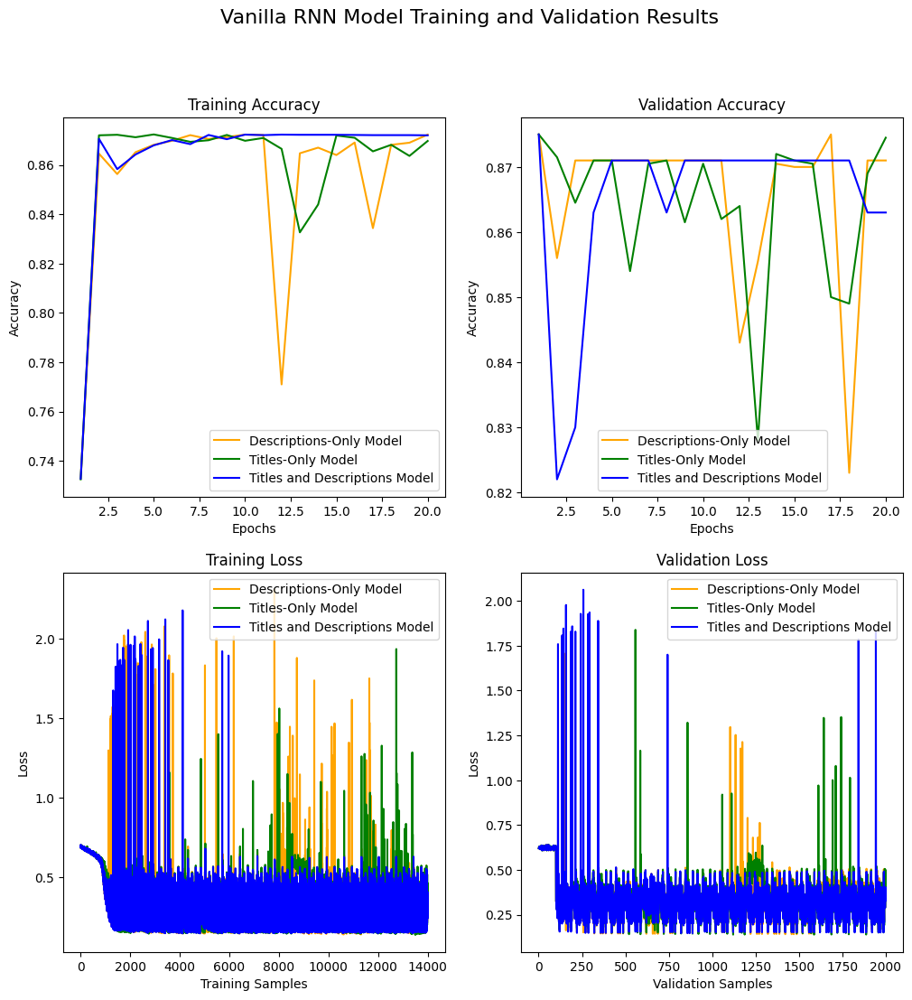

!!! Test Results for Vanilla RNN Models with LR 0.0001 and 20 Training Epochs !!!
| RNN Model               |   Test Accuracy |   Test Precision |   Test Recall |
|-------------------------|-----------------|------------------|---------------|
| Description-Only        |         0.88    |         0.53     |      0.215447 |
| Titles-Only             |         0.87775 |         0.512821 |      0.121951 |
| Titles and Descriptions |         0.88    |         0.53     |      0.215447 |



In [ ]:
'''
VANILLA RECURRENT NEURAL NETWORK CLASS

This block will handle creating the RNN model for use with processed data.
'''

class RNNModel:

	# Class Constructor
	def __init__(self, trainingDataSet, trainingTargetSet, validationDataSet, validationTargetSet, learningRate=0.0001, numberEpochs=20):
		##############################
		# INITIALIZE CLASS VARIABLES #
		##############################
		self.trainingDataSet = trainingDataSet
		self.trainingTargetSet = trainingTargetSet
		self.validationDataSet = validationDataSet
		self.validationTargetSet = validationTargetSet
		self.learningRate = learningRate
		self.numberEpochs = numberEpochs
		self.trainingLosses = []
		self.trainingAccuracies = []
		self.validationLosses = []
		self.validationAccuracies = []

		##############################
		# INITIALIZE WEIGHT MATRICES #
		##############################

		# Get random generator from numpy
		randomGenerator = np.random.default_rng(seed=2002)

		# Initialize random weight matrices for input, hidden, and output layers
		self.inputWeights = randomGenerator.random((100, 100)) / 5 - .1 #100 features in
		self.hiddenWeights = randomGenerator.random((100, 100)) / 5 - .1
		self.outputWeights = randomGenerator.random((100, 20)) / 5 - .1 # 20 genres out

		# Initialize bias matrixes for hidden and output layers
		self.hiddenBias = randomGenerator.random(100) / 5 - .1
		self.outputBias = randomGenerator.random(20) / 5 - .1

		# Print initial weight matrices
		if DFLAG_PRINT_RNN:
			print(f"Initial Input Weights: \n{self.inputWeights}\n")
			print(f"Initial Hidden Weights: \n{self.hiddenWeights}\n")
			print(f"Initial Output Weights: \n{self.outputWeights}\n")

		############################
		# TRAIN AND VALIDATE MODEL #
		############################
		for epoch in range(self.numberEpochs):
			if DFLAG_PRINT_RNN:
				print(f"===========================")
				print(f"Beginning epoch {epoch + 1} of {self.numberEpochs}!")
				print(f"===========================")

			# Train model with training data set
			predictedTargetsBinary, predictedTargetsSigmoid = self.__learnBatch(self.trainingDataSet, self.trainingTargetSet, f"Train-{epoch}")

			# Print actual and predicted targets if enabled
			if DFLAG_PRINT_RNN:
				print(f"Actual Training Targets: \n{self.trainingTargetSet.to_numpy()}\n")
				print(f"Predicted Training Targets (Binary): \n{predictedTargetsBinary}\n")
				print(f"Predicted Training Targets (Sigmoid): \n{predictedTargetsSigmoid}\n")

			# Calculate training loss and accuracy
			actualTargets = self.trainingTargetSet.to_numpy()
			self.trainingLosses.extend(self.__evaluateLosses(actualTargets, predictedTargetsSigmoid))
			self.trainingAccuracies.append(self.__evaluateAccuracy(actualTargets, predictedTargetsBinary))

			# Validate model with validation data set
			predictedTargetsBinary, predictedTargetsSigmoid = self.__predictBatch(self.validationDataSet, f"Validation-{epoch}")

			# Print actual and predicted targets if enabled
			if DFLAG_PRINT_RNN:
				print(f"Actual Validation Targets: \n{actualTargets}\n")
				print(f"Predicted Validation Targets (Binary): \n{predictedTargetsBinary}\n")
				print(f"Predicted Validation Targets (Sigmoid): \n{predictedTargetsSigmoid}\n")

			# Calculate validation loss and accuracy
			actualTargets = self.validationTargetSet.to_numpy()
			self.validationLosses.extend(self.__evaluateLosses(actualTargets, predictedTargetsSigmoid))
			self.validationAccuracies.append(self.__evaluateAccuracy(actualTargets, predictedTargetsBinary))

		# Print final losses and accuracies
		if DFLAG_PRINT_RNN:
			print(f"===========================")
			print(f"Final Training Losses: \n{self.trainingLosses}\n")
			print(f"Final Training Accuracies: \n{self.trainingAccuracies}\n")
			print(f"Final Validation Losses: \n{self.validationLosses}\n")
			print(f"Final Validation Accuracies: \n{self.validationAccuracies}\n")
			print(f"===========================")


	def testModel(self, testDataSet, testTargetSet):
		# Validate model with test data set
		actualTargets = testTargetSet.to_numpy()
		predictedTargetsBinary, predictedTargetsSigmoid = self.__predictBatch(testDataSet, "Test")

		# Print actual and predicted targets if enabled
		if DFLAG_PRINT_RNN_TEST:
			print(f"Actual Test Targets: \n{actualTargets}\n")
			print(f"Predicted Targets Binary: \n{predictedTargetsBinary}\n")
			print(f"Predicted Targets Sigmoid: \n{predictedTargetsSigmoid}\n")

		# Calculate test accuracy
		testAccuracy = self.__evaluateAccuracy(actualTargets, predictedTargetsBinary)
		if DFLAG_PRINT_RNN_TEST:
			print(f"Test Accuracy: {testAccuracy:.2f}")

		# Calculate test precision
		testPrecision = self.__evaluatePrecision(actualTargets, predictedTargetsBinary)
		if DFLAG_PRINT_RNN_TEST:
			print(f"Test Precision: {testPrecision:.2f}")

		# Calculate test recall
		testRecall = self.__evaluateRecall(actualTargets, predictedTargetsBinary)
		if DFLAG_PRINT_RNN_TEST:
			print(f"Test Recall: {testRecall:.2f}")

		return testAccuracy, testPrecision, testRecall

	def __learnBatch(self, dataBatch, targetBatch, batchIdentifier=None):
		predictedTargetsBinary = []
		predictedTargetsSigmoid = []
		for i in range (len(dataBatch)):
			# Get current data sequence
			currentDataSeries = dataBatch.iloc[i]
			currentDataSequence = currentDataSeries.iloc[0]

			# Get current target sequence
			currentTargetSeries = targetBatch.iloc[i]
			currentTargetSequence = currentTargetSeries.to_numpy().astype(np.float32)

			# Train the model with the current sequence
			outputBinary, outputSigmoid = self.__learnSequence(currentDataSequence, currentTargetSequence, f"{batchIdentifier}-{i}")
			predictedTargetsBinary.append(outputBinary)
			predictedTargetsSigmoid.append(outputSigmoid)
		return np.array(predictedTargetsBinary), np.array(predictedTargetsSigmoid)

	def __predictBatch(self, dataBatch, batchIdentifier=None):
		predictedTargetsBinary = []
		predictedTargetsSigmoid = []
		for i in range (len(dataBatch)):
			# Get current data sequence
			currentDataSeries = dataBatch.iloc[i]
			currentDataSequence = currentDataSeries.iloc[0]

			# Validate the model with the current sequence
			outputBinary, outputSigmoid = self.__predictSequence(currentDataSequence, f"{batchIdentifier}-{i}")
			predictedTargetsBinary.append(outputBinary)
			predictedTargetsSigmoid.append(outputSigmoid)
		return np.array(predictedTargetsBinary), np.array(predictedTargetsSigmoid)

	def __learnSequence(self, currentSequence, targetSequence, sequenceIdentifier=None):
		if DFLAG_PRINT_RNN_TRAIN:
			if sequenceIdentifier is not None:
				print(f"Beginning learning for sequence {sequenceIdentifier} with length {len(currentSequence)}!")
			else:
				print(f"Beginning learning for new sequence with length {len(currentSequence)}!")

		# Initialize lists for holding states
		outputArraysRaw = []
		outputArraysSigmoid = []
		outputArraysBinary = []
		hiddenArrays = []

		# Initialize gradients for each parameter
		lossGradients = [0] * len(currentSequence)
		inputWeights_Gradient = np.zeros_like(self.inputWeights)
		hiddenWeights_Gradient = np.zeros_like(self.hiddenWeights)
		outputWeights_Gradient = np.zeros_like(self.outputWeights)
		hiddenBias_Gradient = np.zeros_like(self.hiddenBias)
		outputBias_Gradient = np.zeros_like(self.outputBias)

		#################
		# FORWARD PASS  #
		#################
		previousHiddenState = None
		for i in range(len(currentSequence)):
			# Get the current word
			currentWord_Input = currentSequence[i]
			if DFLAG_PRINT_RNN_TRAIN_SAMPLES:
				print(f"Current Sample {i}: \n{currentWord_Input}\n")

			# Calculate matrix multiplication of the current word and input weights
			currentWord_WeightedInput = np.matmul(currentWord_Input, self.inputWeights)

			# If this is first word, initialize hidden state, else calculate the current hidden state using previous hidden state
			if previousHiddenState is None:
				currentWord_Hidden = currentWord_WeightedInput
			else:
				currentWord_Hidden = currentWord_WeightedInput + np.matmul(previousHiddenState, self.hiddenWeights) + self.hiddenBias

			# Calculate tanh activation function and store for later use
			currentWord_Hidden = np.tanh(currentWord_Hidden)
			previousHiddenState = currentWord_Hidden
			hiddenArrays.append(currentWord_Hidden)

			# Calculate matrix multiplication of the hidden state and output weights
			currentWord_Output_Raw = np.matmul(currentWord_Hidden, self.outputWeights) + self.outputBias
			outputArraysRaw.append(currentWord_Output_Raw)

			# Apply sigmoid to get probability of each genre
			currentWord_Output_Sigmoid = 1 / (1 + np.exp(-currentWord_Output_Raw))
			outputArraysSigmoid.append(currentWord_Output_Sigmoid)

			# Get straight binary classifiers
			currentWord_Output_Binary = (currentWord_Output_Sigmoid >= 0.5).astype(int)
			outputArraysBinary.append(currentWord_Output_Binary)

		# Print output arrays
		if DFLAG_PRINT_RNN_TRAIN:
			if sequenceIdentifier is not None:
				print(f"Final Output Array Sigmoid for sequence {sequenceIdentifier}: \n{outputArraysSigmoid[-1]}\n")
				print(f"Final Output Array Binary for sequence {sequenceIdentifier}: \n{outputArraysBinary[-1]}\n")
				print(f"Actual Target Sequence for sequence {sequenceIdentifier}: \n{targetSequence}\n")
			else:
				print(f"Final Output Array Sigmoid for new sequence: \n{outputArraysSigmoid[-1]}\n")
				print(f"Final Output Array Binary for new sequence: \n{outputArraysBinary[-1]}\n")
				print(f"Actual Target Sequence for new sequence: \n{targetSequence}\n")

		#################
		# BACKWARD PASS #
		#################
		nextHiddenState = None
		for i in range(len(currentSequence) - 1, -1, -1):
			# Compute loss gradient (how right or wrong the prediction was) for the last word
			if nextHiddenState is None:
				lossGradients[i] = self.__binaryCrossEntropyGradient(targetSequence, outputArraysSigmoid[i])

				# Compute output weight gradients (adjust output weights to make prediction better)
				outputWeights_Gradient += np.matmul(hiddenArrays[i].reshape(100, 1), lossGradients[i].reshape(1, 20))

				# Compute output bias gradient
				outputBias_Gradient += np.mean(lossGradients[i])
			else:
				# We don't care about the rest of the outputs, so we don't really have any loss here
				lossGradients[i] = np.zeros_like(outputArraysSigmoid[i])

			# Reverse the output weights to get the gradient for the hidden state
			outputGradient = np.matmul(lossGradients[i], self.outputWeights.T)

			# If we are at the last sample, only look at output grad, else we consider gradient from next hidden state
			if nextHiddenState is None:
				hiddenGradient = outputGradient
			else:
				hiddenGradient = outputGradient + np.matmul(nextHiddenState, self.hiddenWeights.T) # Have to undo the hidden weights

			# Compute derivative of tanh activation function
			tanh_derivative = 1 - hiddenArrays[i] ** 2
			hiddenGradient = np.multiply(hiddenGradient, tanh_derivative)
			nextHiddenState = hiddenGradient

			# If we are not at the first word, update hidden weights and hidden bias gradients
			if i > 0:
				hiddenWeights_Gradient += np.matmul(hiddenArrays[i - 1].reshape(100, 1), hiddenGradient.reshape(1, 100))
				hiddenBias_Gradient += np.mean(hiddenGradient)

			# Compute input weight gradients
			inputWeights_Gradient += np.matmul(np.array(currentSequence[i]).reshape(100, 1), hiddenGradient.reshape(1, 100))

		# Update parameters with learning rate
		self.inputWeights -= self.learningRate * inputWeights_Gradient
		self.hiddenWeights -= self.learningRate * hiddenWeights_Gradient
		self.outputWeights -= self.learningRate * outputWeights_Gradient
		self.hiddenBias -= self.learningRate * hiddenBias_Gradient
		self.outputBias -= self.learningRate * outputBias_Gradient

		# Print final biasses and weights
		if DFLAG_PRINT_RNN_TRAIN_GRADIENTS:
			if sequenceIdentifier is not None:
				print(f"Final Input Weights for sequence {sequenceIdentifier}: \n{self.inputWeights}\n")
				print(f"Final Hidden Weights for sequence {sequenceIdentifier}: \n{self.hiddenWeights}\n")
				print(f"Final Output Weights for sequence {sequenceIdentifier}: \n{self.outputWeights}\n")
				print(f"Final Hidden Bias for sequence {sequenceIdentifier}: \n{self.hiddenBias}\n")
				print(f"Final Output Bias for sequence {sequenceIdentifier}: \n{self.outputBias}\n")
			else:
				print(f"Final Input Weights for new sequence: \n{self.inputWeights}\n")
				print(f"Final Hidden Weights for new sequence: \n{self.hiddenWeights}\n")
				print(f"Final Output Weights for new sequence: \n{self.outputWeights}\n")
				print(f"Final Hidden Bias for new sequence: \n{self.hiddenBias}\n")
				print(f"Final Output Bias for new sequence: \n{self.outputBias}\n")

		# Print loss gradients
		if DFLAG_PRINT_RNN_TRAIN_GRADIENTS:
			if sequenceIdentifier is not None:
				print(f"Loss Gradient for sequence {sequenceIdentifier}: \n{lossGradients}\n")
			else:
				print(f"Loss Gradient for new sequence: \n{lossGradients}\n")

		return outputArraysBinary[-1], outputArraysSigmoid[-1]

	def __predictSequence(self, dataSequence, sequenceIdentifier=None):
		if DFLAG_PRINT_RNN_VALIDATION:
			if sequenceIdentifier is not None:
				print(f"Beginning validation for sequence {sequenceIdentifier} with length {len(dataSequence)}!")
			else:
				print(f"Beginning validation for new sequence with length {len(dataSequence)}!")

		# Initialize lists for holding states
		outputArraysRaw = []
		outputArraysSigmoid = []
		outputArraysBinary = []
		hiddenArrays = []

		#################
		# FORWARD PASS  #
		#################
		previousHiddenState = None
		for i in range(len(dataSequence)):
			# Get the current word
			currentWord_Input = dataSequence[i]

			# Calculate matrix multiplication of the current word and input weights
			currentWord_WeightedInput = np.matmul(currentWord_Input, self.inputWeights)

			# If this is first word, initialize hidden state, else calculate the current hidden state using previous hidden state
			if previousHiddenState is None:
				currentWord_Hidden = currentWord_WeightedInput
			else:
				currentWord_Hidden = currentWord_WeightedInput + np.matmul(previousHiddenState, self.hiddenWeights) + self.hiddenBias

			# Calculate tanh activation function and store for later use
			currentWord_Hidden = np.tanh(currentWord_Hidden)
			previousHiddenState = currentWord_Hidden
			hiddenArrays.append(currentWord_Hidden)

			# Calculate matrix multiplication of the hidden state and output weights
			currentWord_Output_Raw = np.matmul(currentWord_Hidden, self.outputWeights) + self.outputBias
			outputArraysRaw.append(currentWord_Output_Raw)

			# Apply sigmoid to get probability of each genre
			currentWord_Output_Sigmoid = 1 / (1 + np.exp(-currentWord_Output_Raw))
			outputArraysSigmoid.append(currentWord_Output_Sigmoid)

			# Get straight binary classifiers
			currentWord_Output_Binary = (currentWord_Output_Sigmoid >= 0.5).astype(int)
			outputArraysBinary.append(currentWord_Output_Binary)

		# Return final output
		if DFLAG_PRINT_RNN_VALIDATION:
			if sequenceIdentifier is not None:
				print(f"Final Output Array Binary for sequence {sequenceIdentifier}: \n{outputArraysBinary[-1]}\n")
			else:
				print(f"Final Output Array Binary for new sequence: \n{outputArraysBinary[-1]}\n")

		return outputArraysBinary[-1], outputArraysSigmoid[-1]

	# Calculate binary cross-entropy loss
	def __binaryCrossEntropyLoss(self, target_Actual, target_Predicted, eps=1e-8):
		# Prevent division by zero and log(0) issues
		target_Predicted = np.clip(target_Predicted, eps, 1 - eps)
		return -np.mean(target_Actual * np.log(target_Predicted) + (1 - target_Actual) * np.log(1 - target_Predicted))

	# Calculate the gradient of the binary cross-entropy loss
	def __binaryCrossEntropyGradient(self, target_Actual, target_Predicted, eps=1e-8):
		# Prevent division by zero and log(0) issues
		target_Predicted = np.clip(target_Predicted, eps, 1 - eps)
		return (target_Predicted - target_Actual) / (target_Predicted * (1 - target_Predicted))

	# Evaluate losses of a given set (nparray of nparrays) of actuals and set (nparray of nparrays) of predictions
	def __evaluateLosses(self, actualsArray, predictionsArray):
		if len(actualsArray) != len(predictionsArray):
			warn(f"Call was made to evaluate loss with mismatched actuals (size {len(actualsArray)}) and predictions (size {len(predictionsArray)}) arrays!")

		losses = []
		for i in range(len(predictionsArray)):
			loss = float(self.__binaryCrossEntropyLoss(actualsArray[i], predictionsArray[i]))
			losses.append(loss)
		return losses

	# Evaluate accuracy of a given set (nparray of nparrays) of actuals and set (nparray of nparrays) of predictions
	def __evaluateAccuracy(self, actualsArray, predictionsArray):
		if len(actualsArray) != len(predictionsArray):
			warn(f"Call was made to evaluate accuracy with mismatched actuals (size {len(actualsArray)}) and predictions (size {len(predictionsArray)}) arrays!")
		totalCorrect = 0
		totalPredictions = 0

		for i in range(len(predictionsArray)):
			currentTarget = actualsArray[i].astype(int)
			currentPrediction = predictionsArray[i].astype(int)

			# This will calculate the number of correct predictions for the current sample
			totalCorrect += np.sum(currentTarget == currentPrediction)
			totalPredictions += len(currentPrediction)

		return (totalCorrect / totalPredictions)

	# Evaluate precision of a given set (nparray of nparrays) of actuals and set (nparray of nparrays) of predictions
	def __evaluatePrecision(self, actualsArray, predictionsArray):
		if len(actualsArray) != len(predictionsArray):
			warn(f"Call was made to evaluate precision with mismatched actuals (size {len(actualsArray)}) and predictions (size {len(predictionsArray)}) arrays!")
		totalTruePositives = 0
		totalFalsePositives = 0

		for i in range(len(predictionsArray)):
			currentTarget = actualsArray[i].astype(int)
			currentPrediction = predictionsArray[i].astype(int)

			# Calculate true positives and false positives for the current sample
			totalTruePositives += np.sum((currentTarget == 1) & (currentPrediction == 1))
			totalFalsePositives += np.sum((currentTarget == 0) & (currentPrediction == 1))

		return (totalTruePositives / (totalTruePositives + totalFalsePositives))

	# Evaluate recall of a given set (nparray of nparrays) of actuals and set (nparray of nparrays) of predictions
	def __evaluateRecall(self, actualsArray, predictionsArray):
		if len(actualsArray) != len(predictionsArray):
			warn(f"Call was made to evaluate recall with mismatched actuals (size {len(actualsArray)}) and predictions (size {len(predictionsArray)}) arrays!")
		totalTruePositives = 0
		totalFalseNegatives = 0

		for i in range(len(predictionsArray)):
			currentTarget = actualsArray[i].astype(int)
			currentPrediction = predictionsArray[i].astype(int)

			# Calculate true positives and false negatives for the current sample
			totalTruePositives += np.sum((currentTarget == 1) & (currentPrediction == 1))
			totalFalseNegatives += np.sum((currentTarget == 1) & (currentPrediction == 0))

		return (totalTruePositives / (totalTruePositives + totalFalseNegatives))

##############
# RNN MODELS #
##############

# Tabulate Data
RnnResults_Header = ["RNN Model", "Test Accuracy", "Test Precision", "Test Recall"]
RnnResults_Table = []

# Set up matplotlib for plotting (axs[0,0] for train accuracy, axs[0,1] for validation accuracy, axs[1,0] for train loss, axs[1,1] for validation loss)
epochsXList = list(range(1, 21))
trainingDataXList = list(range(1, 14001))
validationDataXList = list(range(1, 2001))
fig, ((trainAccuracyPlot, valAccuracyPlot), (trainLossPlot, valLossPlot)) = plt.subplots(2, 2, figsize=(12, 12))

# Descriptions-Only RNN Model
rnnModel_DescriptionsOnly = RNNModel(
	trainingDataSet=RnnDataLoader.df_descriptionsOnly_train,
	trainingTargetSet=RnnDataLoader.df_genres_train,
	validationDataSet=RnnDataLoader.df_descriptionsOnly_validation,
	validationTargetSet=RnnDataLoader.df_genres_validation,
	learningRate=0.0001,
	numberEpochs=20
)
trainAccuracyPlot.plot(epochsXList, rnnModel_DescriptionsOnly.trainingAccuracies, label="Descriptions-Only Model", color='orange')
valAccuracyPlot.plot(epochsXList, rnnModel_DescriptionsOnly.validationAccuracies, label="Descriptions-Only Model", color='orange')
trainLossPlot.plot(trainingDataXList, rnnModel_DescriptionsOnly.trainingLosses, label="Descriptions-Only Model", color='orange')
valLossPlot.plot(validationDataXList, rnnModel_DescriptionsOnly.validationLosses, label="Descriptions-Only Model", color='orange')
testAccuracy_DescriptionsOnly, testPrecision_DescriptionsOnly, testRecall_DescriptionsOnly = rnnModel_DescriptionsOnly.testModel(
	RnnDataLoader.df_descriptionsOnly_test,
	RnnDataLoader.df_genres_test
)
RnnResults_Table.append(["Description-Only", testAccuracy_DescriptionsOnly, testPrecision_DescriptionsOnly, testRecall_DescriptionsOnly])

# I kept running out of application memory, so I delete models once they are done
del rnnModel_DescriptionsOnly
gc.collect()

# Titles-Only RNN Model
rnnModel_TitlesOnly = RNNModel(
	trainingDataSet=RnnDataLoader.df_titlesOnly_train,
	trainingTargetSet=RnnDataLoader.df_genres_train,
	validationDataSet=RnnDataLoader.df_titlesOnly_validation,
	validationTargetSet=RnnDataLoader.df_genres_validation,
	learningRate=0.0001,
	numberEpochs=20
)
trainAccuracyPlot.plot(epochsXList, rnnModel_TitlesOnly.trainingAccuracies, label="Titles-Only Model", color='green')
valAccuracyPlot.plot(epochsXList, rnnModel_TitlesOnly.validationAccuracies, label="Titles-Only Model", color='green')
trainLossPlot.plot(trainingDataXList, rnnModel_TitlesOnly.trainingLosses, label="Titles-Only Model", color='green')
valLossPlot.plot(validationDataXList, rnnModel_TitlesOnly.validationLosses, label="Titles-Only Model", color='green')
testAccuracy_TitlesOnly, testPrecision_TitlesOnly, testRecall_TitlesOnly = rnnModel_TitlesOnly.testModel(
	RnnDataLoader.df_titlesOnly_test,
	RnnDataLoader.df_genres_test
)
RnnResults_Table.append(["Titles-Only", testAccuracy_TitlesOnly, testPrecision_TitlesOnly, testRecall_TitlesOnly])

# I kept running out of application memory, so I delete models once they are done
del rnnModel_TitlesOnly
gc.collect()

# Titles and Descriptions RNN Model
rnnModel_TitlesAndDescriptions = RNNModel(
	trainingDataSet=RnnDataLoader.df_titlesAndDescriptions_train,
	trainingTargetSet=RnnDataLoader.df_genres_train,
	validationDataSet=RnnDataLoader.df_titlesAndDescriptions_validation,
	validationTargetSet=RnnDataLoader.df_genres_validation,
	learningRate=0.0001,
	numberEpochs=20
)
trainAccuracyPlot.plot(epochsXList, rnnModel_TitlesAndDescriptions.trainingAccuracies, label="Titles and Descriptions Model", color='blue')
valAccuracyPlot.plot(epochsXList, rnnModel_TitlesAndDescriptions.validationAccuracies, label="Titles and Descriptions Model", color='blue')
trainLossPlot.plot(trainingDataXList, rnnModel_TitlesAndDescriptions.trainingLosses, label="Titles and Descriptions Model", color='blue')
valLossPlot.plot(validationDataXList, rnnModel_TitlesAndDescriptions.validationLosses, label="Titles and Descriptions Model", color='blue')
testAccuracy_TitlesAndDescriptions, testPrecision_TitlesAndDescriptions, testRecall_TitlesAndDescriptions = rnnModel_TitlesAndDescriptions.testModel(
	RnnDataLoader.df_titlesAndDescriptions_test,
	RnnDataLoader.df_genres_test
)
RnnResults_Table.append(["Titles and Descriptions", testAccuracy_TitlesAndDescriptions, testPrecision_TitlesAndDescriptions, testRecall_TitlesAndDescriptions])

# I kept running out of application memory, so I delete models once they are done
del rnnModel_TitlesAndDescriptions
gc.collect()

# Display the plots
fig.suptitle('Vanilla RNN Model Training and Validation Results', fontsize=16)
trainAccuracyPlot.set_title("Training Accuracy")
valAccuracyPlot.set_title("Validation Accuracy")
trainLossPlot.set_title("Training Loss")
valLossPlot.set_title("Validation Loss")
trainAccuracyPlot.set_xlabel("Epochs")
valAccuracyPlot.set_xlabel("Epochs")
trainLossPlot.set_xlabel("Training Samples")
valLossPlot.set_xlabel("Validation Samples")
trainAccuracyPlot.set_ylabel("Accuracy")
valAccuracyPlot.set_ylabel("Accuracy")
trainLossPlot.set_ylabel("Loss")
valLossPlot.set_ylabel("Loss")
trainAccuracyPlot.legend()
valAccuracyPlot.legend()
trainLossPlot.legend()
valLossPlot.legend()
plt.show()

# Display the results table
print(f"!!! Test Results for Vanilla RNN Models with LR 0.0001 and 20 Training Epochs !!!")
print(tabulate.tabulate(RnnResults_Table, headers=RnnResults_Header, tablefmt='github'))
print(f"")


/tmp/ipython-input-6-874525332.py:314: RuntimeWarning: overflow encountered in matmul
  hiddenGradient = denseGradient + np.matmul(nextHiddenState, self.hiddenWeights.T)
/tmp/ipython-input-6-874525332.py:314: RuntimeWarning: invalid value encountered in matmul
  hiddenGradient = denseGradient + np.matmul(nextHiddenState, self.hiddenWeights.T)


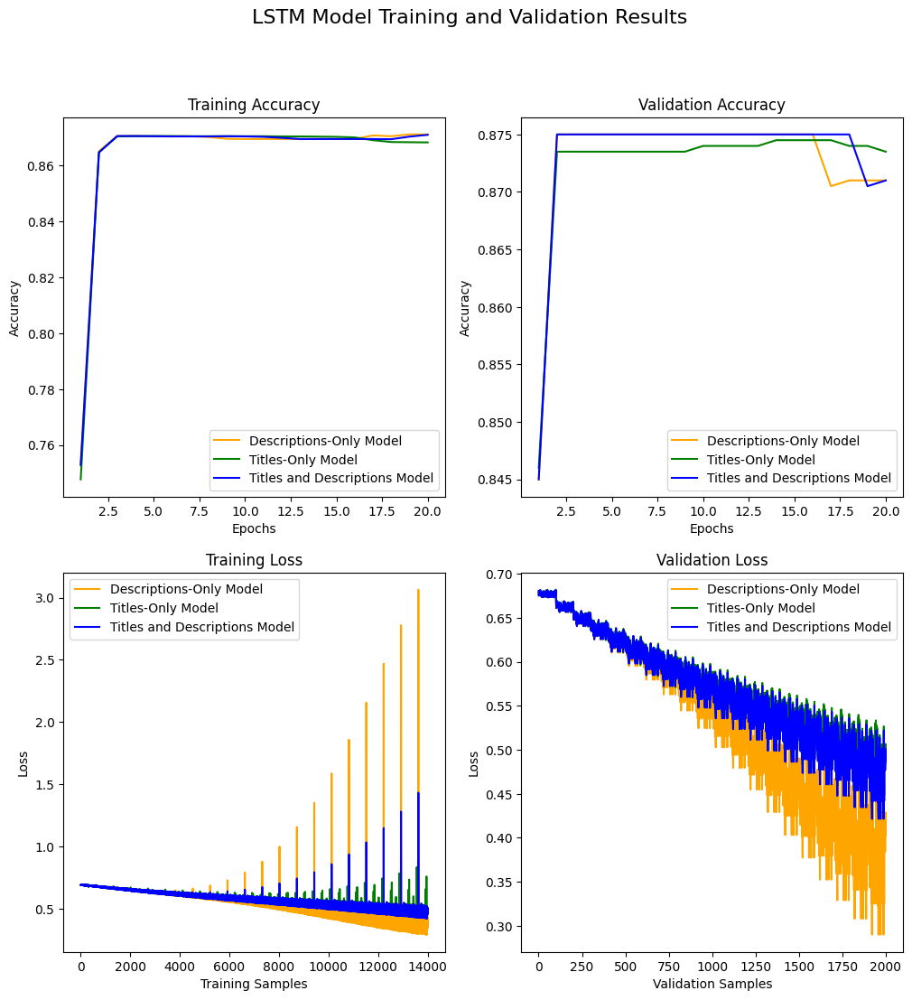

!!! Test Results for LSTM Models with LR 0.00035 and 20 Training Epochs !!!
| LSTM Model              |   Test Accuracy |   Test Precision |   Test Recall |
|-------------------------|-----------------|------------------|---------------|
| Description-Only        |         0.88    |         0.53     |    0.215447   |
| Titles-Only             |         0.87575 |         0.222222 |    0.00406504 |
| Titles and Descriptions |         0.87975 |         0.527638 |    0.213415   |



In [ ]:
'''
LONG TERM SHORT MEMORY RNN CLASS

This block will handle creating the LSTM model for use with processed data.
'''

class LSTMModel:

	# Class Constructor
	def __init__(self, trainingDataSet, trainingTargetSet, validationDataSet, validationTargetSet, learningRate=0.0001, numberEpochs=20):
		##############################
		# INITIALIZE CLASS VARIABLES #
		##############################
		self.trainingDataSet = trainingDataSet
		self.trainingTargetSet = trainingTargetSet
		self.validationDataSet = validationDataSet
		self.validationTargetSet = validationTargetSet
		self.learningRate = learningRate
		self.numberEpochs = numberEpochs
		self.trainingLosses = []
		self.trainingAccuracies = []
		self.validationLosses = []
		self.validationAccuracies = []

		##############################
		# INITIALIZE WEIGHT MATRICES #
		##############################

		# Get random generator from numpy
		randomGenerator = np.random.default_rng(seed=2002)

		# Initialize Hidden Layer
		self.hiddenWeights = randomGenerator.random((100, 100)) / 5 - .1
		self.hiddenBias = randomGenerator.random(100) / 5 - .1

		# Initialize Dense Layer
		self.denseWeights = randomGenerator.random((20, 100)) / 5 - .1 # 20 genres out
		self.denseBias = randomGenerator.random(20) / 5 - .1

		# Initialize LSTM Forget Gate
		self.gateWeight_Forget_Input = randomGenerator.random((100, 100)) / 5 - .1
		self.gateWeight_Forget_Hidden = randomGenerator.random((100, 100)) / 5 - .1
		self.gateBias_Forget = randomGenerator.random((100,)) / 5 - .1

		# Initialize LSTM Input Gate
		self.gateWeight_Input_Input = randomGenerator.random((100, 100)) / 5 - .1
		self.gateWeight_Input_Hidden = randomGenerator.random((100, 100)) / 5 - .1
		self.gateBias_Input = randomGenerator.random((100,)) / 5 - .1

		# Initialize LSTM Output Gate
		self.gateWeight_Output_Input = randomGenerator.random((100, 100)) / 5 - .1
		self.gateWeight_Output_Hidden = randomGenerator.random((100, 100)) / 5 - .1
		self.gateBias_Output = randomGenerator.random((100,)) / 5 - .1

		# Initialize LSTM C Tilde Gate
		self.gateWeight_CTilde_Input = randomGenerator.random((100, 100)) / 5 - .1
		self.gateWeight_CTilde_Hidden = randomGenerator.random((100, 100)) / 5 - .1
		self.gateBias_CTilde = randomGenerator.random((100,)) / 5 - .1


		# Print initial weight matrices
		if DFLAG_PRINT_RNN:
			print(f"Initial Input Weights: \n{self.inputWeights}\n")
			print(f"Initial Hidden Weights: \n{self.hiddenWeights}\n")
			print(f"Initial Output Weights: \n{self.outputWeights}\n")

		############################
		# TRAIN AND VALIDATE MODEL #
		############################
		for epoch in range(self.numberEpochs):
			if DFLAG_PRINT_RNN:
				print(f"===========================")
				print(f"Beginning epoch {epoch + 1} of {self.numberEpochs}!")
				print(f"===========================")

			# Train model with training data set
			predictedTargetsBinary, predictedTargetsSigmoid = self.__learnBatch(self.trainingDataSet, self.trainingTargetSet, f"Train-{epoch}")

			# Print actual and predicted targets if enabled
			if DFLAG_PRINT_RNN:
				print(f"Actual Training Targets: \n{self.trainingTargetSet.to_numpy()}\n")
				print(f"Predicted Training Targets (Binary): \n{predictedTargetsBinary}\n")
				print(f"Predicted Training Targets (Sigmoid): \n{predictedTargetsSigmoid}\n")

			# Calculate training loss and accuracy
			actualTargets = self.trainingTargetSet.to_numpy()
			self.trainingLosses.extend(self.__evaluateLosses(actualTargets, predictedTargetsSigmoid))
			self.trainingAccuracies.append(self.__evaluateAccuracy(actualTargets, predictedTargetsBinary))

			# Validate model with validation data set
			predictedTargetsBinary, predictedTargetsSigmoid = self.__predictBatch(self.validationDataSet, f"Validation-{epoch}")

			# Print actual and predicted targets if enabled
			if DFLAG_PRINT_RNN:
				print(f"Actual Validation Targets: \n{actualTargets}\n")
				print(f"Predicted Validation Targets (Binary): \n{predictedTargetsBinary}\n")
				print(f"Predicted Validation Targets (Sigmoid): \n{predictedTargetsSigmoid}\n")

			# Calculate validation loss and accuracy
			actualTargets = self.validationTargetSet.to_numpy()
			self.validationLosses.extend(self.__evaluateLosses(actualTargets, predictedTargetsSigmoid))
			self.validationAccuracies.append(self.__evaluateAccuracy(actualTargets, predictedTargetsBinary))

		# Print final losses and accuracies
		if DFLAG_PRINT_RNN:
			print(f"===========================")
			print(f"Final Training Losses: \n{self.trainingLosses}\n")
			print(f"Final Training Accuracies: \n{self.trainingAccuracies}\n")
			print(f"Final Validation Losses: \n{self.validationLosses}\n")
			print(f"Final Validation Accuracies: \n{self.validationAccuracies}\n")
			print(f"===========================")


	def testModel(self, testDataSet, testTargetSet):
		# Validate model with test data set
		actualTargets = testTargetSet.to_numpy()
		predictedTargetsBinary, predictedTargetsSigmoid = self.__predictBatch(testDataSet, "Test")

		# Print actual and predicted targets if enabled
		if DFLAG_PRINT_RNN_TEST:
			print(f"Actual Test Targets: \n{actualTargets}\n")
			print(f"Predicted Targets Binary: \n{predictedTargetsBinary}\n")
			print(f"Predicted Targets Sigmoid: \n{predictedTargetsSigmoid}\n")

		# Calculate test accuracy
		testAccuracy = self.__evaluateAccuracy(actualTargets, predictedTargetsBinary)
		if DFLAG_PRINT_RNN_TEST:
			print(f"Test Accuracy: {testAccuracy:.2f}")

		# Calculate test precision
		testPrecision = self.__evaluatePrecision(actualTargets, predictedTargetsBinary)
		if DFLAG_PRINT_RNN_TEST:
			print(f"Test Precision: {testPrecision:.2f}")

		# Calculate test recall
		testRecall = self.__evaluateRecall(actualTargets, predictedTargetsBinary)
		if DFLAG_PRINT_RNN_TEST:
			print(f"Test Recall: {testRecall:.2f}")

		return testAccuracy, testPrecision, testRecall

	def __learnBatch(self, dataBatch, targetBatch, batchIdentifier=None):
		predictedTargetsBinary = []
		predictedTargetsSigmoid = []
		for i in range (len(dataBatch)):
			# Get current data sequence
			currentDataSeries = dataBatch.iloc[i]
			currentDataSequence = currentDataSeries.iloc[0]

			# Get current target sequence
			currentTargetSeries = targetBatch.iloc[i]
			currentTargetSequence = currentTargetSeries.to_numpy().astype(np.float32)

			# Train the model with the current sequence
			outputBinary, outputSigmoid = self.__learnSequence(currentDataSequence, currentTargetSequence, f"{batchIdentifier}-{i}")
			predictedTargetsBinary.append(outputBinary)
			predictedTargetsSigmoid.append(outputSigmoid)
		return np.array(predictedTargetsBinary), np.array(predictedTargetsSigmoid)

	def __predictBatch(self, dataBatch, batchIdentifier=None):
		predictedTargetsBinary = []
		predictedTargetsSigmoid = []
		for i in range (len(dataBatch)):
			# Get current data sequence
			currentDataSeries = dataBatch.iloc[i]
			currentDataSequence = currentDataSeries.iloc[0]

			# Validate the model with the current sequence
			outputBinary, outputSigmoid = self.__predictSequence(currentDataSequence, f"{batchIdentifier}-{i}")
			predictedTargetsBinary.append(outputBinary)
			predictedTargetsSigmoid.append(outputSigmoid)
		return np.array(predictedTargetsBinary), np.array(predictedTargetsSigmoid)

	def __learnSequence(self, currentSequence, targetSequence, sequenceIdentifier=None):
		if DFLAG_PRINT_RNN_TRAIN:
			if sequenceIdentifier is not None:
				print(f"Beginning learning for sequence {sequenceIdentifier} with length {len(currentSequence)}!")
			else:
				print(f"Beginning learning for new sequence with length {len(currentSequence)}!")

		# Initialize lists for holding states
		forgetSigmoidsArray = []
		inputSigmoidsArray = []
		outputSigmoidsArray = []
		tanhToCellArray = []
		lstmCellArrays = []
		hiddenArrays = []
		outputArraysDense = []
		outputArraysSigmoid = []
		outputArraysBinary = []

		# Initialize gradients for each parameter
		lossGradients = [0] * len(currentSequence)
		denseWeights_Gradient = np.zeros_like(self.denseWeights)
		denseBias_Gradient = np.zeros_like(self.denseBias)
		hiddenWeights_Gradient = np.zeros_like(self.hiddenWeights)
		hiddenBias_Gradient = np.zeros_like(self.hiddenBias)
		inputWeights_Gradient = np.zeros_like(self.gateWeight_Input_Input)
		inputBias_Gradient = np.zeros_like(self.gateBias_Input)
		ctildeWeights_Gradient = np.zeros_like(self.gateWeight_CTilde_Input)
		ctildeBias_Gradient = np.zeros_like(self.gateBias_CTilde)
		forgetWeights_Gradient = np.zeros_like(self.gateWeight_Forget_Input)
		forgetBias_Gradient = np.zeros_like(self.gateBias_Forget)

		#################
		# FORWARD PASS  #
		#################
		previousHiddenState = None
		previousLstmCellState = None
		for i in range(len(currentSequence)):

			# Get the current word
			currentWord_Input = currentSequence[i]

			# Calculate forget gate
			if previousHiddenState is None:
				currentWord_forgetGateOutput = np.dot(self.gateWeight_Forget_Input, currentWord_Input) + self.gateBias_Forget
			else:
				currentWord_forgetGateOutput = np.dot(self.gateWeight_Forget_Input, currentWord_Input) + np.dot(self.gateWeight_Forget_Hidden, previousHiddenState) + self.gateBias_Forget
			currentWord_forgetGateOutputSigmoid = 1 / (1 + np.exp(-currentWord_forgetGateOutput))
			forgetSigmoidsArray.append(currentWord_forgetGateOutputSigmoid)

			# Calculate input gate
			if previousHiddenState is None:
				currentWord_inputGateOutput = np.dot(self.gateWeight_Input_Input, currentWord_Input) + self.gateBias_Input
			else:
				currentWord_inputGateOutput = np.dot(self.gateWeight_Input_Input, currentWord_Input) + np.dot(self.gateWeight_Input_Hidden, previousHiddenState) + self.gateBias_Input
			currentWord_inputGateOutputSigmoid = 1 / (1 + np.exp(-currentWord_inputGateOutput))
			inputSigmoidsArray.append(currentWord_inputGateOutputSigmoid)

			# Calculate output gate
			if previousHiddenState is None:
				currentWord_outputGateOutput = np.dot(self.gateWeight_Output_Input, currentWord_Input) + self.gateBias_Output
			else:
				currentWord_outputGateOutput = np.dot(self.gateWeight_Output_Input, currentWord_Input) + np.dot(self.gateWeight_Output_Hidden, previousHiddenState) + self.gateBias_Output
			currentWord_outputGateOutputSigmoid = 1 / (1 + np.exp(-currentWord_outputGateOutput))
			outputSigmoidsArray.append(currentWord_outputGateOutputSigmoid)

			# Calculate C Tilde to LSTM Cell gate
			if previousHiddenState is None:
				currentWord_C_TildeOutput = np.dot(self.gateWeight_CTilde_Input, currentWord_Input) + self.gateBias_CTilde
			else:
				currentWord_C_TildeOutput = np.dot(self.gateWeight_CTilde_Input, currentWord_Input) + np.dot(self.gateWeight_CTilde_Hidden, previousHiddenState) + self.gateBias_CTilde
			currentWord_C_TildeOutputTanh = np.tanh(currentWord_C_TildeOutput)
			tanhToCellArray.append(currentWord_C_TildeOutputTanh)

			# Calculate new LSTM Cell state
			if previousLstmCellState is None:
				currentWord_LstmCellState = np.multiply(currentWord_inputGateOutputSigmoid, currentWord_C_TildeOutputTanh)
			else:
				currentWord_LstmCellState = np.multiply(currentWord_inputGateOutputSigmoid, currentWord_C_TildeOutputTanh) + np.multiply(currentWord_forgetGateOutputSigmoid, previousLstmCellState)
			lstmCellArrays.append(currentWord_LstmCellState)
			previousLstmCellState = currentWord_LstmCellState

			# Calculate new hidden state
			currentWord_HiddenState = np.multiply(currentWord_outputGateOutputSigmoid, np.tanh(currentWord_LstmCellState))
			hiddenArrays.append(currentWord_HiddenState)
			previousHiddenState = currentWord_HiddenState

			# Calculate dense state output
			currentWord_Output_Dense = np.dot(self.denseWeights, currentWord_HiddenState)
			outputArraysDense.append(currentWord_Output_Dense)

			# Apply sigmoid to get probability of each genre
			currentWord_Output_Sigmoid = 1 / (1 + np.exp(-currentWord_Output_Dense))
			outputArraysSigmoid.append(currentWord_Output_Sigmoid)

			# Get straight binary classifiers
			currentWord_Output_Binary = (currentWord_Output_Sigmoid >= 0.50).astype(int)
			outputArraysBinary.append(currentWord_Output_Binary)

		# Print output arrays
		if DFLAG_PRINT_RNN_TRAIN:
			if sequenceIdentifier is not None:
				print(f"Final Output Array Sigmoid for sequence {sequenceIdentifier}: \n{outputArraysSigmoid[-1]}\n")
				print(f"Final Output Array Binary for sequence {sequenceIdentifier}: \n{outputArraysBinary[-1]}\n")
				print(f"Actual Target Sequence for sequence {sequenceIdentifier}: \n{targetSequence}\n")
			else:
				print(f"Final Output Array Sigmoid for new sequence: \n{outputArraysSigmoid[-1]}\n")
				print(f"Final Output Array Binary for new sequence: \n{outputArraysBinary[-1]}\n")
				print(f"Actual Target Sequence for new sequence: \n{targetSequence}\n")

		#################
		# BACKWARD PASS #
		#################
		nextHiddenState = None
		nextLstmCellState = None
		for i in range(len(currentSequence) - 1, -1, -1):

			# Get the current word
			currentWord_Input = currentSequence[i]

			# Compute the loss gradient for the final output
			if nextHiddenState is None:
				lossGradients[i] = self.__binaryCrossEntropyGradient(targetSequence, outputArraysSigmoid[i])

				# Compute dense weight gradients (adjust output weights to make prediction better)
				denseWeights_Gradient += np.matmul(lossGradients[i].reshape(20, 1), hiddenArrays[i].reshape(1, 100))

				# Compute output bias gradient
				denseBias_Gradient += np.mean(lossGradients[i])
			else:
				# We don't care about the rest of the outputs, so we don't really have any loss here
				lossGradients[i] = np.zeros_like(outputArraysSigmoid[i])

			# Reverse the dense weights to get the gradient for the hidden state
			denseGradient = np.dot(self.denseWeights.T, lossGradients[i])

			# If we are at the last sample, only look at dense grad, else we consider gradient from next hidden state
			if nextHiddenState is None:
				hiddenGradient = denseGradient
			else:
				hiddenGradient = denseGradient + np.matmul(nextHiddenState, self.hiddenWeights.T)

			# Update the hidden state
			nextHiddenState = hiddenGradient

			# If we are not at the first word, update hidden weights and hidden bias gradients
			if i > 0:
				hiddenWeights_Gradient += np.matmul(hiddenArrays[i - 1].reshape(100, 1), hiddenGradient.reshape(1, 100))
				hiddenBias_Gradient += np.mean(hiddenGradient)

			# Calculate the tanh derivative of the hidden state
			hiddenState_tanH_derivative = 1 - hiddenArrays[i] ** 2

			# Reverse the tanh activation to get the gradient for the LSTM cell state
			currentLstmCellState = np.multiply(hiddenState_tanH_derivative, previousLstmCellState)
			previousLstmCellState = currentLstmCellState

			# Reverse ctilde gate to get the gradient for the C Tilde gate
			ctildeWeights_Gradient = np.multiply(hiddenState_tanH_derivative, tanhToCellArray[i])
			ctildeWeights_Gradient = 1 - ctildeWeights_Gradient ** 2
			ctildeWeights_Gradient = np.outer(ctildeWeights_Gradient, hiddenArrays[i])
			ctildeBias_Gradient = np.mean(ctildeWeights_Gradient)

			# Reverse the input gate to get the gradient for the input gate
			inputWeights_Gradient = np.multiply(hiddenState_tanH_derivative, inputSigmoidsArray[i])
			inputWeights_Gradient = np.multiply(inputWeights_Gradient, (1 - inputWeights_Gradient))
			inputWeights_Gradient = np.outer(inputWeights_Gradient, currentWord_Input[i])
			inputBias_Gradient = np.mean(inputWeights_Gradient)

			# Reverse the forget gate to get the gradient for the forget gate
			forgetWeights_Gradient = np.multiply(hiddenState_tanH_derivative, forgetSigmoidsArray[i])
			forgetWeights_Gradient = np.multiply(forgetWeights_Gradient, (1 - forgetWeights_Gradient))
			forgetWeights_Gradient = np.outer(forgetWeights_Gradient, currentWord_Input[i])
			forgetBias_Gradient = np.mean(forgetWeights_Gradient)

		# Update parameters with learning rate
		self.denseWeights -= self.learningRate * denseWeights_Gradient
		self.denseBias -= self.learningRate * denseBias_Gradient
		self.hiddenWeights -= self.learningRate * hiddenWeights_Gradient
		self.hiddenBias -= self.learningRate * hiddenBias_Gradient
		self.gateWeight_Input_Input -= self.learningRate * inputWeights_Gradient
		self.gateBias_Input -= self.learningRate * inputBias_Gradient
		self.gateWeight_CTilde_Input -= self.learningRate * ctildeWeights_Gradient
		self.gateBias_CTilde -= self.learningRate * ctildeBias_Gradient
		self.gateWeight_Forget_Input -= self.learningRate * forgetWeights_Gradient
		self.gateBias_Forget -= self.learningRate * forgetBias_Gradient


		# Print final biasses and weights
		if DFLAG_PRINT_RNN_TRAIN_GRADIENTS:
			if sequenceIdentifier is not None:
				print(f"Final Input Weights for sequence {sequenceIdentifier}: \n{self.inputWeights}\n")
				print(f"Final Hidden Weights for sequence {sequenceIdentifier}: \n{self.hiddenWeights}\n")
				print(f"Final Output Weights for sequence {sequenceIdentifier}: \n{self.outputWeights}\n")
				print(f"Final Hidden Bias for sequence {sequenceIdentifier}: \n{self.hiddenBias}\n")
				print(f"Final Output Bias for sequence {sequenceIdentifier}: \n{self.outputBias}\n")
			else:
				print(f"Final Input Weights for new sequence: \n{self.inputWeights}\n")
				print(f"Final Hidden Weights for new sequence: \n{self.hiddenWeights}\n")
				print(f"Final Output Weights for new sequence: \n{self.outputWeights}\n")
				print(f"Final Hidden Bias for new sequence: \n{self.hiddenBias}\n")
				print(f"Final Output Bias for new sequence: \n{self.outputBias}\n")

		# Print loss gradients
		if DFLAG_PRINT_RNN_TRAIN_GRADIENTS:
			if sequenceIdentifier is not None:
				print(f"Loss Gradient for sequence {sequenceIdentifier}: \n{lossGradients}\n")
			else:
				print(f"Loss Gradient for new sequence: \n{lossGradients}\n")

		return outputArraysBinary[-1], outputArraysSigmoid[-1]

	def __predictSequence(self, dataSequence, sequenceIdentifier=None):
		if DFLAG_PRINT_RNN_VALIDATION:
			if sequenceIdentifier is not None:
				print(f"Beginning validation for sequence {sequenceIdentifier} with length {len(dataSequence)}!")
			else:
				print(f"Beginning validation for new sequence with length {len(dataSequence)}!")

		# Initialize lists for holding states
		forgetSigmoidsArray = []
		inputSigmoidsArray = []
		outputSigmoidsArray = []
		tanhToCellArray = []
		lstmCellArrays = []
		hiddenArrays = []
		outputArraysDense = []
		outputArraysSigmoid = []
		outputArraysBinary = []

		#################
		# FORWARD PASS  #
		#################
		previousHiddenState = None
		previousLstmCellState = None
		for i in range(len(dataSequence)):

			# Get the current word
			currentWord_Input = dataSequence[i]

			# Calculate forget gate
			if previousHiddenState is None:
				currentWord_forgetGateOutput = np.dot(self.gateWeight_Forget_Input, currentWord_Input) + self.gateBias_Forget
			else:
				currentWord_forgetGateOutput = np.dot(self.gateWeight_Forget_Input, currentWord_Input) + np.dot(self.gateWeight_Forget_Hidden, previousHiddenState) + self.gateBias_Forget
			currentWord_forgetGateOutputSigmoid = 1 / (1 + np.exp(-currentWord_forgetGateOutput))
			forgetSigmoidsArray.append(currentWord_forgetGateOutputSigmoid)

			# Calculate input gate
			if previousHiddenState is None:
				currentWord_inputGateOutput = np.dot(self.gateWeight_Input_Input, currentWord_Input) + self.gateBias_Input
			else:
				currentWord_inputGateOutput = np.dot(self.gateWeight_Input_Input, currentWord_Input) + np.dot(self.gateWeight_Input_Hidden, previousHiddenState) + self.gateBias_Input
			currentWord_inputGateOutputSigmoid = 1 / (1 + np.exp(-currentWord_inputGateOutput))
			inputSigmoidsArray.append(currentWord_inputGateOutputSigmoid)

			# Calculate output gate
			if previousHiddenState is None:
				currentWord_outputGateOutput = np.dot(self.gateWeight_Output_Input, currentWord_Input) + self.gateBias_Output
			else:
				currentWord_outputGateOutput = np.dot(self.gateWeight_Output_Input, currentWord_Input) + np.dot(self.gateWeight_Output_Hidden, previousHiddenState) + self.gateBias_Output
			currentWord_outputGateOutputSigmoid = 1 / (1 + np.exp(-currentWord_outputGateOutput))
			outputSigmoidsArray.append(currentWord_outputGateOutputSigmoid)

			# Calculate C Tilde to LSTM Cell gate
			if previousHiddenState is None:
				currentWord_C_TildeOutput = np.dot(self.gateWeight_CTilde_Input, currentWord_Input) + self.gateBias_CTilde
			else:
				currentWord_C_TildeOutput = np.dot(self.gateWeight_CTilde_Input, currentWord_Input) + np.dot(self.gateWeight_CTilde_Hidden, previousHiddenState) + self.gateBias_CTilde
			currentWord_C_TildeOutputTanh = np.tanh(currentWord_C_TildeOutput)
			tanhToCellArray.append(currentWord_C_TildeOutputTanh)

			# Calculate new LSTM Cell state
			if previousLstmCellState is None:
				currentWord_LstmCellState = np.multiply(currentWord_inputGateOutputSigmoid, currentWord_C_TildeOutputTanh)
			else:
				currentWord_LstmCellState = np.multiply(currentWord_inputGateOutputSigmoid, currentWord_C_TildeOutputTanh) + np.multiply(currentWord_forgetGateOutputSigmoid, previousLstmCellState)
			lstmCellArrays.append(currentWord_LstmCellState)
			previousLstmCellState = currentWord_LstmCellState

			# Calculate new hidden state
			currentWord_HiddenState = np.multiply(currentWord_outputGateOutputSigmoid, np.tanh(currentWord_LstmCellState))
			hiddenArrays.append(currentWord_HiddenState)
			previousHiddenState = currentWord_HiddenState

			# Calculate dense state output
			currentWord_Output_Dense = np.dot(self.denseWeights, currentWord_HiddenState)
			outputArraysDense.append(currentWord_Output_Dense)

			# Apply sigmoid to get probability of each genre
			currentWord_Output_Sigmoid = 1 / (1 + np.exp(-currentWord_Output_Dense))
			outputArraysSigmoid.append(currentWord_Output_Sigmoid)

			# Get straight binary classifiers
			currentWord_Output_Binary = (currentWord_Output_Sigmoid >= 0.50).astype(int)
			outputArraysBinary.append(currentWord_Output_Binary)

		# Return final output
		if DFLAG_PRINT_RNN_VALIDATION:
			if sequenceIdentifier is not None:
				print(f"Final Output Array Binary for sequence {sequenceIdentifier}: \n{outputArraysBinary[-1]}\n")
			else:
				print(f"Final Output Array Binary for new sequence: \n{outputArraysBinary[-1]}\n")

		return outputArraysBinary[-1], outputArraysSigmoid[-1]

	# Calculate binary cross-entropy loss
	def __binaryCrossEntropyLoss(self, target_Actual, target_Predicted, eps=1e-8):
		# Prevent division by zero and log(0) issues
		target_Predicted = np.clip(target_Predicted, eps, 1 - eps)
		return -np.mean(target_Actual * np.log(target_Predicted) + (1 - target_Actual) * np.log(1 - target_Predicted))

	# Calculate the gradient of the binary cross-entropy loss
	def __binaryCrossEntropyGradient(self, target_Actual, target_Predicted, eps=1e-8):
		# Prevent division by zero and log(0) issues
		target_Predicted = np.clip(target_Predicted, eps, 1 - eps)
		return (target_Predicted - target_Actual) / (target_Predicted * (1 - target_Predicted))

	# Evaluate losses of a given set (nparray of nparrays) of actuals and set (nparray of nparrays) of predictions
	def __evaluateLosses(self, actualsArray, predictionsArray):
		if len(actualsArray) != len(predictionsArray):
			warn(f"Call was made to evaluate loss with mismatched actuals (size {len(actualsArray)}) and predictions (size {len(predictionsArray)}) arrays!")

		losses = []
		for i in range(len(predictionsArray)):
			loss = float(self.__binaryCrossEntropyLoss(actualsArray[i], predictionsArray[i]))
			losses.append(loss)
		return losses

	# Evaluate accuracy of a given set (nparray of nparrays) of actuals and set (nparray of nparrays) of predictions
	def __evaluateAccuracy(self, actualsArray, predictionsArray):
		if len(actualsArray) != len(predictionsArray):
			warn(f"Call was made to evaluate accuracy with mismatched actuals (size {len(actualsArray)}) and predictions (size {len(predictionsArray)}) arrays!")
		totalCorrect = 0
		totalPredictions = 0

		for i in range(len(predictionsArray)):
			currentTarget = actualsArray[i].astype(int)
			currentPrediction = predictionsArray[i].astype(int)

			# This will calculate the number of correct predictions for the current sample
			totalCorrect += np.sum(currentTarget == currentPrediction)
			totalPredictions += len(currentPrediction)

		return (totalCorrect / totalPredictions)

	# Evaluate precision of a given set (nparray of nparrays) of actuals and set (nparray of nparrays) of predictions
	def __evaluatePrecision(self, actualsArray, predictionsArray):
		if len(actualsArray) != len(predictionsArray):
			warn(f"Call was made to evaluate precision with mismatched actuals (size {len(actualsArray)}) and predictions (size {len(predictionsArray)}) arrays!")
		totalTruePositives = 0
		totalFalsePositives = 0

		for i in range(len(predictionsArray)):
			currentTarget = actualsArray[i].astype(int)
			currentPrediction = predictionsArray[i].astype(int)

			# Calculate true positives and false positives for the current sample
			totalTruePositives += np.sum((currentTarget == 1) & (currentPrediction == 1))
			totalFalsePositives += np.sum((currentTarget == 0) & (currentPrediction == 1))

		return (totalTruePositives / (totalTruePositives + totalFalsePositives))

	# Evaluate recall of a given set (nparray of nparrays) of actuals and set (nparray of nparrays) of predictions
	def __evaluateRecall(self, actualsArray, predictionsArray):
		if len(actualsArray) != len(predictionsArray):
			warn(f"Call was made to evaluate recall with mismatched actuals (size {len(actualsArray)}) and predictions (size {len(predictionsArray)}) arrays!")
		totalTruePositives = 0
		totalFalseNegatives = 0

		for i in range(len(predictionsArray)):
			currentTarget = actualsArray[i].astype(int)
			currentPrediction = predictionsArray[i].astype(int)

			# Calculate true positives and false negatives for the current sample
			totalTruePositives += np.sum((currentTarget == 1) & (currentPrediction == 1))
			totalFalseNegatives += np.sum((currentTarget == 1) & (currentPrediction == 0))

		return (totalTruePositives / (totalTruePositives + totalFalseNegatives))

###############
# LSTM MODELS #
###############

# Tabulate Data
LstmResults_Header = ["LSTM Model", "Test Accuracy", "Test Precision", "Test Recall"]
LstmResults_Table = []

# Set up matplotlib for plotting (axs[0,0] for train accuracy, axs[0,1] for validation accuracy, axs[1,0] for train loss, axs[1,1] for validation loss)
epochsXList = list(range(1, 21))
trainingDataXList = list(range(1, 14001))
validationDataXList = list(range(1, 2001))
fig, ((trainAccuracyPlot, valAccuracyPlot), (trainLossPlot, valLossPlot)) = plt.subplots(2, 2, figsize=(12, 12))

# Descriptions-Only LSTM Model
lstmModel_DescriptionsOnly = LSTMModel(
	trainingDataSet=RnnDataLoader.df_descriptionsOnly_train,
	trainingTargetSet=RnnDataLoader.df_genres_train,
	validationDataSet=RnnDataLoader.df_descriptionsOnly_validation,
	validationTargetSet=RnnDataLoader.df_genres_validation,
	learningRate=0.00035,
	numberEpochs=20
)
trainAccuracyPlot.plot(epochsXList, lstmModel_DescriptionsOnly.trainingAccuracies, label="Descriptions-Only Model", color='orange')
valAccuracyPlot.plot(epochsXList, lstmModel_DescriptionsOnly.validationAccuracies, label="Descriptions-Only Model", color='orange')
trainLossPlot.plot(trainingDataXList, lstmModel_DescriptionsOnly.trainingLosses, label="Descriptions-Only Model", color='orange')
valLossPlot.plot(validationDataXList, lstmModel_DescriptionsOnly.validationLosses, label="Descriptions-Only Model", color='orange')
testAccuracy_DescriptionsOnly, testPrecision_DescriptionsOnly, testRecall_DescriptionsOnly = lstmModel_DescriptionsOnly.testModel(
	RnnDataLoader.df_descriptionsOnly_test,
	RnnDataLoader.df_genres_test
)
LstmResults_Table.append(["Description-Only", testAccuracy_DescriptionsOnly, testPrecision_DescriptionsOnly, testRecall_DescriptionsOnly])

# I kept running out of application memory, so I delete models once they are done
del lstmModel_DescriptionsOnly
gc.collect()

# Titles-Only LSTM Model
lstmModel_TitlesOnly = LSTMModel(
	trainingDataSet=RnnDataLoader.df_titlesOnly_train,
	trainingTargetSet=RnnDataLoader.df_genres_train,
	validationDataSet=RnnDataLoader.df_titlesOnly_validation,
	validationTargetSet=RnnDataLoader.df_genres_validation,
	learningRate=0.00035,
	numberEpochs=20
)
trainAccuracyPlot.plot(epochsXList, lstmModel_TitlesOnly.trainingAccuracies, label="Titles-Only Model", color='green')
valAccuracyPlot.plot(epochsXList, lstmModel_TitlesOnly.validationAccuracies, label="Titles-Only Model", color='green')
trainLossPlot.plot(trainingDataXList, lstmModel_TitlesOnly.trainingLosses, label="Titles-Only Model", color='green')
valLossPlot.plot(validationDataXList, lstmModel_TitlesOnly.validationLosses, label="Titles-Only Model", color='green')
testAccuracy_TitlesOnly, testPrecision_TitlesOnly, testRecall_TitlesOnly = lstmModel_TitlesOnly.testModel(
	RnnDataLoader.df_titlesOnly_test,
	RnnDataLoader.df_genres_test
)
LstmResults_Table.append(["Titles-Only", testAccuracy_TitlesOnly, testPrecision_TitlesOnly, testRecall_TitlesOnly])

# I kept running out of application memory, so I delete models once they are done
del lstmModel_TitlesOnly
gc.collect()

# Titles and Descriptions LSTM Model
lstmModel_TitlesAndDescriptions = LSTMModel(
	trainingDataSet=RnnDataLoader.df_titlesAndDescriptions_train,
	trainingTargetSet=RnnDataLoader.df_genres_train,
	validationDataSet=RnnDataLoader.df_titlesAndDescriptions_validation,
	validationTargetSet=RnnDataLoader.df_genres_validation,
	learningRate=0.00035,
	numberEpochs=20
)
trainAccuracyPlot.plot(epochsXList, lstmModel_TitlesAndDescriptions.trainingAccuracies, label="Titles and Descriptions Model", color='blue')
valAccuracyPlot.plot(epochsXList, lstmModel_TitlesAndDescriptions.validationAccuracies, label="Titles and Descriptions Model", color='blue')
trainLossPlot.plot(trainingDataXList, lstmModel_TitlesAndDescriptions.trainingLosses, label="Titles and Descriptions Model", color='blue')
valLossPlot.plot(validationDataXList, lstmModel_TitlesAndDescriptions.validationLosses, label="Titles and Descriptions Model", color='blue')
testAccuracy_TitlesAndDescriptions, testPrecision_TitlesAndDescriptions, testRecall_TitlesAndDescriptions = lstmModel_TitlesAndDescriptions.testModel(
	RnnDataLoader.df_titlesAndDescriptions_test,
	RnnDataLoader.df_genres_test
)
LstmResults_Table.append(["Titles and Descriptions", testAccuracy_TitlesAndDescriptions, testPrecision_TitlesAndDescriptions, testRecall_TitlesAndDescriptions])

# I kept running out of application memory, so I delete models once they are done
del lstmModel_TitlesAndDescriptions
gc.collect()

# Display the plots
fig.suptitle('LSTM Model Training and Validation Results', fontsize=16)
trainAccuracyPlot.set_title("Training Accuracy")
valAccuracyPlot.set_title("Validation Accuracy")
trainLossPlot.set_title("Training Loss")
valLossPlot.set_title("Validation Loss")
trainAccuracyPlot.set_xlabel("Epochs")
valAccuracyPlot.set_xlabel("Epochs")
trainLossPlot.set_xlabel("Training Samples")
valLossPlot.set_xlabel("Validation Samples")
trainAccuracyPlot.set_ylabel("Accuracy")
valAccuracyPlot.set_ylabel("Accuracy")
trainLossPlot.set_ylabel("Loss")
valLossPlot.set_ylabel("Loss")
trainAccuracyPlot.legend()
valAccuracyPlot.legend()
trainLossPlot.legend()
valLossPlot.legend()
plt.show()

# Display the results table
print(f"!!! Test Results for LSTM Models with LR 0.00035 and 20 Training Epochs !!!")
print(tabulate.tabulate(LstmResults_Table, headers=LstmResults_Header, tablefmt='github'))
print(f"")

## Assignment 3 Part 2 Introduction

Welcome to my solution for Assignment 3. In part 2, I make a Convolutional Neural Network. There are two modes that this model is used with:
- 3 Convolution Layers, 3 Max-Pooling Layers
- 6 Convolution Layers, 3 Max-Pooling Layers

Similar to part 1, several metrics are collected along the way to analyze the model.


## Implementation Decisions

Prior to the model being run, images are collected from a web-hosted dataset. They are stored locally on the machine to be loaded and analyzed. They are first all reshaped to a constant size of (150, 150, 3) dimensions, with only a few outliers to this shape. Any remaining NAN's in the images are removed (which shouldn't happen in a normal case). The images and their target values are then loaded into numpy arrays and shuffled.

After the images have been loaded, they are used in each model to complete training. The dataset is pre-split into training and testing sets, with the training set being around 14,000 images and the test set being around 3,000 images. Each model is first trained on the training set, where they go through padding processes, convolutional layers, max pooling layers, stacking/unstacking processes, a flattening layer, a dropout layer, a dense layer, and finally an output layer. Backpropogation is then completed to update the weights at each layer based on the calculated loss from the target. 

The training architecture provides several features:

- Images are automatically trained in batches. The batch size can be adjusted via a model parameter.

- The number of convolutional layers, the number of filters to use per convolutional layer, and the size of convolutional filters can be all be adjusted via model parameters.

- The option to alternate max pooling is provided via a model parameter. 

- The dropout layer turns off neurons at a specific dropout rate. This can be adjusted via a model parameter.

- The dense layer uses random He initialization and implements a RELU activation function. 

- The output layer uses random Xavier initialization and implements a stable softmax activation function.

- Accuracy and loss are calculated on each image and stored for later use.

- The model's internal weights are serialized and saved to a JSON file at various points throughout training and once training has been fully completed. This allows for the model to be reconstructed at a later time.

Once training has been completed for each model, they are reconstructed and tested. Again, batches are used, and test overall accuracies and per-class accuracies are calculated. Two random images are chosen and the predictions from each model mode are saved. All of the results for each model are saved to a results file and then used to plot training performance and display testing performance in a table. For the two final predicted images, they are displayed along with the prediction by each model mode and the actual target class.

To support the development and use of these models, several features have been included:

- TQDM is used to provide progress bars for several steps in training and testing the models to make progress tracking easier.

- Internal model states (primarily weights) are saved to JSON files in the `modelinternals` directory.

- Model training and testing results are saved to JSON files in the `results` directory.

- Mobile alerts are setup with Pushover. This is very helpful with the long runtimes of the models.

- Some information is logged to log files in the `logs` directory throughout model progress and when exceptions occur.

At several points throughout the implementation of the CNN Model, there were large challenges to be addressed. Many optimizations and changes were made along the way. A high-level "chanegelog" of sorts is provided in the header of the CNN Model block. While not nearly exhaustive, they show how the model implementation changed over time.


## Performance Analysis

The performance of the CNN Model can be looked at from two perspectives: how performant the model's implementation is and how performant the model is on data.

### Implementation Performance

The implementation of the model has been somewhat optimized but leaves room for further improvements. The 3-Layer CNN Model takes around 3 hours to train (on my machine) and around 1.5 hours to test (on my machine). The 6-layer CNN Model takes around 8 hours to train (on my machine) and around 3 hours to test (again, on my machine). Since the model is based on numpy operations in the current form, only the CPU can be utilized, so other tools such as Google Colab do not offer much advantage here. However, if CuPy is used instead so that the operations can be performed on a GPU, then the model's implementation would likely be much more performant and tools such as Google Colab would likely produce much better results. 

Throughout the model, the need for memory is kept in mind. Local data is preferred when possible, and non-local data is cleared when no longer needed. Model saving allows for entire model objects to be cleared post-use, freeing memory for other operations. Results are also saved for the same reason. The use of batching in both training and testing keep the total amount of memory being used at any point as minimal as possible.

### Model Performance

As far as actual performance of the models on data, there is some achievement, but again, lots of room for improvement.

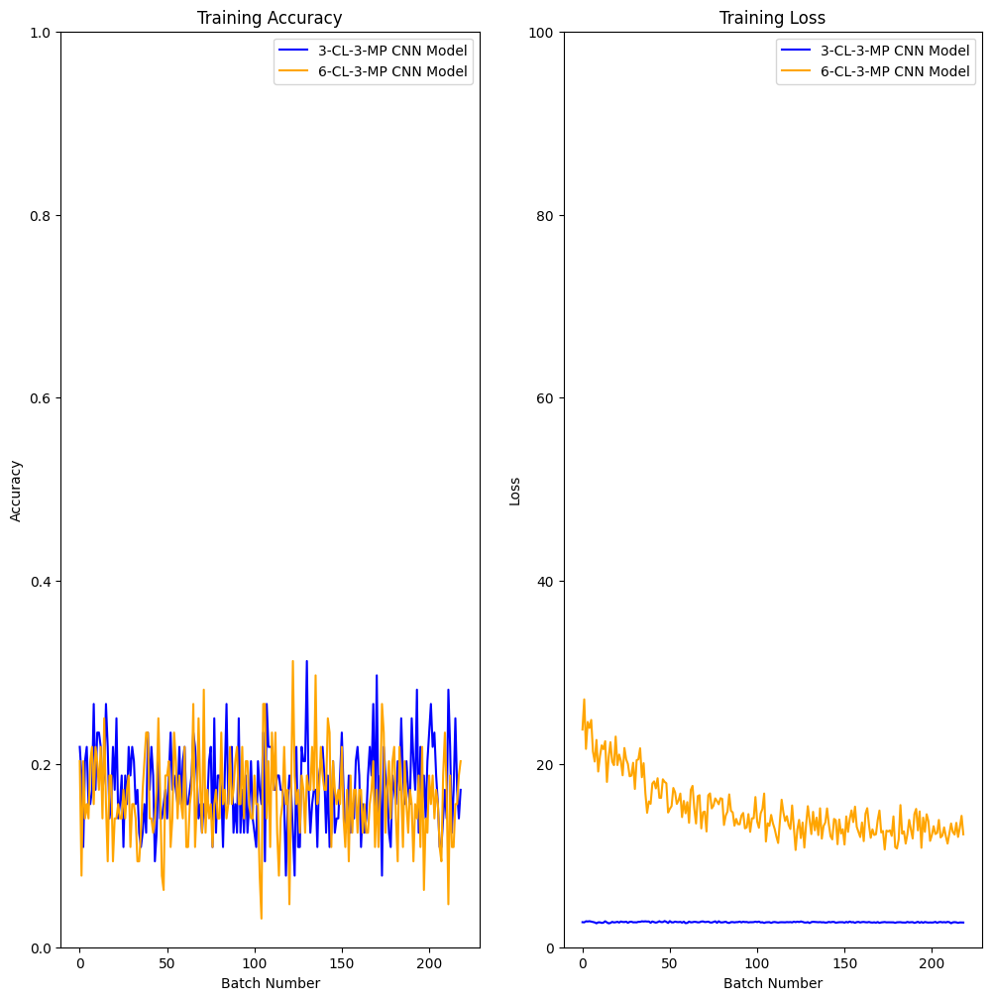

The above plots show the training accuracy and training loss of the model over all of the batches. Both models have relatively low accuracy, which is calculated as just the rate of true positives. They also both have low loss, with the 6-layer model having a decreasing loss over time and the 3-layer model having a pretty constant loss. Overall, these results show that the model might be learning some, but not enough to produce viable predictions during training.

The ideas are then confirmed by analyzing the test results:

| CNN Model           |   Test Mean Accuracy |   Forest Class Accuracy |   Buildings Class Accuracy |   Glacier Class Accuracy |   Street Class Accuracy |   Mountain Class Accuracy |   Sea Class Accuracy |
|---------------------|----------------------|-------------------------|----------------------------|--------------------------|-------------------------|---------------------------|----------------------|
| 3-CL-3-MP CNN Model |             0.18     |               0.0400844 |                   0.169336 |                0.0506329 |                0.303393 |                  0.384762 |             0.127451 |
| 6-CL-3-MP CNN Model |             0.156333 |               0.128692  |                   0.16476  |                0.164557  |                0.141717 |                  0.169524 |             0.166667 |

This data shows that, again, overall accuracy is not ideal. Additionally, per-class accuracy is relatively low, althoug the different modes appear to learn to predict different classes better. For instance, the three-layer CNN model is better than the six-layer CNN model at predicting street images and mountain images, whereas the six-layer CNN model is better than the three-layer CNN model at predicting forest images, glacier images, and sea images. 

These results may improve with further opimizations to the model's implementation, different activation or initialization functions, more epochs, different training rates, different dropout rates, or many other changes. However, the high runtime of the model makes parameters hard to adjust and optimize.

To showcase these results, below are two images randomly selected from the test data along with their predicted and actual classes:

![Test Image 2535](showcase/testimage2535.jpg)

Actual Class: [0 0 0 1 0 0] - Street

3-Layer Prediction: [0 0 1 0 0 0] - Glacier

6-Layer Prediction: [0 0 1 0 0 0] - Glacier


![Test Image 2666](showcase/testimage2666.jpg)

Actual Class: [0 0 0 0 1 0] - Mountain

3-Layer Prediction: [0 0 0 0 1 0] - Mountain

6-Layer prediction: [0 1 0 0 0 0 0] - Buildings

These predictions kind of sum up the model performance - while it may have learned something, the performance is not enough for the models to be relied upon for accurate predictions.

In [50]:
'''
IMAGE DATASET DOWNLOADING / PREPARATION
'''

# Image Data Loader Class
class ImageDataLoader:
	# This class will download all images and store them in a dictionary for easy access

	# Class Constructor
	def __init__(self):
		# Initialize Class Variables
		self.datasetPath = None
		self.trainPath = None
		self.testPath = None
		self.totalTrainImages = 0
		self.totalTestImages = 0
		self.numClasses = 0
		self.classEncodings = {}
		trainingImageDictionary = {}
		testImageDictionary = {}

		# Download the Intel Image Classification dataset from Kaggle
		self.datasetPath = kagglehub.dataset_download("puneet6060/intel-image-classification")
		self.trainPath = os.path.join(self.datasetPath, "seg_train/seg_train")
		self.testPath = os.path.join(self.datasetPath, "seg_test/seg_test")

		# Print the contents of the training path
		for className in tqdm(iterable=os.listdir(self.trainPath), desc=f"Loading Training Classes", unit="classes"):
			# Somehow my .DS_Store file got in here, so I skip it
			if className == ".DS_Store":
				continue

			# Initialize the dictionary for the class
			trainingImageDictionary[className] = []

			# Figure out how many images are in the class
			classPath = os.path.join(self.trainPath, className)
			self.totalTrainImages += len(os.listdir(classPath))

			# Load the images for the class into the dictionary
			for imageName in tqdm(iterable=os.listdir(classPath), desc=f"-> Loading {className} Images", unit= "images"):
				imagePath = os.path.join(classPath, imageName)
				image = cv2.imread(imagePath)

				# Check if image is proper size
				if image.shape != (150, 150, 3):
					originalShape = image.shape
					image = cv2.resize(image, (150, 150))
					print(f"---> Warning: Image {imageName} in class {className} had unexpected size {originalShape}! Resized to {image.shape}!")

				# Check for NaN values in the image
				if np.isnan(image).any():
					image = np.nan_to_num(image, nan=0.0, posinf=0.0, neginf=0.0)
					print(f"---> Warning: Image {imageName} in class {className} contains NaN values! Replacing with zeros!")

				# Scale image to [0, 1]
				image = image / 255

				# Append the image to the class dictionary
				trainingImageDictionary[className].append(image)

		# Print the contents of the test path
		for className in tqdm(iterable=os.listdir(self.testPath), desc=f"Loading Testing Classes", unit="classes"):
			# Somehow my .DS_Store file got in here, so I skip it
			if className == ".DS_Store":
				continue

			# Initialize the dictionary for the class
			testImageDictionary[className] = []

			# Figure out how many images are in the class
			classPath = os.path.join(self.testPath, className)
			self.totalTestImages += len(os.listdir(classPath))

			# Load the images for the class into the dictionary
			for imageName in tqdm(iterable=os.listdir(classPath), desc=f"-> Loading {className} Images", unit="images"):
				imagePath = os.path.join(classPath, imageName)
				image = cv2.imread(imagePath)

				# Check if image is proper size
				if image.shape != (150, 150, 3):
					originalShape = image.shape
					image = cv2.resize(image, (150, 150))
					print(f"---> Warning: Image {imageName} in class {className} had unexpected size {originalShape}! Resized to {image.shape}!")

				# Check for NaN values in the image
				if np.isnan(image).any():
					image = np.nan_to_num(image, nan=0.0, posinf=0.0, neginf=0.0)
					print(f"---> Warning: Image {imageName} in class {className} contains NaN values! Replacing with zeros!")

				# Scale image to [0, 1]
				image = image / 255

				# Append the image to the class dictionary
				testImageDictionary[className].append(image)

		# Encode classes as one-hot vectors
		self.numClasses = len(trainingImageDictionary)
		currentClassIndex = 0
		for className in tqdm(iterable=trainingImageDictionary.keys(), desc=f"One-Hot Encoding Classes", unit="classes"):
			# Create one-hot encoding for the current class
			classEncoding = np.zeros((self.numClasses,))
			classEncoding[currentClassIndex] = 1
			self.classEncodings[className] = classEncoding

			# Increment class index
			currentClassIndex += 1

			# Print class encoding
			print(f"-> Class '{className}' has been encoded as: {classEncoding}")

		# Turn training data into numpy arrays for performance
		self.trainingImages = []
		self.trainingClasses = []
		for className, classImages in tqdm(iterable=trainingImageDictionary.items(), desc=f"Combining Training Classes", unit="classes"):
			self.trainingImages.extend(classImages)
			self.trainingClasses.extend([self.classEncodings[className]] * len(classImages))
		self.trainingImages = np.array(self.trainingImages)
		self.trainingClasses = np.array(self.trainingClasses)

		# Turn test data into numpy arrays for performance
		self.testImages = []
		self.testClasses = []
		for className, classImages in tqdm(iterable=testImageDictionary.items(), desc=f"Combining Testing Classes", unit="classes"):
			self.testImages.extend(classImages)
			self.testClasses.extend([self.classEncodings[className]] * len(classImages))
		self.testImages = np.array(self.testImages)
		self.testClasses = np.array(self.testClasses)

		# Shuffle data
		self.trainingImages, self.trainingClasses = shuffle(self.trainingImages, self.trainingClasses)
		self.testImages, self.testClasses = shuffle(self.testImages, self.testClasses)

# Download DataSet
intellImageDataLoader = ImageDataLoader()

Loading Training Classes:   0%|          | 0/6 [00:00<?, ?classes/s]

-> Loading forest Images:   0%|          | 0/2271 [00:00<?, ?images/s]

---> Warning: Image 14609.jpg in class forest had unexpected size (115, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 12108.jpg in class forest had unexpected size (108, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 5483.jpg in class forest had unexpected size (136, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 5643.jpg in class forest had unexpected size (108, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 15776.jpg in class forest had unexpected size (135, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 14315.jpg in class forest had unexpected size (133, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 7174.jpg in class forest had unexpected size (113, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 1004.jpg in class forest had unexpected size (113, 150, 3)! Resized to (150, 150, 3)!


-> Loading buildings Images:   0%|          | 0/2191 [00:00<?, ?images/s]

---> Warning: Image 5358.jpg in class buildings had unexpected size (124, 150, 3)! Resized to (150, 150, 3)!


-> Loading glacier Images:   0%|          | 0/2404 [00:00<?, ?images/s]

---> Warning: Image 5135.jpg in class glacier had unexpected size (111, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 1740.jpg in class glacier had unexpected size (134, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 17528.jpg in class glacier had unexpected size (142, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 15103.jpg in class glacier had unexpected size (149, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 2837.jpg in class glacier had unexpected size (76, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 12634.jpg in class glacier had unexpected size (111, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 17611.jpg in class glacier had unexpected size (123, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 11110.jpg in class glacier had unexpected size (105, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 18110.jpg in class glacier had unexpected size (102, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 16472.jpg in

-> Loading street Images:   0%|          | 0/2382 [00:00<?, ?images/s]

---> Warning: Image 13747.jpg in class street had unexpected size (113, 150, 3)! Resized to (150, 150, 3)!


-> Loading mountain Images:   0%|          | 0/2512 [00:00<?, ?images/s]

---> Warning: Image 8163.jpg in class mountain had unexpected size (147, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 16971.jpg in class mountain had unexpected size (103, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 9286.jpg in class mountain had unexpected size (131, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 13200.jpg in class mountain had unexpected size (135, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 16041.jpg in class mountain had unexpected size (144, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 4513.jpg in class mountain had unexpected size (100, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 13656.jpg in class mountain had unexpected size (123, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 17021.jpg in class mountain had unexpected size (136, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 14462.jpg in class mountain had unexpected size (113, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 74

-> Loading sea Images:   0%|          | 0/2274 [00:00<?, ?images/s]

---> Warning: Image 5584.jpg in class sea had unexpected size (113, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 19551.jpg in class sea had unexpected size (113, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 341.jpg in class sea had unexpected size (113, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 357.jpg in class sea had unexpected size (140, 150, 3)! Resized to (150, 150, 3)!


Loading Testing Classes:   0%|          | 0/7 [00:00<?, ?classes/s]

-> Loading forest Images:   0%|          | 0/474 [00:00<?, ?images/s]

---> Warning: Image 22014.jpg in class forest had unexpected size (141, 150, 3)! Resized to (150, 150, 3)!


-> Loading buildings Images:   0%|          | 0/437 [00:00<?, ?images/s]

-> Loading glacier Images:   0%|          | 0/553 [00:00<?, ?images/s]

---> Warning: Image 21274.jpg in class glacier had unexpected size (110, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 21982.jpg in class glacier had unexpected size (149, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 23169.jpg in class glacier had unexpected size (72, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 21657.jpg in class glacier had unexpected size (76, 150, 3)! Resized to (150, 150, 3)!


-> Loading street Images:   0%|          | 0/501 [00:00<?, ?images/s]

-> Loading mountain Images:   0%|          | 0/525 [00:00<?, ?images/s]

---> Warning: Image 22117.jpg in class mountain had unexpected size (131, 150, 3)! Resized to (150, 150, 3)!
---> Warning: Image 22765.jpg in class mountain had unexpected size (81, 150, 3)! Resized to (150, 150, 3)!


-> Loading sea Images:   0%|          | 0/510 [00:00<?, ?images/s]

One-Hot Encoding Classes:   0%|          | 0/6 [00:00<?, ?classes/s]

-> Class 'forest' has been encoded as: [1. 0. 0. 0. 0. 0.]
-> Class 'buildings' has been encoded as: [0. 1. 0. 0. 0. 0.]
-> Class 'glacier' has been encoded as: [0. 0. 1. 0. 0. 0.]
-> Class 'street' has been encoded as: [0. 0. 0. 1. 0. 0.]
-> Class 'mountain' has been encoded as: [0. 0. 0. 0. 1. 0.]
-> Class 'sea' has been encoded as: [0. 0. 0. 0. 0. 1.]


Combining Training Classes:   0%|          | 0/6 [00:00<?, ?classes/s]

Combining Testing Classes:   0%|          | 0/6 [00:00<?, ?classes/s]

In [39]:
'''
CONVOLUTIONAL NEURAL NETWORK MODEL

This block will implenment a Convolutional Neural Network (CNN) model for image classification.

Version 1.0
-------------------------
-> The initial version of the CNN model is based using python lists and dictionaries
-> Includes configurable amount of convolution layers, number of filters per layers, filter sizes, dropout rates, and learning rates
-> General Process: Pad -> (Convolute -> Activate -> Pool -> Stack) -> Flatten -> Dropout -> Dense -> Output
-> Weights and biases are initialized randomly, updated during backprop
-> Backprop up until dense layer is implemented

Version 2.0
-------------------------
-> Redid data loading for randomization and processing improvements
-> Converted all data types to numpy arrays for performance
-> Finished full backprop from output to convolution layers
-> Added epoch support for training
-> Added identifiers and TQDM progress bars for better tracking and monitoring
Q: Is backprop working correctly? Especially at convolution layers?

Version 3.0
-------------------------
-> Implemented batching to improve training performance and allow for model to be stopped
-> In training phase, turned many instance variables to local variables for memory efficiency
Q: How much will adding batching affect the CNN performance, accuracy, and loss?
Q: Is it worth moving this stuff to GPU? Could use cupy if it can do everything I need.

Version Split -> C4.0 (See CUPY_Assignment3_DeepLearningApplications.ipynb)
-------------------------
-> Converted Numpy to CuPy for GPU support (hopefully faster)
-> Separate notebook for C4.0+ to support CuPy
Q: Keeps crashing every time i run it on colab :( why?

Version N4.0
--------------------------
-> Added JSON saving / loading of model results after training and testing (for assignment report)
-> Added JSON saving / loading of model weights and biases after training (for model restart)

Version N5.0
--------------------------
-> Added more exceptions and warnings along with mobile notifications
-> Made stable soft max more stable by adding a small epsilon value to prevent division by zero
-> Added detection for NAN values in images, weights, and biases, and replaced them with zeros
-> Added He initialization for dense layer weights and Xavier initialization for output layer weights
-> Added gradient clipping to prevent exploding gradients at dense, output, and convolution layers
-> Added input image normalization
-> Removed image loading dictionaries that were no longer being used (clearing up memory)
-> Added direct binary classification output for predictions / testing
-> Fixed accuracy and per-class accuracy calculations to be based on binary classification
Q: Will updating weights and biases with gradient clipping per-batch instead of per-image improve performance and learning?
Q: Related to above, what is the cause of every image needing to be clipped? Is there a root cause to this i can fix?
'''

DFLAG_PRINT_CNN_TRAIN_STACK = False
DFLAG_PRINT_CNN_TRAIN_OUTPUT = False

# CNN Model Class
class CnnModel:

	# Class Constructor
	def __init__(self, numClasses=6, covolutionLayers=3, baseNumberFiltersPerLayer=8, baseFilterSize=(5, 5, 3), dropoutRate=0.25, learningRate=0.0001, alternatePooling=False, batchSize=None, jsonWeightsFilePath=None):
		print(f"Initializing New CNN Model!")

		# Initialize Class Variables
		self.numClasses = numClasses
		self.convolutionLayers = covolutionLayers
		self.baseNumberFiltersPerLayer = baseNumberFiltersPerLayer
		self.filterSize = baseFilterSize
		self.learningRate = learningRate
		self.dropoutRate = dropoutRate
		self.alternatePooling = alternatePooling
		self.batchSize = batchSize
		self.jsonWeightsFilePath = jsonWeightsFilePath

		# Placeholders for losses and accuracies
		self.trainingLosses = None
		self.trainingLossGradients = None
		self.trainingAccuracies = None

		# Placeholders for dense and output weights and biases
		self.denseWeights = None
		self.denseBias = None
		self.outputWeights = None
		self.outputBias = None

		# Create random generator
		self.randomGenerator = np.random.default_rng(seed=2002)

		# Initialize filter weights and biases for each convolutional layer
		self.filterWeights = np.empty(shape=(self.convolutionLayers,), dtype=np.ndarray)
		self.filterBiases = np.empty(shape=(self.convolutionLayers,), dtype=np.ndarray)
		self.filterSizes = np.empty(shape=(self.convolutionLayers,), dtype=np.ndarray)
		for layerNumber in tqdm(iterable=range(self.convolutionLayers), desc=f"Initializing Filter Weights and Biases", unit="layers", position=0):
			layerNumberOfFilters = self.baseNumberFiltersPerLayer * (layerNumber + 1)
			if layerNumber == 0:
				layerFilterSize = self.filterSize
			else:
				layerFilterSize = (self.filterSize[0], self.filterSize[1], self.baseNumberFiltersPerLayer * layerNumber)
			self.filterWeights[layerNumber] = np.empty(shape=(layerNumberOfFilters,), dtype=np.ndarray)
			self.filterBiases[layerNumber] = np.empty(shape=(layerNumberOfFilters,), dtype=np.ndarray)
			self.filterSizes[layerNumber] = layerFilterSize
			for filterNumber in tqdm(iterable=range(layerNumberOfFilters), desc=f"-> Layer {layerNumber + 1} Filters", unit="filters", position=1):
				self.filterWeights[layerNumber][filterNumber] = self.randomGenerator.random(size=layerFilterSize) * 0.01
				self.filterBiases[layerNumber][filterNumber] = np.zeros((1, 1)) * 0.01

		# Initialize logging
		if not os.path.isdir("logs"):
			os.makedirs("logs")
		self.logFileName = f"cnn_model_{self.randomGenerator.integers(low=10000, high=99999)}.log"
		self.logFilePath = os.path.join("logs", self.logFileName)

		# Print Model Initialization
		print(f"Initialized New CNN Model!")
		print(f"-> Number of Classes: {self.numClasses}")
		print(f"-> Convolutional Layers: {self.convolutionLayers}")
		print(f"-> Base Number of Filters per Layer: {self.baseNumberFiltersPerLayer}")
		print(f"-> Base Filter Size: {self.filterSize}")
		print(f"-> Dropout Rate: {self.dropoutRate}")
		print(f"-> Learning Rate: {self.learningRate}")
		print(f"-> Alternate Pooling: {self.alternatePooling}")
		print(f"-> Batch Size: {self.batchSize}")
		print(f"-> JSON Weights File Path: {self.jsonWeightsFilePath}")
		print(f"-> Log File Path: {self.logFilePath}")

	def __messageLogFile(self, messages=None):
		timestamp = datetime.datetime.now().strftime("%Y-%m-%d %H:%M:%S")
		with open(self.logFilePath, "a") as logFile:
			for severity, message in messages:
				logFile.write(f"[{timestamp}] [{severity}] {message}\n")

	def trainModel(self, imageArray, classArray, numberEpochs=20):
		# Initialize lists for losses and accuracies
		self.trainingLosses = np.empty(shape=(numberEpochs,len(imageArray)), dtype=object)
		self.trainingLossGradients = np.empty(shape=(numberEpochs,len(imageArray)), dtype=object)
		self.trainingAccuracies = np.empty(shape=(numberEpochs,len(imageArray)), dtype=object)

		# Enter training mode
		for epochIdentifier in range(numberEpochs):
			if self.batchSize is not None:
				# Determine if we are batching, and if so, split the data into batches
				batchedImageArray = np.array_split(imageArray, range(self.batchSize, len(imageArray), self.batchSize))
				batchedClassArray = np.array_split(classArray, range(self.batchSize, len(classArray), self.batchSize))
				maxBatchSize = max([len(batch) for batch in batchedImageArray])
			else:
				# If no batching is specified, use the entire dataset as a single batch
				batchedImageArray = [imageArray]
				batchedClassArray = [classArray]
				maxBatchSize = len(imageArray)

			for batchIdentifier in tqdm(iterable=range(len(batchedImageArray)), desc=f"Training Epoch {epochIdentifier + 1}", unit="batches"):
				self.__train(imageArray=batchedImageArray[batchIdentifier],
							classArray=batchedClassArray[batchIdentifier],
							epoch=epochIdentifier,
							batch=batchIdentifier,
							maxBatchSize=maxBatchSize,
							identifier=f"Training Epoch {epochIdentifier + 1} Batch {batchIdentifier + 1}"
							)
				
				# Every 5 batches, check and save dense and output weights
				if (batchIdentifier) % 5 == 0:
					# Perform Weight/Bias Check
					if np.isnan(self.denseWeights).any():
						SendMobileNotification(title="Error in CNN Model!", message=f"Detected NaN values in dense weights at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}!", priority=2, sound="siren")
						self.__messageLogFile(messages=[("ERROR", f"Detected NaN values in dense weights at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}! \nDense Weights: \n{self.denseWeights}\n")], severity="ERROR")
						raise Exception(f"Detected NaN values in dense weights at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}!")
					if np.isnan(self.denseBias).any():
						SendMobileNotification(title="Error in CNN Model!", message=f"Detected NaN values in dense bias at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}!", priority=2, sound="siren")
						self.__messageLogFile(messages=[("ERROR", f"Detected NaN values in dense bias at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}! \nDense Bias: \n{self.denseBias}\n")], severity="ERROR")
						raise Exception(f"Detected NaN values in dense bias at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}!")
					if np.isnan(self.outputWeights).any():
						SendMobileNotification(title="Error in CNN Model!", message=f"Detected NaN values in output weights at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}!", priority=2, sound="siren")
						self.__messageLogFile(messages=[("ERROR", f"Detected NaN values in output weights at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}! \nOutput Weights: \n{self.outputWeights}\n")], severity="ERROR")
						raise Exception(f"Detected NaN values in output weights at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}!")
					if np.isnan(self.outputBias).any():
						SendMobileNotification(title="Error in CNN Model!", message=f"Detected NaN values in output bias at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}!", priority=2, sound="siren")
						self.__messageLogFile(messages=[("ERROR", f"Detected NaN values in output bias at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}! \nOutput Bias: \n{self.outputBias}\n")], severity="ERROR")
						raise Exception(f"Detected NaN values in output bias at epoch {epochIdentifier + 1}, batch {batchIdentifier + 1}!")

					# Save Weights To File
					try:
						self.saveWeightsToJson()
					except Exception as e:
						warn(f"Failed to save model weights to JSON file: {e}")

			# Save final model weights to JSON file
			try:
				self.saveWeightsToJson()
			except Exception as e:
				warn(f"Failed to save final model weights to JSON file: {e}")

	def __train(self, imageArray, classArray, epoch=None, batch=None, maxBatchSize=None, identifier=None):
		# Configure identifier
		if identifier is None:
			if epoch is None:
				identifier = "Training"
			else:
				identifier = f"Training Epoch {epoch + 1} Batch {batch + 1}"

		# Create message batch list for log file
		logFileMessageBatch = []

		# Create arrays for layer information
		layerNumberOfFilters = np.empty(shape=(self.convolutionLayers,), dtype=int)
		layerPaddingSizes = np.empty(shape=(self.convolutionLayers,), dtype=object)

		# Create arrays for saving images at each layer
		paddedImages = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		convolutedImages = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		activatedImages = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		pooledImages = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		pooledIndices = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		stackedImages = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		flattedImages = np.empty(shape=(len(imageArray)), dtype=object)
		dropoutImages = np.empty(shape=(len(imageArray)), dtype=object)
		dropoutMasks = np.empty(shape=(len(imageArray)), dtype=object)
		denseImagesRaw = np.empty(shape=(len(imageArray)), dtype=object)
		denseImagesActivated = np.empty(shape=(len(imageArray)), dtype=object)
		outputImages = np.empty(shape=(len(imageArray)), dtype=object)

		################
		# FORWARD PASS #
		################

		# Do Convolutional Layers (Also includes activation and pooling)
		for layerNumber in tqdm(iterable=range(self.convolutionLayers), desc=f"-> {identifier} Convolution Progress", unit="layers"):
			# Calculate the number of filters based on the layer number
			layerNumberOfFilters[layerNumber] = self.baseNumberFiltersPerLayer * (layerNumber + 1)

			# Get size for filters at this layer to use for padding
			layerPaddingSizes[layerNumber] = (self.filterSizes[layerNumber][0] // 2, self.filterSizes[layerNumber][1] // 2)

			# Get the correct images for the current layer
			if layerNumber == 0:
				# For the first layer, we use the original training images
				layerImages = imageArray
			else:
				# For subsequent layers, we use the stacked images from the previous layer
				layerImages = stackedImages[layerNumber - 1]

			# Create array for storing padded images for the current layer
			paddedImages[layerNumber] = np.empty(shape=(len(layerImages),), dtype=object)

			# Iterate through all image indices
			for currentImageCount in range(len(layerImages)):

				# Create arrays for storing activated and pooled images for the current filter
				convolutedImages[layerNumber, currentImageCount] = np.empty(shape=(layerNumberOfFilters[layerNumber],), dtype=object)
				activatedImages[layerNumber, currentImageCount] = np.empty(shape=(layerNumberOfFilters[layerNumber],), dtype=object)
				pooledImages[layerNumber, currentImageCount] = np.empty(shape=(layerNumberOfFilters[layerNumber],), dtype=object)
				pooledIndices[layerNumber, currentImageCount] = np.empty(shape=(layerNumberOfFilters[layerNumber],), dtype=object)

				# Pad the input image to handle borders
				paddedImages[layerNumber, currentImageCount] = np.pad(array=layerImages[currentImageCount],
															   			   pad_width=(layerPaddingSizes[layerNumber], layerPaddingSizes[layerNumber], (0,0)),
																		   mode='constant',
																		   constant_values=0)

				# Apply all convolution filters for the current layer
				for filterNumber in range(layerNumberOfFilters[layerNumber]):

					# Get the result of applying the current filter
					convolutedImages[layerNumber, currentImageCount][filterNumber] = self.__doConvolutionKernel(paddedImages[layerNumber, currentImageCount], self.filterWeights[layerNumber][filterNumber], self.filterBiases[layerNumber][filterNumber])

					# Get the result of activating image with ReLU
					activatedImages[layerNumber, currentImageCount][filterNumber] = self.__doReluActivation(convolutedImages[layerNumber, currentImageCount][filterNumber])

					# Store the image, pooled if necessary
					if (not self.alternatePooling) or ((self.alternatePooling) and (layerNumber % 2 == 1)):
						pooledImages[layerNumber, currentImageCount][filterNumber], pooledIndices[layerNumber, currentImageCount][filterNumber] = self.__doMaxPooling(activatedImages[layerNumber, currentImageCount][filterNumber], (5, 5))

				# Stack pooled images for the layer
				if (not self.alternatePooling) or ((self.alternatePooling) and (layerNumber % 2 == 1)):
					imagesToStack = pooledImages[layerNumber, currentImageCount]
				else:
					imagesToStack = activatedImages[layerNumber, currentImageCount]
				stackedImages[layerNumber, currentImageCount] = np.stack(imagesToStack, axis=-1)
				if DFLAG_PRINT_CNN_TRAIN_STACK:
					print(f"[{identifier}] Stacked {len(imagesToStack)} images for image {currentImageCount + 1} of {len(layerImages)} in layer {layerNumber + 1}, resulting in shape {stackedImages[layerNumber][currentImageCount].shape}!")

		# Flatten, Dropout, Dense, and Output Layers
		for currentImageCount in tqdm(iterable=range(len(stackedImages[-1])), desc="-> FDDO Layers Progress", unit="images"):

			# Begin Flatten Layer (flattening the stacked images)
			currentImage = stackedImages[-1, currentImageCount]
			flattedImages[currentImageCount] = currentImage.flatten()
			if currentImageCount == 0:
				# Store the flattened image size if not stored already
				self.flattenedImageSize = flattedImages[currentImageCount].size
			if DFLAG_PRINT_CNN_TRAIN_FLATTEN:
				print(f"[{identifier}] Flattened image {currentImageCount + 1} of {len(layerImages)}, resulting in shape {flattedImages[currentImageCount].shape}!")

			# Begin Dropout Layer (randomly zeroing out some elements, then scale other values to prevent explosion)
			currentImage = flattedImages[currentImageCount]
			dropoutMask = self.randomGenerator.binomial(1, 1 - self.dropoutRate, size=currentImage.shape)
			dropoutMasks[currentImageCount] = dropoutMask
			dropoutImages[currentImageCount] = np.multiply(currentImage, dropoutMask) / (1 - self.dropoutRate)
			if DFLAG_PRINT_CNN_TRAIN_DROPOUT:
				print(f"[{identifier}] Applied dropout to image {currentImageCount + 1} of {len(layerImages)}, resulting in shape {dropoutImages[currentImageCount].shape}!")

			# Begin Dense Layer (neuron mapping and ReLu activation)
			if self.denseWeights is None:
				# Calculate limit for He Init (https://www.geeksforgeeks.org/deep-learning/kaiming-initialization-in-deep-learning/)
				initLimit = np.sqrt(2 / self.flattenedImageSize)

				# Initialize dense weights and biases if not already initialized
				self.denseWeights = self.randomGenerator.uniform(-initLimit, initLimit, (50, self.flattenedImageSize))
				self.denseBias = self.randomGenerator.uniform(-initLimit, initLimit, (50,))
			currentImage = dropoutImages[currentImageCount]
			denseImagesRaw[currentImageCount] = np.dot(self.denseWeights, currentImage) + self.denseBias
			denseImagesActivated[currentImageCount] = self.__doReluActivation(denseImagesRaw[currentImageCount])
			if DFLAG_PRINT_CNN_TRAIN_DENSE:
				print(f"[{identifier}] Applied dense layer to image {currentImageCount + 1} of {len(layerImages)}, resulting in shape {denseImagesActivated[currentImageCount].shape}!")

			# Begin Output Layer (output mapping and softmax activation)
			if self.outputWeights is None:
				# Calculate limit for Xavier Init (https://machinelearningmastery.com/weight-initialization-for-deep-learning-neural-networks/)
				initLimit = np.sqrt(6 / (self.numClasses + 50))

				# Initialize output weights and biases if not already initialized
				self.outputWeights = self.randomGenerator.uniform(-initLimit, initLimit, (self.numClasses, 50))
				self.outputBias = self.randomGenerator.uniform(-initLimit, initLimit, (self.numClasses,))
			currentImage = denseImagesActivated[currentImageCount]
			currentImage = np.dot(self.outputWeights, currentImage) + self.outputBias
			outputImages[currentImageCount] = self.__doStableSoftMax(currentImage)
			if DFLAG_PRINT_CNN_TRAIN_OUTPUT:
				print(f"[{identifier}] Applied output layer to image {currentImageCount + 1} of {len(layerImages)}, resulting in shape {outputImages[currentImageCount].shape}! Output image: {outputImages[currentImageCount]}")

		############
		# BACKPROP #
		############

		# Iterate over images
		for currentImageCount in tqdm(iterable=reversed(range(len(outputImages))), desc=f"-> {identifier} Backpropagation Progress", unit="images", total=len(outputImages)):

			# Global Image Index
			if batch is None:
				# If batch is specified, use the current image count as the index
				globalImageIndex = currentImageCount
			else:
				# If batch is specified, calculate the global image index based on the batch size and current image count
				if batch == 0:
					globalImageIndex = currentImageCount
				else:
					globalImageIndex = maxBatchSize * batch - 1 + currentImageCount

			# Get the current image and its corresponding data
			if DFLAG_PRINT_CNN_TRAIN_BACKPROP:
				print(f"-> currentImage_Output type: {type(outputImages[currentImageCount])}, shape: {outputImages[currentImageCount].shape}")
				print(f"-> currentImage_DenseRaw type: {type(denseImagesRaw[currentImageCount])}, shape: {denseImagesRaw[currentImageCount].shape}")
				print(f"-> currentImage_Dropout type: {type(dropoutImages[currentImageCount])}, shape: {dropoutImages[currentImageCount].shape}")
				print(f"-> currentImage_DropoutMask type: {type(dropoutMasks[currentImageCount])}, shape: {dropoutMasks[currentImageCount].shape}")
				print(f"-> currentImage_Flattened type: {type(flattedImages[currentImageCount])}, shape: {flattedImages[currentImageCount].shape}")

			# L2 Gradient Clipping threshold to prevent explosion (https://www.geeksforgeeks.org/deep-learning/understanding-gradient-clipping/)
			l2Threshold = 1.0

			# Calculate the accuracy of the current image
			self.trainingAccuracies[epoch][globalImageIndex] = self.__calculateAccuracy(classArray[currentImageCount], outputImages[currentImageCount])

			# Calculate the cross-entropy loss and gradient
			self.trainingLosses[epoch][globalImageIndex] = self.__calculateCrossEntropyLoss(classArray[currentImageCount], outputImages[currentImageCount])
			self.trainingLossGradients[epoch][globalImageIndex] = self.__calculateLossGradient(classArray[currentImageCount], outputImages[currentImageCount])
			trainingLossGradientL2Norm = np.linalg.norm(self.trainingLossGradients[epoch][globalImageIndex])
			if trainingLossGradientL2Norm > l2Threshold:
				self.trainingLossGradients[epoch][globalImageIndex] = (l2Threshold / trainingLossGradientL2Norm) * self.trainingLossGradients[epoch][globalImageIndex]
				logFileMessageBatch.append(("WARNING", f"-> Warning: Training loss gradient for image {currentImageCount + 1} of {len(outputImages)} exceeded L2 threshold = {l2Threshold}!"))

			# Calculate output layer gradient
			outputWeightsGradient = np.outer(self.trainingLossGradients[epoch][globalImageIndex], denseImagesActivated[currentImageCount])
			outputBiasGradient = self.trainingLossGradients[epoch][globalImageIndex]
			outputGradientL2Norm = np.linalg.norm(outputWeightsGradient)
			if outputGradientL2Norm > l2Threshold:
				outputWeightsGradient = (l2Threshold / outputGradientL2Norm) * outputWeightsGradient
				logFileMessageBatch.append(("WARNING", f"-> Warning: Output weights gradient for image {currentImageCount + 1} of {len(outputImages)} exceeded L2 threshold = {l2Threshold}!"))
			self.outputWeights -= self.learningRate * outputWeightsGradient
			self.outputBias -= self.learningRate * outputBiasGradient

			# Calculate dense layer gradient
			denseLayerInput = np.dot(self.outputWeights.T, self.trainingLossGradients[epoch][globalImageIndex])
			denseLayerInput = np.multiply(denseLayerInput, denseImagesRaw[currentImageCount] > 0)
			denseLayerGradient = np.outer(denseLayerInput, dropoutImages[currentImageCount])
			denseBiasGradient = denseLayerInput
			denseLayerGradientL2Norm = np.linalg.norm(denseLayerGradient)
			if denseLayerGradientL2Norm > l2Threshold:
				denseLayerGradient = (l2Threshold / denseLayerGradientL2Norm) * denseLayerGradient
				logFileMessageBatch.append(("WARNING", f"-> Warning: Dense layer gradient for image {currentImageCount + 1} of {len(outputImages)} exceeded L2 threshold = {l2Threshold}!"))
			self.denseWeights -= self.learningRate * denseLayerGradient
			self.denseBias -= self.learningRate * denseBiasGradient

			# Calculate dropout layer gradient
			dropoutLayerInput = np.dot(self.denseWeights.T, denseLayerInput)
			dropoutLayerGradient = np.multiply(dropoutLayerInput, dropoutMasks[currentImageCount])

			# Calculate flattened layer gradient
			unflattenedGradient = dropoutLayerGradient.reshape(stackedImages[-1, currentImageCount].shape)

			# Move through convolutional layers in reverse order
			previousLayerGradients = None
			for layerNumber in reversed(range(self.convolutionLayers)):

				# Unstack the flattened gradient and use as input gradient if we are at the last layer, else use gradient from previous layer
				if previousLayerGradients is None:
					inputGradient = np.array(np.unstack(unflattenedGradient, axis=-1))
				else:
					inputGradient = previousLayerGradients

				# Check that input gradient is correct length
				if inputGradient.shape[0] != layerNumberOfFilters[layerNumber]:
					self.__messageLogFile(messages=[("ERROR", f"Input gradient shape {inputGradient.shape} does not match expected number of filters {layerNumberOfFilters[layerNumber]} for layer {layerNumber + 1}! \n Input Gradient: {inputGradient}\n")])
					raise ValueError(f"Input gradient shape {inputGradient.shape} does not match expected number of filters {layerNumberOfFilters[layerNumber]} for layer {layerNumber + 1}!")

				# Iterate through all filters in the current layer
				currentLayerConvolutionGradients = np.empty(shape=(layerNumberOfFilters[layerNumber],), dtype=object)
				for filterNumber in range(layerNumberOfFilters[layerNumber]):
					# Unpool or pad if necessary
					if (not self.alternatePooling) or ((self.alternatePooling) and (layerNumber % 2 == 1)):
						currentGradient = self.__doMaxUnpooling(inputImage=inputGradient[filterNumber],
											  					maxIndices=pooledIndices[layerNumber,currentImageCount][filterNumber],
																outputSize=activatedImages[layerNumber,currentImageCount][filterNumber].shape)
					else:
						roomToPad0 = convolutedImages[layerNumber,currentImageCount][filterNumber].shape[0] - inputGradient[filterNumber].shape[0]
						roomToPad0_0 = roomToPad0 // 2
						roomToPad0_1 = roomToPad0 - roomToPad0_0
						roomToPad1 = convolutedImages[layerNumber,currentImageCount][filterNumber].shape[1] - inputGradient[filterNumber].shape[1]
						roomToPad1_0 = roomToPad1 // 2
						roomToPad1_1 = roomToPad1 - roomToPad1_0
						currentGradient = np.pad(array=inputGradient[filterNumber],
												 pad_width=((roomToPad0_0, roomToPad0_1), (roomToPad1_0, roomToPad1_1)),
												 mode='constant',
												 constant_values=0)

					# Undo ReLU activation on the gradient
					unactivatedGradient = np.multiply(currentGradient, convolutedImages[layerNumber,currentImageCount][filterNumber] > 0)

					# Get convolution gradient
					currentLayerConvolutionGradients[filterNumber] = self.__undoConvolutionKernel(paddedImages[layerNumber,currentImageCount], unactivatedGradient)
					convolutionGradientL2Norm = np.linalg.norm(currentLayerConvolutionGradients[filterNumber])
					if convolutionGradientL2Norm > l2Threshold:
						currentLayerConvolutionGradients[filterNumber] = (l2Threshold / convolutionGradientL2Norm) * currentLayerConvolutionGradients[filterNumber]
						logFileMessageBatch.append(("WARNING", f"-> Warning: Convolution gradient for layer {layerNumber + 1}, filter {filterNumber + 1} of {layerNumberOfFilters[layerNumber]} for image {currentImageCount + 1} of {len(outputImages)} exceeded L2 threshold = {l2Threshold}!"))
					self.filterWeights[layerNumber][filterNumber] -= self.learningRate * currentLayerConvolutionGradients[filterNumber]
					self.filterBiases[layerNumber][filterNumber] -= self.learningRate * np.sum(unactivatedGradient)

				# Calculate for next layer
				previousLayerGradients = np.transpose(np.sum(currentLayerConvolutionGradients, axis=-1))

		# Send messages to log file
		self.__messageLogFile(messages=logFileMessageBatch)

	def testModel(self, imageArray, classArray, identifier=None):
		# Configure identifier
		if identifier is None:
			identifier = "Testing"

		# Prepare batches for predictions
		if self.batchSize is not None:
			# Determine if we are batching, and if so, split the data into batches
			batchedImageArray = np.array_split(imageArray, range(self.batchSize, len(imageArray), self.batchSize))
		else:
			# If no batching is specified, use the entire dataset as a single batch
			batchedImageArray = [imageArray]

		# Make predictions for each batch
		predictionsProbabilities = np.empty((0,self.numClasses))
		predictionsBinary = np.empty((0,self.numClasses))
		for batchIdentifier in tqdm(iterable=range(len(batchedImageArray)), desc=f"{identifier} Model Testing Progress", unit="batches"):
			predictedProbabilities, predictedBinaries = self.__predict(imageArray=batchedImageArray[batchIdentifier], identifier=f"{identifier} Batch {batchIdentifier + 1}")
			predictionsProbabilities = np.concatenate((predictionsProbabilities, predictedProbabilities), axis=0)
			predictionsBinary = np.concatenate((predictionsBinary, predictedBinaries), axis=0)

		# Calculate accuracies for each image
		accuracies = np.empty(shape=(len(predictionsBinary)), dtype=float)
		for currentImageCount in tqdm(iterable=range(len(predictionsBinary)), desc=f"{identifier} Analyzing Predictions Accuracy", unit="images"):
			accuracies[currentImageCount] = self.__calculateAccuracy(classArray[currentImageCount], predictionsBinary[currentImageCount])

		# Calculate per class accuracy
		perClassAccuracies = self.__calculatePerClassAccuracy(numberClasses=self.numClasses, targetsActual=classArray, targetsPredicted=predictionsBinary)

		# Return
		return accuracies, perClassAccuracies

	def __predict(self, imageArray, identifier=None):
		# Configure identifier
		if identifier is None:
			identifier = "Prediction"

		# Create arrays for layer information
		layerNumberOfFilters = np.empty(shape=(self.convolutionLayers,), dtype=int)
		layerPaddingSizes = np.empty(shape=(self.convolutionLayers,), dtype=object)

		# Create arrays for saving images at each layer
		paddedImages = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		convolutedImages = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		activatedImages = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		pooledImages = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		pooledIndices = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		stackedImages = np.empty(shape=(self.convolutionLayers, len(imageArray)), dtype=object)
		outputImages = np.empty(shape=(len(imageArray), self.numClasses), dtype=object)
		outputImagesBinary = np.empty(shape=(len(imageArray), self.numClasses), dtype=float)

		################
		# FORWARD PASS #
		################

		# Do Convolutional Layers (Also includes activation and pooling)
		for layerNumber in tqdm(iterable=range(self.convolutionLayers), desc=f"-> {identifier} Convolution Progress", unit="layers"):
			# Calculate the number of filters based on the layer number
			layerNumberOfFilters[layerNumber] = self.baseNumberFiltersPerLayer * (layerNumber + 1)

			# Get size for filters at this layer to use for padding
			layerPaddingSizes[layerNumber] = (self.filterSizes[layerNumber][0] // 2, self.filterSizes[layerNumber][1] // 2)

			# Get the correct images for the current layer
			if layerNumber == 0:
				# For the first layer, we use the original training images
				layerImages = imageArray
			else:
				# For subsequent layers, we use the stacked images from the previous layer
				layerImages = stackedImages[layerNumber - 1]

			# Create array for storing padded images for the current layer
			paddedImages[layerNumber] = np.empty(shape=(len(layerImages),), dtype=object)

			# Iterate through all image indices
			for currentImageCount in range(len(layerImages)):

				# Create arrays for storing activated and pooled images for the current filter
				convolutedImages[layerNumber, currentImageCount] = np.empty(shape=(layerNumberOfFilters[layerNumber],), dtype=object)
				activatedImages[layerNumber, currentImageCount] = np.empty(shape=(layerNumberOfFilters[layerNumber],), dtype=object)
				pooledImages[layerNumber, currentImageCount] = np.empty(shape=(layerNumberOfFilters[layerNumber],), dtype=object)
				pooledIndices[layerNumber, currentImageCount] = np.empty(shape=(layerNumberOfFilters[layerNumber],), dtype=object)

				# Pad the input image to handle borders
				paddedImages[layerNumber, currentImageCount] = np.pad(array=layerImages[currentImageCount],
																			pad_width=(layerPaddingSizes[layerNumber], layerPaddingSizes[layerNumber], (0, 0)),
																			mode='constant',
																			constant_values=0)

				# Apply all convolution filters for the current layer
				for filterNumber in range(layerNumberOfFilters[layerNumber]):

					# Get the result of applying the current filter
					convolutedImages[layerNumber, currentImageCount][filterNumber] = self.__doConvolutionKernel(paddedImages[layerNumber, currentImageCount], self.filterWeights[layerNumber][filterNumber], self.filterBiases[layerNumber][filterNumber])

					# Get the result of activating image with ReLU
					activatedImages[layerNumber, currentImageCount][filterNumber] = self.__doReluActivation(convolutedImages[layerNumber, currentImageCount][filterNumber])

					# Store the image, pooled if necessary
					if (not self.alternatePooling) or ((self.alternatePooling) and (layerNumber % 2 == 1)):
						pooledImages[layerNumber, currentImageCount][filterNumber], pooledIndices[layerNumber, currentImageCount][filterNumber] = self.__doMaxPooling(activatedImages[layerNumber, currentImageCount][filterNumber], (5, 5))

				# Stack pooled images for the layer
				if (not self.alternatePooling) or ((self.alternatePooling) and (layerNumber % 2 == 1)):
					imagesToStack = pooledImages[layerNumber, currentImageCount]
				else:
					imagesToStack = activatedImages[layerNumber, currentImageCount]
				stackedImages[layerNumber, currentImageCount] = np.stack(imagesToStack, axis=-1)

		# Flatten, Dropout, Dense, and Output Layers
		for currentImageCount in tqdm(iterable=range(len(stackedImages[-1])), desc=f"-> {identifier} FDDO Progress", unit="images"):

			# Begin Flatten Layer (flattening the stacked images)
			currentImage = stackedImages[-1, currentImageCount]
			currentImage = currentImage.flatten()

			# Begin Dropout Layer (randomly zeroing out some elements)
			dropoutMask = self.randomGenerator.binomial(1, 1 - self.dropoutRate, size=currentImage.shape)
			currentImage = np.multiply(currentImage, dropoutMask)

			# Begin Dense Layer (neuron mapping and ReLu activation)
			currentImage = np.dot(self.denseWeights, currentImage) + self.denseBias
			currentImage = self.__doReluActivation(currentImage)

			# Begin Output Layer (output mapping and softmax activation)
			currentImage = np.dot(self.outputWeights, currentImage) + self.outputBias
			outputImages[currentImageCount] = self.__doStableSoftMax(currentImage)

			# Store binary output for classification
			outputImagesBinary[currentImageCount] = np.zeros(self.numClasses, dtype=float)
			outputImagesBinary[currentImageCount][np.argmax(outputImages[currentImageCount])] = 1

		# Return
		return outputImages, outputImagesBinary

	def __doConvolutionKernel(self, inputImage, filterWeights, filterBias):
		# Get dimensions and ensure same depth
		imageWidth, imageHeight, imageChannels = inputImage.shape
		filterWidth, filterHeight, filterChannels = filterWeights.shape
		if (imageChannels != filterChannels):
			warn(f"Call was made to apply a convolution kernel with mismatched channels! Image has {imageChannels} channels, but filter has {filterChannels} channels!")

		# Calculate output dimensions and create output matrix
		outputWidth = imageWidth - filterWidth + 1
		outputHeight = imageHeight - filterHeight + 1
		output = np.empty(shape=(outputWidth, outputHeight), dtype=float)

		# Perform convolution using the kernel
		for i in range(outputWidth):
			for j in range(outputHeight):

				# Extract region of interest
				imageRegion = inputImage[i:i+filterWidth, j:j+filterHeight, :]

				# Get matrix multiplication result
				convoluted = np.multiply(imageRegion, filterWeights)

				# Sum convoluted values and add bias
				convolutedSum = np.sum(convoluted) + filterBias

				# Save the result in the output matrix
				output[i, j] = convolutedSum[0][0]

		# Print and return
		if DFLAG_PRINT_CNN_CONVOLUTION:
			print(f"Image with shape {inputImage.shape} has been convoluted with filter with shape {filterWeights.shape}! Output shape: {output.shape}!")
		return output

	def __undoConvolutionKernel(self, inputImage, gradient):
		# Get dimensions and fix gradient
		imageWidth, imageHeight, imageChannels = inputImage.shape
		gradientWidth, gradientHeight = gradient.shape
		gradientFixed = gradient.reshape((gradientWidth, gradientHeight, 1))

		# Calculate output dimensions and create output matrix
		outputWidth = imageWidth - gradientWidth + 1
		outputHeight = imageHeight - gradientHeight + 1
		output = np.zeros((outputWidth, outputHeight, imageChannels), dtype=float)

		# Deconvolute (no idea what to actually call this)
		for i in range(inputImage.shape[0] - gradientWidth + 1):
			for j in range(inputImage.shape[1] - gradientHeight + 1):
				currentRegion = inputImage[i:i+gradientWidth, j:j+gradientHeight, :]
				output[i, j, :] = np.sum(np.multiply(currentRegion, gradientFixed))

		# Print and return
		if DFLAG_PRINT_CNN_CONVOLUTION:
			print(f"Image with shape {inputImage.shape} has been un-convoluted with gradient with shape {gradient.shape}! Output shape: {output.shape}!")
		return output

	def __doReluActivation(self, inputImage):
		if DFLAG_PRINT_CNN_RELU:
			print(f"Applying ReLU activation function to image!")

		# Apply ReLU activation function
		return np.maximum(0, inputImage)

	def __doStableSoftMax(self, inputImage):
		# Check for NAN
		if np.isnan(inputImage).any() or np.isinf(inputImage).any():
			inputImage = np.nan_to_num(inputImage, nan=0.0, posinf=0.0, neginf=0.0)
			warn(f"In calculation for stable softmax, the input image contained NaN / INF values! Replacing with zeros!")
			print(f"Input image after NaN/INF replacement: {inputImage}")

		# Subtract the maximum value for numerical stability
		stableInput = inputImage - np.max(inputImage)
		stableDenominator = 1e-8 if (np.sum(np.exp(stableInput)) == 0) else np.sum(np.exp(stableInput))

		# Calculate the softmax output
		return np.exp(stableInput) / stableDenominator

	def __doMaxPooling(self, inputImage, poolingSize):
		# Get dimensions
		imageWidth, imageHeight = inputImage.shape

		# Calculate output dimensions
		outputWidth = imageWidth // poolingSize[0]
		outputHeight = imageHeight // poolingSize[1]
		maxOutput = np.empty((outputWidth, outputHeight))
		maxIndices = np.empty((outputWidth, outputHeight, 2), dtype=int)

		# Perform max pooling
		for i in range(outputWidth):
			for j in range(outputHeight):
				# Perform pooling operation
				poolingRegion = inputImage[i*poolingSize[0]:(i+1)*poolingSize[0], j*poolingSize[1]:(j+1)*poolingSize[1]]
				maxOutput[i, j] = np.max(poolingRegion)

				# Store indices
				maxIndex = np.unravel_index(np.argmax(poolingRegion), poolingRegion.shape)
				maxIndices[i, j] = (maxIndex[0] + i * poolingSize[0], maxIndex[1] + j * poolingSize[1])

		# Print and return
		if DFLAG_PRINT_CNN_MAXPOOLING:
			print(f"Image with shape {inputImage.shape} has been max-pooled with pooling size {poolingSize}! Output shape: {maxOutput.shape}!")
		return maxOutput, maxIndices

	def __doMaxUnpooling(self, inputImage, maxIndices, outputSize=None):
		# Create array for unpooled image
		if outputSize is None:
			outputSize = (inputImage.shape[0] * 5, inputImage.shape[1] * 5)
		unpooledImage = np.zeros(outputSize)

		# Iterate through the input image and fill the unpooled image
		for i in range(maxIndices.shape[0]):
			for j in range(maxIndices.shape[1]):
				maxIndexI = maxIndices[i, j][0]
				maxIndexJ = maxIndices[i, j][1]
				if maxIndexI >= unpooledImage.shape[0] or maxIndexJ >= unpooledImage.shape[1]:
					# warn(f"Skipping invalid unpooling max indices ({maxIndexI}, {maxIndexJ}) for output shape {unpooledImage.shape}!")
					continue
				elif maxIndexI >= inputImage.shape[0] or maxIndexJ >= inputImage.shape[1]:
					# warn(f"Skipping invalid unpooling max indices ({maxIndexI}, {maxIndexJ}) for input shape {inputImage.shape}!")
					unpooledImage[maxIndexI, maxIndexJ] = 0
				else:
					unpooledImage[maxIndexI, maxIndexJ] = inputImage[i, j]

		# Print and return
		if DFLAG_PRINT_CNN_MAXPOOLING:
			print(f"Image with shape {inputImage.shape} has been unpooled with max indices {maxIndices}! Output shape: {unpooledImage.shape}!")
		return unpooledImage

	def __calculateCrossEntropyLoss(self, targetActual, targetPredicted, eps=1e-8):
		# Clip and return the cross-entropy loss
		targetPredicted = np.clip(targetPredicted, eps, 1 - eps)
		return -np.sum(targetActual * np.log(targetPredicted) + (1 - targetActual) * np.log(1 - targetPredicted))

	def __calculateLossGradient(self, targetActual, targetPredicted):
		return targetPredicted - targetActual

	def __calculateAccuracy(self, targetActual, targetPredicted):
		# Turn the predictions into binary values (only one class can be predicted)
		oneHotPredicted = np.zeros_like(targetPredicted)
		oneHotPredicted[np.argmax(targetPredicted).item()] = 1

		# Calculate accuracy as whether or not it was right
		return 1 if np.array_equal(targetActual, oneHotPredicted) else 0

	def __calculatePerClassAccuracy(self, numberClasses, targetsActual, targetsPredicted):
		# Initialize per-class accuracy array
		classCorrectActuals = np.zeros(numberClasses)
		classTotalActuals = np.zeros(numberClasses)

		# Iterate through all sets of actuals and predictions
		for i in tqdm(iterable=range(len(targetsActual)), desc="Calculating Per-Class Accuracy", unit="images"):
			classTotalActuals[np.argmax(targetsActual[i])] += 1
			if np.array_equal(targetsActual[i], targetsPredicted[i]):
				classCorrectActuals[np.argmax(targetsActual[i])] += 1

		# Calculate accuracies based on the number of samples
		perClassAccuracy = classCorrectActuals / classTotalActuals

		# Replace NAN values with 0.0
		perClassAccuracy = np.nan_to_num(perClassAccuracy, nan=0.0)

		# Return
		return perClassAccuracy
	
	def saveWeightsToJson(self, doPrint=False):

		# Make sure the file path is set
		if self.jsonWeightsFilePath is None:
			raise Exception("Attempted to save weights to JSON file, but no file path was set!")
		
		# Make sure the directory exists
		if not os.path.isdir("modelinternals"):
			os.mkdir("modelinternals")

		# Convert data to dict
		dataToSave = {
			"trainingLosses" : self.trainingLosses.astype(float).tolist(),
			"trainingLossGradients" : {},
			"trainingAccuracies" : self.trainingAccuracies.astype(float).tolist(),
			"denseWeights" : self.denseWeights.astype(float).tolist(),
			"denseBias" : self.denseBias.astype(float).tolist(),
			"outputWeights" : self.outputWeights.astype(float).tolist(),
			"outputBias" : self.outputBias.astype(float).tolist(),
			"convolutionFilters" : {}
		}

		for i in range(len(self.trainingLossGradients)):
			dataToSave["trainingLossGradients"][i] = {}
			for j in range(len(self.trainingLossGradients[i])):
				dataToSave["trainingLossGradients"][i][j] = {}
				if self.trainingLossGradients[i][j] is not None:
					for k in range(len(self.trainingLossGradients[i][j])):
						dataToSave["trainingLossGradients"][i][j][k] = self.trainingLossGradients[i][j][k].tolist()

		for layerNumber in range(self.convolutionLayers):
			dataToSave["convolutionFilters"][layerNumber] = {}
			for filterNumber in range(len(self.filterWeights[layerNumber])):
				dataToSave["convolutionFilters"][layerNumber][filterNumber] = {
					"weights": self.filterWeights[layerNumber][filterNumber].tolist(),
					"biases": self.filterBiases[layerNumber][filterNumber].tolist(),
					"sizes": self.filterSizes[layerNumber]
				}


		# Save to JSON file
		with open(os.path.join("modelinternals", self.jsonWeightsFilePath), 'w') as jsonFile:
			json.dump(dataToSave, jsonFile)

		# Print confirmation
		if doPrint:
			print(f"Saved CNN model weights to JSON file {self.jsonWeightsFilePath}!")

	def loadWeightsFromJson(self, doPrint=False):

		# Make sure the file path is set
		if self.jsonWeightsFilePath is None:
			raise Exception("Attempted to load weights from JSON file, but no file path was set!")
		
		# Make sure the directory exists
		if not os.path.isdir("modelinternals"):
			raise Exception("Attempted to load weights from JSON file, but the modelinternals directory does not exist!")

		# Load from JSON file
		dataToLoad = None
		with open(os.path.join("modelinternals", self.jsonWeightsFilePath), 'r') as jsonFile:
			dataToLoad = json.load(jsonFile)
		if dataToLoad is None:
			raise Exception(f"Failed to load data from JSON file {self.jsonWeightsFilePath}!")

		# Restore data from dict
		self.trainingLosses = np.array(dataToLoad["trainingLosses"])
		self.trainingAccuracies = np.array(dataToLoad["trainingAccuracies"])
		self.denseWeights = np.array(dataToLoad["denseWeights"])
		self.denseBias = np.array(dataToLoad["denseBias"])
		self.outputWeights = np.array(dataToLoad["outputWeights"])
		self.outputBias = np.array(dataToLoad["outputBias"])

		if self.trainingLossGradients is None:
			self.trainingLossGradients = np.empty(shape=(len(dataToLoad["trainingLossGradients"]),), dtype=object)
		for i in range(len(dataToLoad["trainingLossGradients"])):
			if self.trainingLossGradients[i] is None:
				self.trainingLossGradients[i] = np.empty(shape=(len(dataToLoad["trainingLossGradients"][f"{i}"]),), dtype=object)
			for j in range(len(dataToLoad["trainingLossGradients"][f"{i}"])):
				if dataToLoad["trainingLossGradients"][f"{i}"][f"{j}"] is None:
					self.trainingLossGradients[i][j] = np.empty(shape=(len(dataToLoad["trainingLossGradients"][f"{i}"][f"{j}"]),), dtype=object)
					for k in range(len(dataToLoad["trainingLossGradients"][f"{i}"][f"{j}"])):
						self.trainingLossGradients[i][j][k] = np.array(dataToLoad["trainingLossGradients"][f"{i}"][f"{j}"][f"{k}"])

		for layerNumber in range(self.convolutionLayers):
			for filterNumber in range(len(self.filterWeights[layerNumber])):
				self.filterWeights[layerNumber][filterNumber] = np.array(dataToLoad["convolutionFilters"][f"{layerNumber}"][f"{filterNumber}"]["weights"])
				self.filterBiases[layerNumber][filterNumber] = np.array(dataToLoad["convolutionFilters"][f"{layerNumber}"][f"{filterNumber}"]["biases"])
				self.filterSizes[layerNumber] = dataToLoad["convolutionFilters"][f"{layerNumber}"][f"{filterNumber}"]["sizes"]

		# Print confirmation
		if doPrint:
			print(f"Loaded CNN model weights from JSON file {self.jsonWeightsFilePath}!")

# External settings for testing
numberEpochs = 1

In [40]:
# Create three-convolution-layer three-max-pool-layer CNN Model
try:
	ThreeLayerCnnModel = CnnModel(
						numClasses=intellImageDataLoader.numClasses,
						covolutionLayers=3,
						baseNumberFiltersPerLayer=8,
						baseFilterSize=(5,5,3),
						dropoutRate=0.25,
						learningRate=0.0001,
						alternatePooling=False,
						batchSize=64,
						jsonWeightsFilePath="3CL3ML.json"
						)
except Exception as e:
	SendMobileNotification(title="Error Creating Three-Layer CNN Model", message=f"An error occurred while creating the three-layer CNN model!")
	raise Exception(f"Failed to create three-layer CNN model: {str(e)}")
else:
	SendMobileNotification(title="Three-Layer CNN Model Created", message="Successfully created three-layer CNN model!")

try:
	ThreeLayerCnnModel.trainModel(imageArray=intellImageDataLoader.trainingImages, classArray=intellImageDataLoader.trainingClasses, numberEpochs=numberEpochs)
except Exception as e:
	SendMobileNotification(title="Error Training Three-Layer CNN Model", message=f"An error occurred while training the three-layer CNN model!", priority=2, sound="siren")
	raise Exception(f"Failed to train three-layer CNN model: {str(e)}")
else:
	SendMobileNotification(title="Three-Layer CNN Model Training Complete", message="Successfully completed training three-layer CNN model!")

Initializing New CNN Model!


Initializing Filter Weights and Biases:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Layer 1 Filters:   0%|          | 0/8 [00:00<?, ?filters/s]

-> Layer 2 Filters:   0%|          | 0/16 [00:00<?, ?filters/s]

-> Layer 3 Filters:   0%|          | 0/24 [00:00<?, ?filters/s]

Initialized New CNN Model!
-> Number of Classes: 6
-> Convolutional Layers: 3
-> Base Number of Filters per Layer: 8
-> Base Filter Size: (5, 5, 3)
-> Dropout Rate: 0.25
-> Learning Rate: 0.0001
-> Alternate Pooling: False
-> Batch Size: 64
-> JSON Weights File Path: 3CL3ML.json
-> Log File Path: logs/cnn_model_77286.log


Training Epoch 1:   0%|          | 0/220 [00:00<?, ?batches/s]

-> Training Epoch 1 Batch 1 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 1 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 2 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 2 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 3 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 3 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 4 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 4 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 5 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 5 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 6 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 6 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 7 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 7 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 8 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 8 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 9 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 9 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 10 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 10 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 11 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 11 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 12 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 12 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 13 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 13 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 14 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 14 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 15 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 15 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 16 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 16 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 17 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 17 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 18 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 18 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 19 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 19 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 20 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 20 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 21 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 21 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 22 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 22 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 23 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 23 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 24 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 24 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 25 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 25 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 26 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 26 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 27 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 27 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 28 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 28 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 29 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 29 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 30 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 30 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 31 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 31 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 32 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 32 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 33 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 33 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 34 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 34 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 35 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 35 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 36 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 36 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 37 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 37 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 38 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 38 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 39 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 39 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 40 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 40 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 41 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 41 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 42 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 42 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 43 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 43 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 44 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 44 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 45 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 45 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 46 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 46 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 47 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 47 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 48 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 48 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 49 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 49 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 50 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 50 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 51 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 51 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 52 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 52 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 53 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 53 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 54 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 54 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 55 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 55 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 56 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 56 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 57 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 57 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 58 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 58 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 59 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 59 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 60 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 60 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 61 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 61 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 62 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 62 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 63 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 63 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 64 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 64 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 65 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 65 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 66 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 66 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 67 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 67 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 68 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 68 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 69 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 69 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 70 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 70 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 71 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 71 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 72 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 72 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 73 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 73 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 74 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 74 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 75 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 75 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 76 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 76 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 77 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 77 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 78 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 78 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 79 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 79 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 80 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 80 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 81 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 81 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 82 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 82 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 83 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 83 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 84 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 84 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 85 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 85 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 86 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 86 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 87 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 87 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 88 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 88 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 89 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 89 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 90 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 90 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 91 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 91 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 92 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 92 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 93 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 93 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 94 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 94 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 95 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 95 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 96 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 96 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 97 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 97 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 98 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 98 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 99 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 99 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 100 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 100 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 101 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 101 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 102 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 102 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 103 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 103 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 104 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 104 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 105 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 105 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 106 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 106 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 107 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 107 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 108 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 108 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 109 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 109 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 110 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 110 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 111 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 111 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 112 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 112 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 113 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 113 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 114 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 114 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 115 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 115 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 116 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 116 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 117 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 117 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 118 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 118 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 119 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 119 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 120 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 120 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 121 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 121 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 122 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 122 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 123 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 123 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 124 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 124 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 125 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 125 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 126 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 126 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 127 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 127 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 128 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 128 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 129 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 129 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 130 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 130 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 131 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 131 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 132 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 132 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 133 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 133 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 134 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 134 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 135 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 135 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 136 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 136 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 137 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 137 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 138 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 138 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 139 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 139 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 140 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 140 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 141 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 141 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 142 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 142 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 143 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 143 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 144 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 144 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 145 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 145 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 146 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 146 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 147 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 147 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 148 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 148 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 149 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 149 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 150 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 150 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 151 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 151 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 152 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 152 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 153 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 153 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 154 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 154 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 155 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 155 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 156 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 156 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 157 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 157 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 158 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 158 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 159 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 159 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 160 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 160 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 161 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 161 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 162 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 162 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 163 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 163 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 164 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 164 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 165 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 165 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 166 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 166 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 167 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 167 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 168 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 168 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 169 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 169 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 170 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 170 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 171 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 171 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 172 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 172 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 173 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 173 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 174 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 174 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 175 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 175 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 176 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 176 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 177 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 177 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 178 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 178 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 179 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 179 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 180 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 180 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 181 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 181 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 182 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 182 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 183 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 183 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 184 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 184 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 185 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 185 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 186 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 186 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 187 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 187 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 188 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 188 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 189 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 189 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 190 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 190 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 191 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 191 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 192 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 192 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 193 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 193 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 194 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 194 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 195 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 195 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 196 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 196 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 197 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 197 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 198 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 198 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 199 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 199 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 200 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 200 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 201 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 201 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 202 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 202 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 203 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 203 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 204 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 204 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 205 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 205 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 206 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 206 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 207 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 207 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 208 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 208 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 209 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 209 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 210 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 210 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 211 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 211 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 212 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 212 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 213 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 213 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 214 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 214 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 215 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 215 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 216 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 216 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 217 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 217 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 218 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 218 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 219 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 219 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 220 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/18 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 220 Backpropagation Progress:   0%|          | 0/18 [00:00<?, ?images/s]

In [41]:
# Delete Model
del ThreeLayerCnnModel 
gc.collect()

20316

In [17]:
# Create six-convolution-layer three-max-pool-layer CNN Model
try:
	SixLayerCnnModel = CnnModel(
						numClasses=intellImageDataLoader.numClasses,
						covolutionLayers=6,
						baseNumberFiltersPerLayer=8,
						baseFilterSize=(5,5,3),
						dropoutRate=0.25,
						learningRate=0.0001,
						alternatePooling=True,
						batchSize=64,
						jsonWeightsFilePath="6CL3ML.json"
						)
except Exception as e:
	SendMobileNotification(title="Error Creating Six-Layer CNN Model", message=f"An error occurred while creating the six-layer CNN model!")
	raise Exception(f"Failed to create six-layer CNN model: {str(e)}")
else:
	SendMobileNotification(title="Six-Layer CNN Model Created", message="Successfully created six-layer CNN model!")

try:
	SixLayerCnnModel.trainModel(imageArray=intellImageDataLoader.trainingImages, classArray=intellImageDataLoader.trainingClasses, numberEpochs=numberEpochs)
except Exception as e:
	SendMobileNotification(title="Error Training Six-Layer CNN Model", message=f"An error occurred while training the six-layer CNN model!", priority=2, sound="siren")
	raise Exception(f"Failed to train six-layer CNN model: {str(e)}")
else:
	SendMobileNotification(title="Six-Layer CNN Model Training Complete", message="Successfully completed training six-layer CNN model!")

Initializing New CNN Model!


Initializing Filter Weights and Biases:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Layer 1 Filters:   0%|          | 0/8 [00:00<?, ?filters/s]

-> Layer 2 Filters:   0%|          | 0/16 [00:00<?, ?filters/s]

-> Layer 3 Filters:   0%|          | 0/24 [00:00<?, ?filters/s]

-> Layer 4 Filters:   0%|          | 0/32 [00:00<?, ?filters/s]

-> Layer 5 Filters:   0%|          | 0/40 [00:00<?, ?filters/s]

-> Layer 6 Filters:   0%|          | 0/48 [00:00<?, ?filters/s]

Initialized New CNN Model!
-> Number of Classes: 6
-> Convolutional Layers: 6
-> Base Number of Filters per Layer: 8
-> Base Filter Size: (5, 5, 3)
-> Dropout Rate: 0.25
-> Learning Rate: 0.0001
-> Alternate Pooling: True
-> Batch Size: 64
-> JSON Weights File Path: 6CL3ML.json
-> Log File Path: logs/cnn_model_42290.log


Training Epoch 1:   0%|          | 0/220 [00:00<?, ?batches/s]

-> Training Epoch 1 Batch 1 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 1 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 2 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 2 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 3 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 3 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 4 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 4 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 5 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 5 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 6 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 6 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 7 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 7 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 8 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 8 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 9 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 9 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 10 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 10 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 11 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 11 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 12 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 12 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 13 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 13 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 14 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 14 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 15 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 15 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 16 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 16 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 17 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 17 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 18 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 18 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 19 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 19 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 20 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 20 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 21 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 21 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 22 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 22 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 23 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 23 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 24 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 24 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 25 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 25 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 26 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 26 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 27 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 27 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 28 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 28 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 29 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 29 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 30 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 30 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 31 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 31 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 32 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 32 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 33 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 33 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 34 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 34 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 35 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 35 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 36 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 36 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 37 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 37 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 38 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 38 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 39 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 39 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 40 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 40 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 41 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 41 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 42 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 42 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 43 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 43 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 44 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 44 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 45 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 45 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 46 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 46 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 47 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 47 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 48 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 48 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 49 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 49 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 50 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 50 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 51 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 51 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 52 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 52 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 53 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 53 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 54 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 54 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 55 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 55 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 56 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 56 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 57 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 57 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 58 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 58 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 59 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 59 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 60 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 60 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 61 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 61 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 62 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 62 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 63 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 63 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 64 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 64 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 65 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 65 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 66 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 66 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 67 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 67 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 68 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 68 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 69 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 69 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 70 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 70 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 71 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 71 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 72 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 72 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 73 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 73 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 74 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 74 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 75 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 75 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 76 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 76 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 77 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 77 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 78 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 78 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 79 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 79 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 80 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 80 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 81 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 81 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 82 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 82 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 83 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 83 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 84 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 84 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 85 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 85 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 86 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 86 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 87 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 87 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 88 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 88 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 89 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 89 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 90 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 90 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 91 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 91 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 92 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 92 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 93 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 93 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 94 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 94 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 95 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 95 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 96 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 96 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 97 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 97 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 98 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 98 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 99 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 99 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 100 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 100 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 101 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 101 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 102 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 102 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 103 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 103 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 104 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 104 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 105 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 105 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 106 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 106 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 107 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 107 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 108 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 108 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 109 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 109 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 110 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 110 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 111 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 111 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 112 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 112 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 113 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 113 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 114 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 114 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 115 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 115 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 116 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 116 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 117 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 117 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 118 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 118 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 119 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 119 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 120 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 120 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 121 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 121 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 122 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 122 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 123 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 123 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 124 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 124 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 125 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 125 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 126 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 126 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 127 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 127 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 128 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 128 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 129 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 129 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 130 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 130 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 131 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 131 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 132 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 132 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 133 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 133 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 134 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 134 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 135 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 135 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 136 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 136 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 137 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 137 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 138 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 138 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 139 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 139 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 140 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 140 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 141 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 141 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 142 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 142 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 143 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 143 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 144 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 144 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 145 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 145 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 146 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 146 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 147 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 147 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 148 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 148 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 149 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 149 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 150 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 150 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 151 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 151 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 152 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 152 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 153 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 153 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 154 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 154 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 155 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 155 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 156 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 156 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 157 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 157 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 158 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 158 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 159 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 159 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 160 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 160 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 161 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 161 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 162 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 162 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 163 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 163 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 164 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 164 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 165 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 165 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 166 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 166 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 167 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 167 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 168 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 168 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 169 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 169 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 170 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 170 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 171 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 171 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 172 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 172 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 173 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 173 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 174 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 174 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 175 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 175 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 176 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 176 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 177 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 177 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 178 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 178 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 179 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 179 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 180 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 180 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 181 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 181 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 182 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 182 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 183 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 183 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 184 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 184 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 185 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 185 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 186 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 186 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 187 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 187 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 188 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 188 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 189 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 189 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 190 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 190 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 191 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 191 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 192 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 192 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 193 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 193 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 194 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 194 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 195 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 195 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 196 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 196 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 197 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 197 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 198 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 198 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 199 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 199 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 200 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 200 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 201 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 201 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 202 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 202 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 203 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 203 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 204 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 204 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 205 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 205 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 206 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 206 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 207 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 207 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 208 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 208 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 209 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 209 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 210 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 210 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 211 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 211 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 212 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 212 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 213 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 213 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 214 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 214 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 215 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 215 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 216 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 216 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 217 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 217 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 218 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 218 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 219 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 219 Backpropagation Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 220 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> FDDO Layers Progress:   0%|          | 0/18 [00:00<?, ?images/s]

-> Training Epoch 1 Batch 220 Backpropagation Progress:   0%|          | 0/18 [00:00<?, ?images/s]

In [ ]:
# Delete Model
del SixLayerCnnModel
gc.collect()

In [42]:
'''
3-Layer CNN Testing and Results Saving

For some reason, TQDM stops working after so long. Also, because of how long the models take, it becomes very annoying to re-run them all.
Instead, I'm going to save the results to a file and load them later.
'''

################
# MODEL REMAKE #
################
DFLAG_MODEL_REMAKE_3CNN = True
if DFLAG_MODEL_REMAKE_3CNN:
	try:
		# Remake the model if the flag is set
		ThreeLayerCnnModel = CnnModel(
						numClasses=intellImageDataLoader.numClasses,
						covolutionLayers=3,
						baseNumberFiltersPerLayer=8,
						baseFilterSize=(5,5,3),
						dropoutRate=0.25,
						learningRate=0.0001,
						alternatePooling=False,
						batchSize=64,
						jsonWeightsFilePath="3CL3ML.json"
						)
		
		# Load the weights from JSON file
		ThreeLayerCnnModel.loadWeightsFromJson(doPrint=True)
	except Exception as e:
		SendMobileNotification(title="Error Loading Three-Layer CNN Model", message=f"An error occurred while loading the three-layer CNN model from JSON file: {str(e)}", priority=2, sound="siren")
		raise Exception(f"Failed to load three-layer CNN model from JSON file: {str(e)}")

#################
# MODEL TESTING #
#################
try:
	testAccuracies, perClassAccuracy = ThreeLayerCnnModel.testModel(imageArray=intellImageDataLoader.testImages, classArray=intellImageDataLoader.testClasses, identifier="Test")
except Exception as e:
	SendMobileNotification(title="Error Testing Three-Layer CNN Model", message=f"An error occurred while testing the three-layer CNN model!", priority=2, sound="siren")
	raise Exception(f"Failed to test three-layer CNN model: {str(e)}")

###############################################
# SAVE 3-LAYER CNN RESULTS INTO DICT FOR JSON #
###############################################

ThreeLayerCnnResults = {
	"modelName": "3-CL-3-MP CNN Model",
	"testMeanAccuracy": float(np.mean(testAccuracies)),
	"testPerClassAccuracy": perClassAccuracy.tolist(),
	"testAccuracies": testAccuracies.tolist(),
	"trainingAccuracies": ThreeLayerCnnModel.trainingAccuracies.tolist(),
	"trainingLosses": ThreeLayerCnnModel.trainingLosses.tolist(),
}

########################
# SHOWCASE PREDICTIONS #
########################
try:
	# Determine random indices for predictions
	predictionRandomGenerator = np.random.default_rng(seed=2002)
	randomIndices = predictionRandomGenerator.integers(low=0, high=len(intellImageDataLoader.testImages), size=2)
	ThreeLayerCnnResults["randomIndices"] = randomIndices.tolist()

	# Create directory for saving images if it doesn't exist
	if not os.path.isdir("showcase"):
		os.mkdir("showcase")

	# Save images and predictions
	for imageIndex in randomIndices:
		# Get the image and class
		image = intellImageDataLoader.testImages[imageIndex] * 255
		classArray = intellImageDataLoader.testClasses[imageIndex]

		# Save image to files
		cv2.imwrite(f"showcase/testimage{imageIndex}.jpg", image)
		
		# Make a prediction using the models
		prediction3LayerProbabilities, prediction3LayerBinary = ThreeLayerCnnModel._CnnModel__predict(imageArray=np.array([image]), identifier="3-Layer CNN Model Prediction")
		ThreeLayerCnnResults[f"showcaseprediction{imageIndex}"] = prediction3LayerBinary.tolist()
		ThreeLayerCnnResults[f"showcaseclass{imageIndex}"] = classArray.tolist()
except Exception as e:
	SendMobileNotification(title="Error Showcasing Predictions", message=f"An error occurred while showcasing predictions for the three-layer CNN model!", priority=2, sound="siren")
	raise Exception(f"Failed to showcase predictions for three-layer CNN model: {str(e)}")

#############################
# SAVE RESULTS TO JSON FILE #
##############################
try:
	# Create directory for saving results if it doesn't exist
	if not os.path.isdir("results"):
		os.mkdir("results")

	with open(f"results/ThreeLayerCnnResults.json", 'w') as jsonFile:
		json.dump(ThreeLayerCnnResults, jsonFile)

	print(f"3-CL-3-MP CNN Model results should be saved to file 'results/ThreeLayerCnnResults.json'!")
except Exception as e:
	SendMobileNotification(title="Error Saving Results to JSON", message=f"An error occurred while saving results to JSON file!", priority=2, sound="siren")
	raise Exception(f"Failed to save results to JSON file: {str(e)}")
else:
	SendMobileNotification(title="3-CL-3-MP CNN Model Results Saved", message=f"Successfully saved results to file 'results/ThreeLayerCnnResults.json'!")
	print(f"Successfully saved 3-CL-3-MP CNN Model results to file 'results/ThreeLayerCnnResults.json'!")

Initializing New CNN Model!


Initializing Filter Weights and Biases:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Layer 1 Filters:   0%|          | 0/8 [00:00<?, ?filters/s]

-> Layer 2 Filters:   0%|          | 0/16 [00:00<?, ?filters/s]

-> Layer 3 Filters:   0%|          | 0/24 [00:00<?, ?filters/s]

Initialized New CNN Model!
-> Number of Classes: 6
-> Convolutional Layers: 3
-> Base Number of Filters per Layer: 8
-> Base Filter Size: (5, 5, 3)
-> Dropout Rate: 0.25
-> Learning Rate: 0.0001
-> Alternate Pooling: False
-> Batch Size: 64
-> JSON Weights File Path: 3CL3ML.json
-> Log File Path: logs/cnn_model_77286.log
Loaded CNN model weights from JSON file 3CL3ML.json!


Test Model Testing Progress:   0%|          | 0/47 [00:00<?, ?batches/s]

-> Test Batch 1 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 1 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 2 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 2 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 3 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 3 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 4 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 4 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 5 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 5 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 6 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 6 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 7 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 7 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 8 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 8 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 9 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 9 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 10 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 10 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 11 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 11 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 12 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 12 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 13 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 13 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 14 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 14 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 15 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 15 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 16 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 16 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 17 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 17 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 18 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 18 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 19 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 19 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 20 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 20 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 21 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 21 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 22 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 22 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 23 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 23 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 24 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 24 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 25 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 25 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 26 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 26 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 27 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 27 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 28 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 28 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 29 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 29 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 30 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 30 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 31 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 31 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 32 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 32 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 33 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 33 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 34 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 34 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 35 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 35 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 36 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 36 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 37 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 37 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 38 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 38 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 39 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 39 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 40 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 40 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 41 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 41 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 42 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 42 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 43 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 43 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 44 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 44 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 45 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 45 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 46 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 46 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 47 Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> Test Batch 47 FDDO Progress:   0%|          | 0/56 [00:00<?, ?images/s]

Test Analyzing Predictions Accuracy:   0%|          | 0/3000 [00:00<?, ?images/s]

Calculating Per-Class Accuracy:   0%|          | 0/3000 [00:00<?, ?images/s]

[ WARN:0@137017.283] global loadsave.cpp:1063 imwrite_ Unsupported depth image for selected encoder is fallbacked to CV_8U.


-> 3-Layer CNN Model Prediction Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> 3-Layer CNN Model Prediction FDDO Progress:   0%|          | 0/1 [00:00<?, ?images/s]

-> 3-Layer CNN Model Prediction Convolution Progress:   0%|          | 0/3 [00:00<?, ?layers/s]

-> 3-Layer CNN Model Prediction FDDO Progress:   0%|          | 0/1 [00:00<?, ?images/s]

3-CL-3-MP CNN Model results should be saved to file 'results/ThreeLayerCnnResults.json'!
Successfully saved 3-CL-3-MP CNN Model results to file 'results/ThreeLayerCnnResults.json'!


In [43]:
'''
6-Layer CNN Results Saving

For some reason, TQDM stops working after so long. Also, because of how long the models take, it becomes very annoying to re-run them all.
Instead, I'm going to save the results to a file and load them later.
'''

################
# MODEL REMAKE #
################
DFLAG_MODEL_REMAKE_6CNN = True
if DFLAG_MODEL_REMAKE_6CNN:
	try:
		# Remake the model if the flag is set
		SixLayerCnnModel = CnnModel(
						numClasses=intellImageDataLoader.numClasses,
						covolutionLayers=6,
						baseNumberFiltersPerLayer=8,
						baseFilterSize=(5,5,3),
						dropoutRate=0.25,
						learningRate=0.0001,
						alternatePooling=True,
						batchSize=64,
						jsonWeightsFilePath="6CL3ML.json"
						)
		
		# Load the weights from JSON file
		SixLayerCnnModel.loadWeightsFromJson(doPrint=True)
	except Exception as e:
		SendMobileNotification(title="Error Loading Six-Layer CNN Model", message=f"An error occurred while loading the six-layer CNN model from JSON file: {str(e)}", priority=2, sound="siren")
		raise Exception(f"Failed to load six-layer CNN model from JSON file: {str(e)}")
	
#################
# MODEL TESTING #
#################
try:
	overallAccuracy, perClassAccuracy = SixLayerCnnModel.testModel(imageArray=intellImageDataLoader.testImages, classArray=intellImageDataLoader.testClasses, identifier="Test")
except Exception as e:
	SendMobileNotification(title="Error Testing Six-Layer CNN Model", message=f"An error occurred while testing the six-layer CNN model: {str(e)}", priority=2, sound="siren")
	raise Exception(f"Failed to test six-layer CNN model: {str(e)}")

###############################################
# SAVE 3-LAYER CNN RESULTS INTO DICT FOR JSON #
###############################################

SixLayerCnnResults = {
	"modelName": "6-CL-3-MP CNN Model",
	"testMeanAccuracy": float(np.mean(overallAccuracy)),
	"testPerClassAccuracy": perClassAccuracy.tolist(),
	"testAccuracies": overallAccuracy.tolist(),
	"trainingAccuracies": SixLayerCnnModel.trainingAccuracies.tolist(),
	"trainingLosses": SixLayerCnnModel.trainingLosses.tolist(),
}

########################
# SHOWCASE PREDICTIONS #
########################
try:
	# Create directory for saving images if it doesn't exist
	if not os.path.isdir("showcase"):
		raise Exception("Error: 'showcase' directory does not exist!")

	# Make Predictions on Showcase Images
	for imageFileName in os.listdir("showcase"):
		image = cv2.imread(f"showcase/{imageFileName}")

		# Get the image index from the file name
		imageIndex = imageFileName.replace("testimage", "").replace(".jpg", "")

		# Make a prediction using the models
		prediction6LayerProbabilities, prediction6LayerBinary = SixLayerCnnModel._CnnModel__predict(imageArray=np.array([image]), identifier="6-Layer CNN Model Prediction")
		SixLayerCnnResults[f"showcaseprediction{imageIndex}"] = prediction6LayerBinary.tolist()
except Exception as e:
	SendMobileNotification(title="Error Making Predictions on Showcase Images", message=f"An error occurred while making predictions on showcase images: {str(e)}", priority=2, sound="siren")
	raise Exception(f"Failed to make predictions on showcase images: {str(e)}")

#############################
# SAVE RESULTS TO JSON FILE #
##############################
try:
	# Create directory for saving results if it doesn't exist
	if not os.path.isdir("results"):
		raise Exception("Error: 'results' directory does not exist!")

	with open(f"results/SixLayerCnnResults.json", 'w') as jsonFile:
		json.dump(SixLayerCnnResults, jsonFile)

	print(f"6-CL-3-MP CNN Model results should be saved to file 'results/SixLayerCnnResults.json'!")
except Exception as e:
	SendMobileNotification(title="Error Saving Six-Layer CNN Model Results", message=f"An error occurred while saving the six-layer CNN model results to JSON file: {str(e)}", priority=2, sound="siren")
	raise Exception(f"Failed to save six-layer CNN model results to JSON file: {str(e)}")
else:
	SendMobileNotification(title="Six-Layer CNN Model Results Saved", message="Successfully saved six-layer CNN model results to JSON file!")


Initializing New CNN Model!


Initializing Filter Weights and Biases:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Layer 1 Filters:   0%|          | 0/8 [00:00<?, ?filters/s]

-> Layer 2 Filters:   0%|          | 0/16 [00:00<?, ?filters/s]

-> Layer 3 Filters:   0%|          | 0/24 [00:00<?, ?filters/s]

-> Layer 4 Filters:   0%|          | 0/32 [00:00<?, ?filters/s]

-> Layer 5 Filters:   0%|          | 0/40 [00:00<?, ?filters/s]

-> Layer 6 Filters:   0%|          | 0/48 [00:00<?, ?filters/s]

Initialized New CNN Model!
-> Number of Classes: 6
-> Convolutional Layers: 6
-> Base Number of Filters per Layer: 8
-> Base Filter Size: (5, 5, 3)
-> Dropout Rate: 0.25
-> Learning Rate: 0.0001
-> Alternate Pooling: True
-> Batch Size: 64
-> JSON Weights File Path: 6CL3ML.json
-> Log File Path: logs/cnn_model_42290.log
Loaded CNN model weights from JSON file 6CL3ML.json!


Test Model Testing Progress:   0%|          | 0/47 [00:00<?, ?batches/s]

-> Test Batch 1 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 1 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 2 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 2 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 3 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 3 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 4 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 4 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 5 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 5 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 6 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 6 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 7 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 7 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 8 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 8 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 9 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 9 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 10 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 10 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 11 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 11 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 12 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 12 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 13 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 13 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 14 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 14 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 15 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 15 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 16 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 16 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 17 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 17 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 18 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 18 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 19 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 19 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 20 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 20 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 21 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 21 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 22 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 22 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 23 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 23 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 24 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 24 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 25 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 25 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 26 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 26 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 27 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 27 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 28 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 28 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 29 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 29 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 30 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 30 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 31 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 31 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 32 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 32 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 33 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 33 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 34 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 34 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 35 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 35 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 36 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 36 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 37 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 37 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 38 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 38 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 39 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 39 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 40 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 40 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 41 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 41 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 42 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 42 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 43 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 43 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 44 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 44 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 45 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 45 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 46 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 46 FDDO Progress:   0%|          | 0/64 [00:00<?, ?images/s]

-> Test Batch 47 Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> Test Batch 47 FDDO Progress:   0%|          | 0/56 [00:00<?, ?images/s]

Test Analyzing Predictions Accuracy:   0%|          | 0/3000 [00:00<?, ?images/s]

Calculating Per-Class Accuracy:   0%|          | 0/3000 [00:00<?, ?images/s]

-> 6-Layer CNN Model Prediction Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> 6-Layer CNN Model Prediction FDDO Progress:   0%|          | 0/1 [00:00<?, ?images/s]

-> 6-Layer CNN Model Prediction Convolution Progress:   0%|          | 0/6 [00:00<?, ?layers/s]

-> 6-Layer CNN Model Prediction FDDO Progress:   0%|          | 0/1 [00:00<?, ?images/s]

6-CL-3-MP CNN Model results should be saved to file 'results/SixLayerCnnResults.json'!


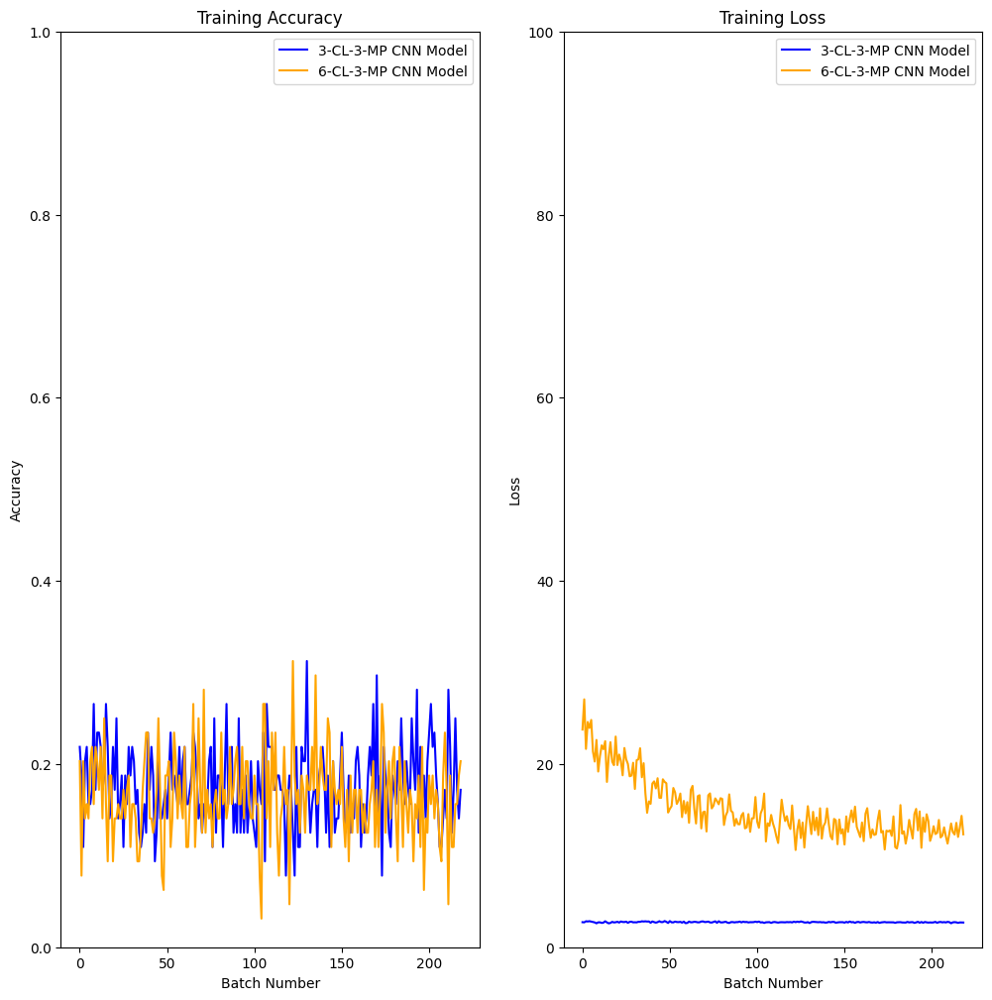

!!! Test Results for CNN Models with LR 0.0001 and 1 Training Epochs !!!
| CNN Model           |   Test Mean Accuracy |   Forest Class Accuracy |   Buildings Class Accuracy |   Glacier Class Accuracy |   Street Class Accuracy |   Mountain Class Accuracy |   Sea Class Accuracy |
|---------------------|----------------------|-------------------------|----------------------------|--------------------------|-------------------------|---------------------------|----------------------|
| 3-CL-3-MP CNN Model |             0.18     |               0.0400844 |                   0.169336 |                0.0506329 |                0.303393 |                  0.384762 |             0.127451 |
| 6-CL-3-MP CNN Model |             0.156333 |               0.128692  |                   0.16476  |                0.164557  |                0.141717 |                  0.169524 |             0.166667 |


In [46]:
'''
CNN MODEL ANALYSIS

This cell will analyze the results of the CNN models trained above.
'''

################
# LOAD RESULTS #
################

# Make sure files exist
if not os.path.isfile("results/ThreeLayerCnnResults.json"):
	print("Error: 'results/ThreeLayerCnnResults.json' file does not exist!")

if not os.path.isfile("results/SixLayerCnnResults.json"):
	print("Error: 'results/SixLayerCnnResults.json' file does not exist!")

# Get results from files
with open('results/ThreeLayerCnnResults.json') as json_file:
    ThreeLayerCnnResults = json.load(json_file)

with open('results/SixLayerCnnResults.json') as json_file:
    SixLayerCnnResults = json.load(json_file)

# Move all results back to numpy arrays
showcaseIndices = ThreeLayerCnnResults["randomIndices"]
ThreeLayerCnnResults["testAccuracies"] = np.array(ThreeLayerCnnResults["testAccuracies"])
ThreeLayerCnnResults["testPerClassAccuracy"] = np.array(ThreeLayerCnnResults["testPerClassAccuracy"])
ThreeLayerCnnResults["trainingAccuracies"] = np.array(ThreeLayerCnnResults["trainingAccuracies"])
ThreeLayerCnnResults["trainingLosses"] = np.array(ThreeLayerCnnResults["trainingLosses"])
SixLayerCnnResults["testAccuracies"] = np.array(SixLayerCnnResults["testAccuracies"])
SixLayerCnnResults["testPerClassAccuracy"] = np.array(SixLayerCnnResults["testPerClassAccuracy"])
SixLayerCnnResults["trainingAccuracies"] = np.array(SixLayerCnnResults["trainingAccuracies"])
SixLayerCnnResults["trainingLosses"] = np.array(SixLayerCnnResults["trainingLosses"])

for showcaseIndex in showcaseIndices:
	ThreeLayerCnnResults[f"showcaseclass{showcaseIndex}"] = np.array(ThreeLayerCnnResults[f"showcaseclass{showcaseIndex}"])
	ThreeLayerCnnResults[f"showcaseprediction{showcaseIndex}"] = np.array(ThreeLayerCnnResults[f"showcaseprediction{showcaseIndex}"])
	SixLayerCnnResults[f"showcaseprediction{showcaseIndex}"] = np.array(SixLayerCnnResults[f"showcaseprediction{showcaseIndex}"])

###################
# DISPLAY RESULTS #
###################

# Setup Table
CnnResults_Header = ["CNN Model", "Test Mean Accuracy", "Forest Class Accuracy", "Buildings Class Accuracy", "Glacier Class Accuracy", "Street Class Accuracy", "Mountain Class Accuracy", "Sea Class Accuracy"]
CnnResults_Table = [[],[]]
CnnResults_Table[0] = ThreeLayerCnnResults["modelName"], ThreeLayerCnnResults["testMeanAccuracy"], ThreeLayerCnnResults["testPerClassAccuracy"][0], ThreeLayerCnnResults["testPerClassAccuracy"][1], ThreeLayerCnnResults["testPerClassAccuracy"][2], ThreeLayerCnnResults["testPerClassAccuracy"][3], ThreeLayerCnnResults["testPerClassAccuracy"][4], ThreeLayerCnnResults["testPerClassAccuracy"][5]
CnnResults_Table[1] = SixLayerCnnResults["modelName"], SixLayerCnnResults["testMeanAccuracy"], SixLayerCnnResults["testPerClassAccuracy"][0], SixLayerCnnResults["testPerClassAccuracy"][1], SixLayerCnnResults["testPerClassAccuracy"][2], SixLayerCnnResults["testPerClassAccuracy"][3], SixLayerCnnResults["testPerClassAccuracy"][4], SixLayerCnnResults["testPerClassAccuracy"][5]

# Setup Plot
samplesToUse = 14034
numberEpochs = 1
batchSize = 64
trainingDataXList = list(range(1, samplesToUse + 1)) #14035
fig, ((trainAccuracyPlot, trainLossPlot)) = plt.subplots(1, 2, figsize=(12, 12))

# Split data into batches, take means, add to plots
ThreeLayerCnn_BatchedData_TrainAccuracies_Cleaned = np.array([x for x in np.concatenate(ThreeLayerCnnResults["trainingAccuracies"].tolist()) if x is not None])
ThreeLayerCnn_BatchedData_TrainAccuracies_Arrays = np.array_split(ThreeLayerCnn_BatchedData_TrainAccuracies_Cleaned, range(batchSize, len(ThreeLayerCnn_BatchedData_TrainAccuracies_Cleaned), batchSize))
ThreeLayerCnn_BatchedData_TrainAccuracies_Means = [np.mean(batch) for batch in ThreeLayerCnn_BatchedData_TrainAccuracies_Arrays]
ThreeLayerCnn_BatchedData_TrainLosses_Cleaned = np.array([x for x in np.concatenate(ThreeLayerCnnResults["trainingLosses"].tolist()) if x is not None])
ThreeLayerCnn_BatchedData_TrainLosses_Arrays = np.array_split(ThreeLayerCnn_BatchedData_TrainLosses_Cleaned, range(batchSize, len(ThreeLayerCnn_BatchedData_TrainLosses_Cleaned), batchSize))
ThreeLayerCnn_BatchedData_TrainLosses_Means = [np.mean(batch) for batch in ThreeLayerCnn_BatchedData_TrainLosses_Arrays]
SixLayerCnn_BatchedData_TrainAccuracies_Cleaned = np.array([x for x in np.concatenate(SixLayerCnnResults["trainingAccuracies"].tolist()) if x is not None])
SixLayerCnn_BatchedData_TrainAccuracies_Arrays = np.array_split(SixLayerCnn_BatchedData_TrainAccuracies_Cleaned, range(batchSize, len(SixLayerCnn_BatchedData_TrainAccuracies_Cleaned), batchSize))
SixLayerCnn_BatchedData_TrainAccuracies_Means = [np.mean(batch) for batch in SixLayerCnn_BatchedData_TrainAccuracies_Arrays]
SixLayerCnn_BatchedData_TrainLosses_Cleaned = np.array([x for x in np.concatenate(SixLayerCnnResults["trainingLosses"].tolist()) if x is not None])
SixLayerCnn_BatchedData_TrainLosses_Arrays = np.array_split(SixLayerCnn_BatchedData_TrainLosses_Cleaned, range(batchSize, len(SixLayerCnn_BatchedData_TrainLosses_Cleaned), batchSize))
SixLayerCnn_BatchedData_TrainLosses_Means = [np.mean(batch) for batch in SixLayerCnn_BatchedData_TrainLosses_Arrays]

trainAccuracyPlot.plot(range(len(ThreeLayerCnn_BatchedData_TrainAccuracies_Means)), ThreeLayerCnn_BatchedData_TrainAccuracies_Means, label=ThreeLayerCnnResults["modelName"], color='blue')
trainLossPlot.plot(range(len(ThreeLayerCnn_BatchedData_TrainLosses_Means)), ThreeLayerCnn_BatchedData_TrainLosses_Means, label=ThreeLayerCnnResults["modelName"], color='blue')
trainAccuracyPlot.plot(range(len(SixLayerCnn_BatchedData_TrainAccuracies_Means)), SixLayerCnn_BatchedData_TrainAccuracies_Means, label=SixLayerCnnResults["modelName"], color='orange')
trainLossPlot.plot(range(len(SixLayerCnn_BatchedData_TrainLosses_Means)), SixLayerCnn_BatchedData_TrainLosses_Means, label=SixLayerCnnResults["modelName"], color='orange')

# Set plot titles and labels
trainAccuracyPlot.set_title("Training Accuracy")
trainLossPlot.set_title("Training Loss")
trainAccuracyPlot.set_xlabel("Batch Number")
trainLossPlot.set_xlabel("Batch Number")
trainAccuracyPlot.set_ylabel("Accuracy")
trainLossPlot.set_ylabel("Loss")

# Set Axis limits
trainAccuracyPlot.set_ylim(0, 1)
trainLossPlot.set_ylim(0, 100)

trainAccuracyPlot.legend()
trainLossPlot.legend()

# Show plots
plt.show()

# Display the results table
print(f"!!! Test Results for CNN Models with LR 0.0001 and 1 Training Epochs !!!")
print(tabulate.tabulate(CnnResults_Table, headers=CnnResults_Header, tablefmt='github'))

Image: 2535
3-CL Prediction: [[0. 0. 1. 0. 0. 0.]] | 6-CL Prediction: [[0. 0. 1. 0. 0. 0.]] | Actual: [0. 0. 0. 1. 0. 0.]


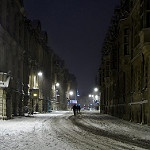

Image: 2666
3-CL Prediction: [[0. 0. 0. 0. 1. 0.]] | 6-CL Prediction: [[0. 1. 0. 0. 0. 0.]] | Actual: [0. 0. 0. 0. 1. 0.]


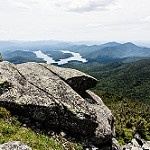

In [47]:
'''
CNN PREDICTION SHOWCASE

This cell will showcase a couple of examples of predictions made by the CNN models trained above.
'''

# Get the two showcase predictions from showcase folder
if not os.path.isdir("showcase"):
	print("Error: 'showcase' directory does not exist!")

for imageIndex in showcaseIndices:
	# Get 3-layer CNN prediction
	ThreeLayerShowcasePrediction = ThreeLayerCnnResults[f"showcaseprediction{imageIndex}"]

	# Get 6-layer CNN prediction
	SixLayerShowcasePrediction = SixLayerCnnResults[f"showcaseprediction{imageIndex}"]

	# Get class prediction
	ClassPrediction = ThreeLayerCnnResults[f"showcaseclass{imageIndex}"]

	# Display the predictions
	print(f"Image: {imageIndex}")
	print(f"3-CL Prediction: {ThreeLayerShowcasePrediction} | 6-CL Prediction: {SixLayerShowcasePrediction} | Actual: {ClassPrediction}")
	display(Image(filename=f"showcase/testimage{imageIndex}.jpg"))

